This notebook should not be executed.

It is a static view of all the exercises to make it easier to search for previous work using `Ctrl+F`.

# Exercise 1

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [ ]:
# Ex 1.1
p1 = np.array([[1, 2, 1]]).T  # 3x1
p2 = np.array([[4, 2, 2]]).T
p3 = np.array([[6, 4, -1]]).T
p4 = np.array([[5, 3, 0.5]]).T

q1 = p1[:2] / p1[2]
q2 = p2[:2] / p2[2]
q3 = p3[:2] / p3[2]
q4 = p4[:2] / p4[2]

# Transpose for better viewing
print(q1.T, q2.T, q3.T, q4.T)

[[1. 2.]] [[2. 1.]] [[-6. -4.]] [[10.  6.]]


In [ ]:
# Ex 1.2
p1 = np.array([[1, 10, -3, 1]]).T  # 4x1
p2 = np.array([[2, -4, 1.1, 2]]).T
p3 = np.array([[0, 0, -1, 10]]).T
p4 = np.array([[-15, 3, 6, 3]]).T

q1 = p1[:-1] / p1[-1]
q2 = p2[:-1] / p2[-1]
q3 = p3[:-1] / p3[-1]
q4 = p4[:-1] / p4[-1]

# Transpose for better viewing
print(q1.T, q2.T, q3.T, q4.T)

[[ 1. 10. -3.]] [[ 1.   -2.    0.55]] [[ 0.   0.  -0.1]] [[-5.  1.  2.]]


Ex 1.3

$$
    \begin{align*}
    x + 2y &= 3 \\
    0 &= x + 2y - 3 \\
    0 & = \begin{bmatrix}
    1 \\
    2 \\
    -3
    \end{bmatrix}^T
    \begin{bmatrix}
    x \\
    y \\
    1
    \end{bmatrix} \\
    \therefore l &= \begin{bmatrix}
    1 \\
    2 \\
    -3
    \end{bmatrix}
    \end{align*}
$$

In [ ]:
# Ex 1.4, 2D points on a line
lt = np.array([[1, 2, -3]])  # 1x3 for dot operation later

p1 = np.array([[3, 0, 1]]).T  # 3x1
p2 = np.array([[6, 0, 2]]).T
p3 = np.array([[1, 1, 2]]).T
p4 = np.array([[1, 1, 1]]).T
p5 = np.array([[110, -40, 10]]).T
p6 = np.array([[11, 4, 1]]).T

p = np.hstack((p1, p2, p3, p4, p5, p6))
p.shape

(3, 6)

In [ ]:
lt @ p
# Ans: p1, p2, p4, p5 lie on the line because the dot product is 0

array([[ 0,  0, -3,  0,  0, 16]])

In [ ]:
# Ex 1.5, intersection of 2 lines
l0 = np.array([[1, 1, -1]])  # 1x3 for cross operation
l1 = np.array([[-1, 1, -3]])
np.cross(l0, l1)  # cross product

array([[-2,  4,  2]])

Ex 1.6

$Ap = q$, where $p$ is the input point, and $q$ is the output point.

- $10$ scales both x and y coordinates by 10. 
- the x-coordinate is translated by $2$ units
-  y-coordinate translated by $3$ units.

In [ ]:
# Ex 1.7
def point_line_distance(line, p):
    """
    Calculate shortest distance d between line l and 2D homogenous point p.

    Args:
        line : 3x1 vector representing the homogeneous line
        p : 3x1 vector representing the homogeneous point

    Returns:
        d : shortest absolute distance between line and point
    """
    if p.shape != (3, 1):
        raise ValueError("p must be a 3x1 homogenous vector")
    if line.shape != (3, 1):
        raise ValueError("line must be a 3x1 homogenous vector")

    d = abs(line.T @ p) / (abs(p[2]) * np.sqrt(line[0] ** 2 + line[1] ** 2))
    return d

In [ ]:
rt2 = np.sqrt(2)
line = np.array([[1 / rt2, 1 / rt2, -1]]).T

p1 = np.array([[0, 0, 1]]).T
p2 = np.array([[rt2, rt2, 1]]).T
p3 = np.array([[rt2, rt2, 4]]).T

print(point_line_distance(line, p1))
print(point_line_distance(line, p2))
print(point_line_distance(line, p3))

[[1.]]
[[1.]]
[[0.5]]


In [ ]:
# Ex 1.8
line = np.array([[2, 2, -1]]).T

p1 = np.array([[0, 0, 1]]).T
p2 = np.array([[rt2, rt2, 1]]).T
p3 = np.array([[rt2, rt2, 4]]).T

print(point_line_distance(line, p1))
print(point_line_distance(line, p2))
print(point_line_distance(line, p3))

[[0.35355339]]
[[1.64644661]]
[[0.14644661]]


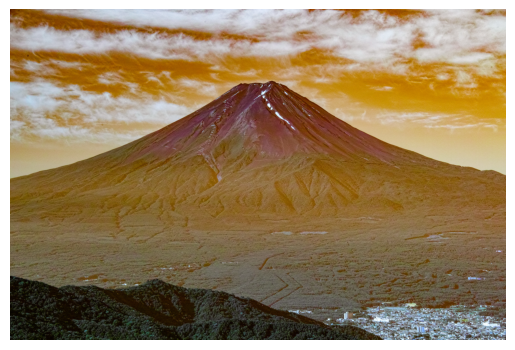

In [ ]:
# Ex 1.9
img = cv2.imread("media/Fuji.jpg")
plt.imshow(img)
plt.axis("off")
plt.show()

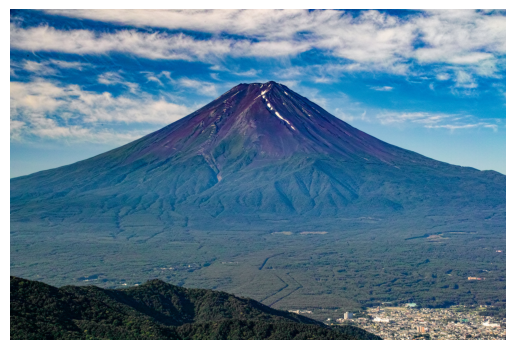

In [ ]:
# openCV reads BGR, plt uses RGB
plt.imshow(img[:, :, ::-1])  # flip channels
plt.axis("off")
plt.show()

In [ ]:
# Ex1.11
import itertools as it


def box3d(n=16):
    """Generate 3D points inside a cube with n-points along each edge"""
    points = []
    N = tuple(np.linspace(-1, 1, n))
    for i, j in [(-1, -1), (-1, 1), (1, 1), (0, 0)]:
        points.extend(set(it.permutations([(i,) * n, (j,) * n, N])))
    return np.hstack(points) / 2

In [ ]:
# Ex 1.12
def Pi(ph):
    """
    Converts coordinates from homogeneous to inhomogeneous.

    Args:
        ph (np.array): shape (n+1,m)

    Returns:
        p (np.array): shape (n,m)
    """
    p = ph[:-1] / ph[-1]  # divide by and remove last coordinate
    return p


def PiInv(p):
    """
    Converts coordinates from inhomogeneous to homogeneous.

    Args:
        p (np.array): shape (n,m)

    Returns:
        ph (np.array): shape (n+1,m)
    """
    ph = np.vstack((p, np.ones(p.shape[1])))
    return ph

In [ ]:
# Test Pi and PiInv
p1 = np.array([[3], [0], [1], [1]])  # 4x1
p2 = np.array([[3], [0], [1], [2]])
p3 = np.array([[3], [0], [1], [3]])
ph = np.hstack((p1, p2, p3))  # 4x3

p = Pi(ph)
print(p)  # 3x3

ph2 = PiInv(p)
print(ph2)  # 4x3

[[3.         1.5        1.        ]
 [0.         0.         0.        ]
 [1.         0.5        0.33333333]]
[[3.         1.5        1.        ]
 [0.         0.         0.        ]
 [1.         0.5        0.33333333]
 [1.         1.         1.        ]]


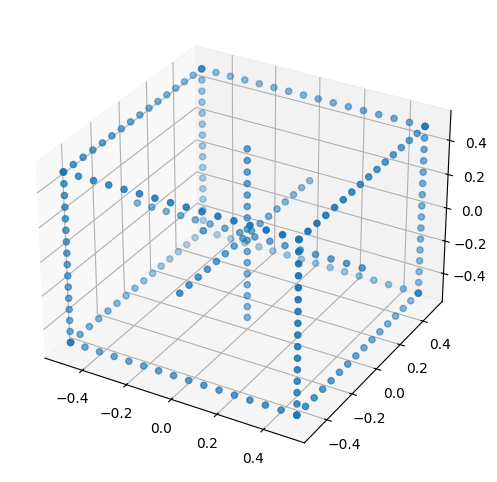

In [ ]:
box = box3d()  # 3x240 matrix

fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(projection="3d")
ax.scatter(box[0, :], box[1, :], box[2, :])
plt.show()

In [ ]:
# Ex 1.13
def project_points(K, R, t, Q):
    """
    Project 3D points in Q onto a 2D plane of a camera

    Args:
        K: intrinsic camera matrix, shape (3, 3)
        R: rotation matrix, shape (3, 3)
        t: translation matrix. shape (3, 1)
        Q: 3D points matrix, shape (3, n)

    Returns:
        P : 2D points matrix, shape (2, n)
    """
    Qh = PiInv(Q)  # 4 x n
    pose = np.hstack((R, t))  # 3 x 4
    Ph = K @ pose @ Qh  # 3 x n
    P = Pi(Ph)  # 2 x n
    return P

In [ ]:
Q = box3d()  # 3x240 matrix
K = np.eye(3)

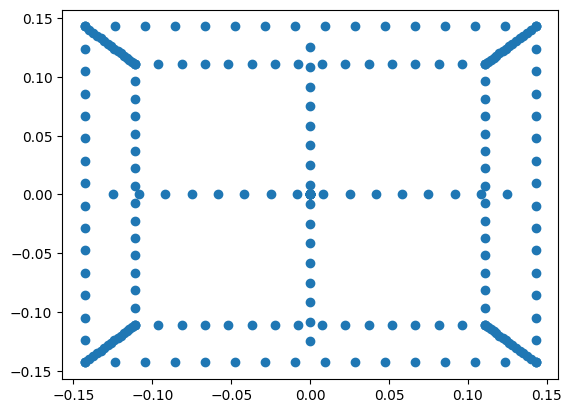

In [ ]:
R = np.eye(3)
t = np.array([[0, 0, 4]]).T
P = project_points(K, R, t, Q)
plt.scatter(P[0, :], P[1, :])
plt.show()

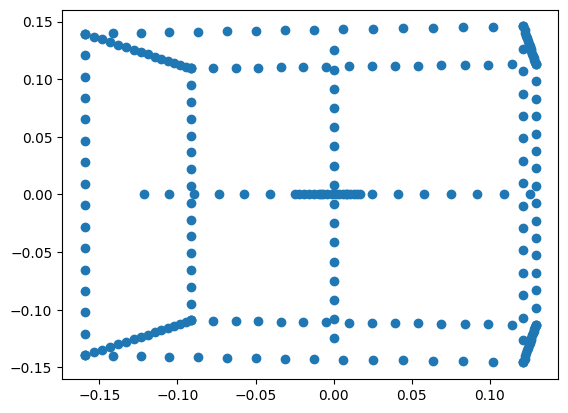

In [ ]:
# Ex 1.14
th = 30
R = np.array(
    [[np.cos(th), 0, np.sin(th)], [0, 1, 0], [-np.sin(th), 0, np.cos(th)]]
)
t = np.array([[0, 0, 4]]).T

P = project_points(K, R, t, Q)
plt.scatter(P[0, :], P[1, :])
plt.show()

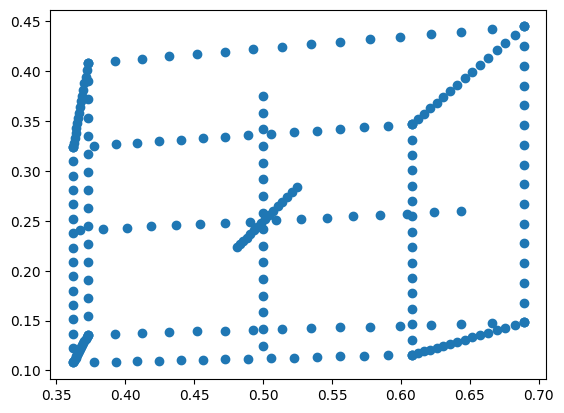

In [ ]:
# Ex 1.15
th = 60
R = np.array(
    [[np.cos(th), 0, np.sin(th)], [0, 1, 0], [-np.sin(th), 0, np.cos(th)]]
)
t = np.array([[2, 1, 4]]).T

P = project_points(K, R, t, Q)
plt.scatter(P[0, :], P[1, :])
plt.show()

# Exercise 2

Modern camera with complete square pixels $\rarr$ Skew parameters $\alpha=1, \beta=0$


In [ ]:
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
from cv02504.util_functions import (
    camera_intrinsic,
    project_points,
    box3d,
    Pi,
    PiInv,
)

matplotlib.use("TkAgg")

%matplotlib inline

In [ ]:
# Ex 2.1
f = 600
a = 1
b = 0
deltax = 400
deltay = 400
# resolution = 800x800, assuming principal point is the middle of the image

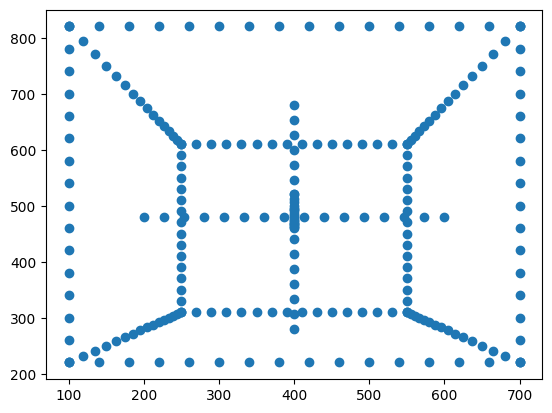

In [ ]:
K = camera_intrinsic(f, (deltax, deltay), a, b)
R = np.eye(3)
t = np.array([[0, 0.2, 1.5]]).T
Q = box3d()  # 3x240 matrix

P = project_points(K, R, t, Q)
plt.scatter(P[0, :], P[1, :])
plt.show()
# No, not all points are captured by the image sensor. The top part of
# the box is cut off as the coordinates are beyond 800.

In [ ]:
P1 = np.array([[-0.5, -0.5, -0.5]]).T

print(f"P1 is projected to {project_points(K, R, t, P1).T}")

P1 is projected to [[100. 220.]]


In [ ]:
# Ex 2.2
def distort(q, distCoeffs):
    """
    Apply distortion to 2D points on the image plane.

    Args:
        q : 2 x n, 2D points matrix
        distCoeffs : [k3,k5,k7,...] distortion coefficients
    """
    r = np.sqrt((q[0]) ** 2 + (q[1]) ** 2)
    correction = 1
    for i in range(len(distCoeffs)):
        exp = 2 * (i + 1)  # 2, 4, 6, ...
        correction += distCoeffs[i] * r**exp
    qd = q * correction
    return qd


def project_points(K, R, t, Q, distCoeffs=[]):
    """
    Project 3D points in Q onto a 2D plane of a camera with distortion.

    Args:
        K : 3 x 3, intrinsic camera matrix
        R : 3 x 3, rotation matrix
        t: 3 x 1, translation matrix
        Q: 3 x n, 3D points matrix
        distCoeffs : [k3,k5,k7,...] distortion coefficients

    Returns:
        P : 2 x n, 2D points matrix
    """
    Qh = PiInv(Q)  # 4 x n
    Rt = np.hstack((R, t))  # 3 x 4
    qh = Rt @ Qh  # 3 x n
    q = Pi(qh)  # 2 x n
    qd = distort(q, distCoeffs)  # 2 x n
    Ph = K @ PiInv(qd)  # 3 x n
    P = Pi(Ph)  # 2 x n
    return P

In [ ]:
# Breakdown of applying distortion to a single 3D point

# Project 3D point into a 2D point on the image plane
P1 = np.array([[-0.5, -0.5, -0.5]]).T
Rt = np.hstack((R, t))  # 3 x 4
ph = Rt @ PiInv(P1)  # 3 x 1
p = Pi(ph)  # 2 x 1
print(f"3D Point {P1.T} is projected onto {p.T} before distortion.")

# Apply distortion to the 2D point on image plane
distCoeffs = [-0.2, 0, 0]
pd = distort(p, distCoeffs)
print(f"2D point {p.T} is distorted to {pd.T} on image plane.")

# Project distorted 2D point into pixel coordinates
pdh = PiInv(pd)
qd = K @ pdh  # pixel coordinates
print(f"Distorted point {pd.T} is projected to {qd.T} after distortion.")

3D Point [[-0.5 -0.5 -0.5]] is projected onto [[-0.5 -0.3]] before distortion.
2D point [[-0.5 -0.3]] is distorted to [[-0.466  -0.2796]] on image plane.
Distorted point [[-0.466  -0.2796]] is projected to [[120.4  232.24   1.  ]] after distortion.


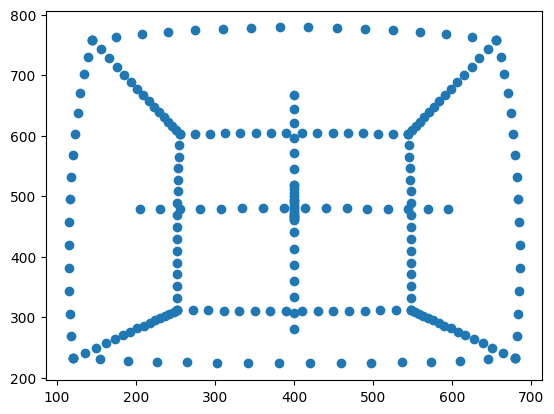

In [ ]:
# Applying distortion to many 3D points

K = camera_intrinsic(f, (deltax, deltay), a, b)
R = np.eye(3)
t = np.array([[0, 0.2, 1.5]]).T
Q = box3d()  # 3x240 matrix

P = project_points(K, R, t, Q, distCoeffs)
plt.scatter(P[0, :], P[1, :])
plt.show()
# Yes, all points are captured by the image sensor as all points
# lie within the 800x800 resolution.

In [ ]:
# Ex 2.3

# camera parameters for gopro
gopro_im = cv2.imread("media/gopro_robot.jpg")[:, :, ::-1]
gopro_im = gopro_im.astype(float) / 255
f = 0.455732 * gopro_im.shape[1]
a = 1
b = 0
gopro_distCoeffs = [-0.245031, 0.071524, -0.00994978]
gopro_K = camera_intrinsic(
    f, (gopro_im.shape[1] / 2, gopro_im.shape[0] / 2), a, b
)
print(gopro_K)

[[875.00544   0.      960.     ]
 [  0.      875.00544 540.     ]
 [  0.        0.        1.     ]]


In [ ]:
# Ex 2.4
def undistort_image(im, distCoeffs, K):
    """
    Returns an undistorted image using the camera matrix K and
    distortion coefficients distCoeffs.

    Args:
        im: input image
        distCoeffs: list of distortion coefficients
        K: intrinsic camera matrix

    Returns:
        im_undistorted: undistorted image
    """
    # meshgrid: placeholder for pixel coordinates
    x, y = np.meshgrid(np.arange(im.shape[1]), np.arange(im.shape[0]))
    p = np.stack((x, y, np.ones(x.shape))).reshape(3, -1)  # 3 x n, homogenous

    q = Pi(np.linalg.inv(K) @ p)  # 2 x n
    qd = distort(q, distCoeffs)  # 2 x n
    p_d = K @ PiInv(qd)  # 3 x n

    x_d = p_d[0].reshape(x.shape).astype(np.float32)
    y_d = p_d[1].reshape(y.shape).astype(np.float32)
    assert (p_d[2] == 1).all(), "You did a mistake somewhere"
    # use bilinear interpolation to remap the image
    im_undistorted = cv2.remap(im, x_d, y_d, cv2.INTER_LINEAR)
    return im_undistorted

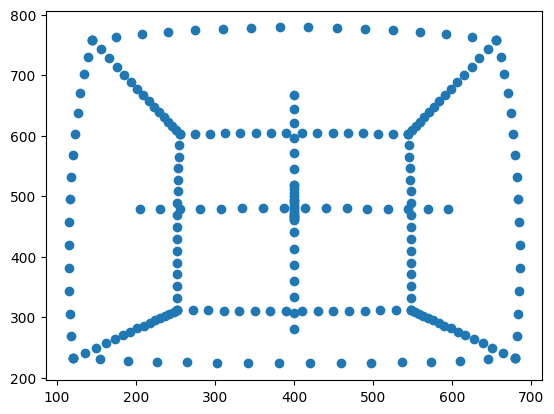

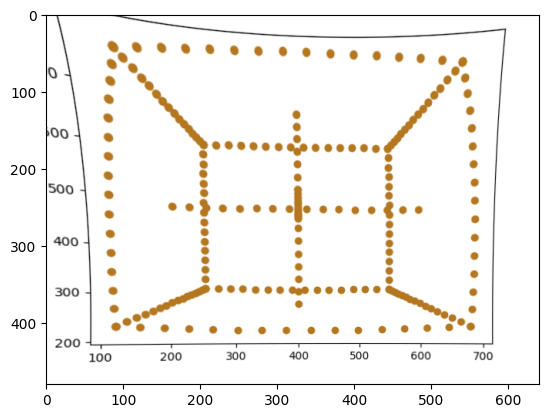

In [ ]:
P = project_points(K, R, t, Q, distCoeffs)
plt.scatter(P[0, :], P[1, :])
plt.savefig("media/distorted_box3d.png")
plt.show()

im = cv2.imread("media/distorted_box3d.png")
undistored_im = undistort_image(im, distCoeffs, K)
plt.imshow(undistored_im)
plt.show()

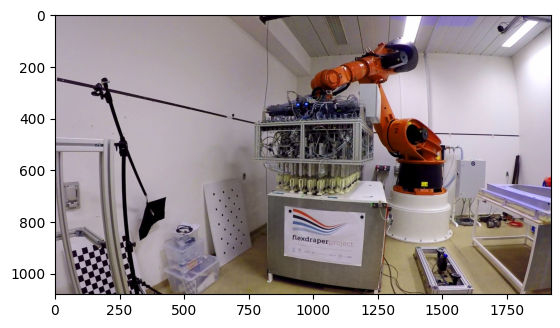

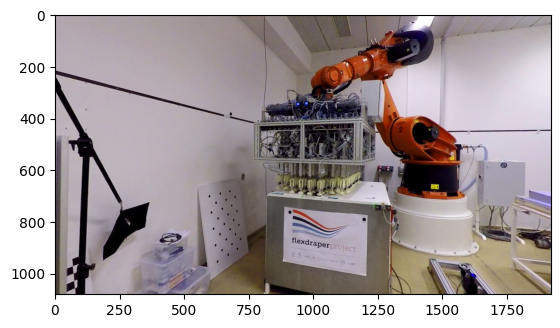

In [ ]:
plt.imshow(gopro_im)
plt.axis("off")
plt.show()

undistored_im = undistort_image(gopro_im, gopro_distCoeffs, gopro_K)
plt.imshow(undistored_im)
plt.axis("off")
plt.show()

## Homography

In [ ]:
# Ex 2.5
p2a = np.array([[1, 1]]).T
p2b = np.array([[0, 3]]).T
p2c = np.array([[2, 3]]).T
p2d = np.array([[2, 4]]).T
H = np.array([[-2, 0, 1], [1, -2, 0], [0, 0, 3]])
p2 = np.hstack((p2a, p2b, p2c, p2d))

# Apply homography to 2D points
qh = H @ PiInv(p2)  # 3 x n
q = Pi(qh)  # 2 x n
q

array([[-0.33333333,  0.33333333, -1.        , -1.        ],
       [-0.33333333, -2.        , -1.33333333, -2.        ]])

In [ ]:
# Ex 2.6
def hest(q1, q2):
    """
    Calculate the homography matrix from n sets of 2D points

    Args:
        q1 : 2 x n, 2D points in the first image
        q2 : 2 x n, 2D points in the second image
        H : 3 x 3, homography matrix

    Returns:
        H : 3 x 3, homography matrix
    """
    n = q1.shape[1]
    B = []
    for i in range(n):  # for each pair of points
        x1, y1 = q1[:, i]
        x2, y2 = q2[:, i]
        Bi = np.array(
            [
                [0, -x2, x2 * y1, 0, -y2, y2 * y1, 0, -1, y1],
                [x2, 0, -x2 * x1, y2, 0, -y2 * x1, 1, 0, -x1],
                [-x2 * y1, x2 * x1, 0, -y2 * y1, y2 * x1, 0, -y1, x1, 0],
            ]
        )
        B.append(Bi)
    B = np.array(B).reshape(-1, 9)
    U, S, Vt = np.linalg.svd(B)
    H = Vt[-1].reshape(3, 3)
    return H.T  # return the transpose of H


H = hest(q, p2)
with np.printoptions(precision=3, suppress=True):
    print(H)
# If the input points are flipped, inv(H) will be obtained.

[[ 0.459 -0.    -0.229]
 [-0.229  0.459  0.   ]
 [ 0.    -0.    -0.688]]


In [ ]:
# H obtained in 2.6 should be equivalent to 2.5 (multiplied by scalar)
H = np.array([[-2, 0, 1], [1, -2, 0], [0, 0, 3]])
norm = np.linalg.norm(H, "fro")
H / norm

array([[-0.45883147,  0.        ,  0.22941573],
       [ 0.22941573, -0.45883147,  0.        ],
       [ 0.        ,  0.        ,  0.6882472 ]])

In [ ]:
# Ex 2.7
def normalize2d(q):
    """
    Normalize 2D points to have mean 0 and sd 1.

    Args:
        q : 2 x n, 2D points
        qn : 2 x n, normalized 2D points

    Returns:
        qn : 2 x n, normalized 2D points
        T : 3 x 3, transformation matrix
    """
    if q.shape[0] != 2:
        raise ValueError("q must have 2 rows")
    if q.shape[1] < 2:
        raise ValueError("At least 2 points are required to normalize")

    mu = np.mean(q, axis=1).reshape(-1, 1)
    mu_x = mu[0].item()
    mu_y = mu[1].item()
    std = np.std(q, axis=1).reshape(-1, 1)
    std_x = std[0].item()
    std_y = std[1].item()
    Tinv = np.array([[std_x, 0, mu_x], [0, std_y, mu_y], [0, 0, 1]])
    T = np.linalg.inv(Tinv)
    qn = T @ PiInv(q)
    qn = Pi(qn)
    return qn, T


normalize2d(p2)

(array([[-0.30151134, -1.50755672,  0.90453403,  0.90453403],
        [-1.60591014,  0.22941573,  0.22941573,  1.14707867]]),
 array([[ 1.20604538,  0.        , -1.50755672],
        [ 0.        ,  0.91766294, -2.52357307],
        [ 0.        ,  0.        ,  1.        ]]))

In [ ]:
# Ex 2.8
# Include normalization in the homography estimation
def hest(q1, q2, normalize=False):
    """
    Calculate the homography matrix from n sets of 2D points

    Args:
        q1 : 2 x n, 2D points in the first image
        q2 : 2 x n, 2D points in the second image
        normalize : bool, whether to normalize the points

    Returns:
        H : 3 x 3, homography matrix
    """
    if q1.shape[1] != q2.shape[1]:
        raise ValueError("Number of points in q1 and q2 must be equal")
    if q1.shape[1] < 4:
        raise ValueError(
            "At least 4 points are required to estimate a homography"
        )
    if q1.shape[0] != 2 or q2.shape[0] != 2:
        raise ValueError("q1 and q2 must have 2 rows")

    if normalize:
        q1, T1 = normalize2d(q1)
        q2, T2 = normalize2d(q2)

    n = q1.shape[1]
    B = []
    for i in range(n):
        x1, y1 = q1[:, i]
        x2, y2 = q2[:, i]
        Bi = np.array(
            [
                [0, -x2, x2 * y1, 0, -y2, y2 * y1, 0, -1, y1],
                [x2, 0, -x2 * x1, y2, 0, -y2 * x1, 1, 0, -x1],
                [-x2 * y1, x2 * x1, 0, -y2 * y1, y2 * x1, 0, -y1, x1, 0],
            ]
        )
        B.append(Bi)
    # with np.printoptions(precision=3, suppress=True):
    #     print("B:", B)
    B = np.array(B).reshape(-1, 9)
    U, S, Vt = np.linalg.svd(B)
    H = Vt[-1].reshape(3, 3)
    H = H.T
    if normalize:
        H = np.linalg.inv(T1) @ H @ T2
    return H


H = hest(q, p2, normalize=True)
with np.printoptions(precision=3, suppress=True):
    print("H: \n", H)

H: 
 [[ 0.367  0.    -0.184]
 [-0.184  0.367 -0.   ]
 [-0.    -0.    -0.551]]


In [ ]:
# Ex 2.9
# generate 100 random 2D points and random H. use hest to estimate H
q2 = np.random.randn(2, 100)
q2h = np.vstack((q2, np.ones((1, 100))))
H_true = np.random.randn(3, 3)
q1h = H_true @ q2h
q1 = Pi(q1h)

H_est = hest(q1, q2)
print("True Homography: \n", H_true / np.linalg.norm(H_true, "fro"))
print("Estimated Homography: \n", H_est)
# Correct if the 2 homographis are equivalent

True Homography: 
 [[-0.48294889 -0.09557903 -0.39828446]
 [ 0.06198676  0.20492977  0.5673601 ]
 [ 0.21722239  0.25600271 -0.34428986]]
Estimated Homography: 
 [[-0.48294889 -0.09557903 -0.39828446]
 [ 0.06198676  0.20492977  0.5673601 ]
 [ 0.21722239  0.25600271 -0.34428986]]


In [ ]:
# Ex 2.10
%matplotlib qt


def hest_from_image(im1, im2, n):
    """
    Estimate homography from n pairs of points in two images.

    Args:
        im1 : np.array, first image
        im2 : np.array, second image
        n : int, number of pairs of points

    Returns:
        H : 3 x 3, homography matrix
    """
    plt.imshow(im1)
    plt.title("Click on points in an ascending order")
    p1 = plt.ginput(n)
    plt.close()
    plt.imshow(im2)
    plt.title("Click on points in an ascending order")
    p2 = plt.ginput(n)
    plt.close()
    H = hest(np.array(p1).T, np.array(p2).T, True)
    return H


im1 = cv2.imread("media/imageA.jpg")[:, :, ::-1]
im2 = cv2.imread("media/imageB.jpg")[:, :, ::-1]
H = hest_from_image(im1, im2, 4)
with np.printoptions(precision=3, suppress=True):
    print(f"H:\n{H}")

: 

In [ ]:
def htrans(H, im1, im2):
    """
    Apply a homography to a selected point.

    im1 : np.array, first image
    im2 : np.array, second image
    H : 3 x 3, homography matrix
    """
    # Select a point in the second image
    plt.imshow(im2)
    plt.title("Select a point in the on the object")
    p2 = plt.ginput(1)
    p2 = np.array(p2).T
    plt.close()

    q2 = PiInv(p2)
    q1 = H @ q2
    p1 = Pi(q1)

    # Plot the points
    fig = plt.figure()
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    ax1.imshow(im1)
    ax1.plot(p1[0], p1[1], "rx")
    ax2.imshow(im2)
    ax2.plot(p2[0], p2[1], "rx")
    plt.show()


htrans(H, im1, im2)

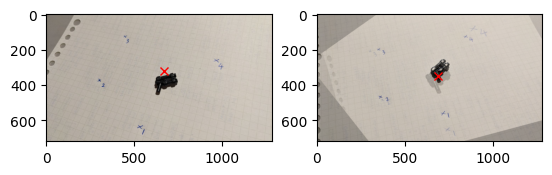

In [ ]:
# Ex 2.11
%matplotlib inline


def warpImage(im, H):
    """
    Warp an image using a homography matrix.
    """
    imWarp = cv2.warpPerspective(im, H, (im.shape[1], im.shape[0]))
    return imWarp


warped = warpImage(im1, H)

# Overlay images
plt.imshow(warped, alpha=0.5)
plt.imshow(im2, alpha=0.5)
plt.axis("off")
plt.show()

# Exercise 3

In [ ]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from cv02504.util_functions import camera_intrinsic, project_points, Pi, PiInv

matplotlib.use("TkAgg")

%matplotlib inline

In [ ]:
K = camera_intrinsic(1000, (300, 200))
K

array([[1000,    0,  300],
       [   0, 1000,  200],
       [   0,    0,    1]])

In [ ]:
def R(theta_x, theta_y, theta_z):
    """
    Angles in radians.

    Returns : Rz @ Ry @ Rx
    """
    Rx = np.array(
        [
            [1, 0, 0],
            [0, np.cos(theta_x), -np.sin(theta_x)],
            [0, np.sin(theta_x), np.cos(theta_x)],
        ]
    )
    Ry = np.array(
        [
            [np.cos(theta_y), 0, np.sin(theta_y)],
            [0, 1, 0],
            [-np.sin(theta_y), 0, np.cos(theta_y)],
        ]
    )
    Rz = np.array(
        [
            [np.cos(theta_z), -np.sin(theta_z), 0],
            [np.sin(theta_z), np.cos(theta_z), 0],
            [0, 0, 1],
        ]
    )
    return Rz @ Ry @ Rx

In [ ]:
R1 = np.eye(3)
t1 = np.array([[0, 0, 0]]).T
R2 = R(0.7, -0.5, 0.8)
t2 = np.array([[0.2, 2, 1]]).T
R2

(3, 1)


array([[ 0.61141766, -0.76384514,  0.20666167],
       [ 0.6295392 ,  0.31131209, -0.71187442],
       [ 0.47942554,  0.56535421,  0.67121217]])

In [ ]:
# Alternative way to construct rotation matrix
from scipy.spatial.transform import Rotation

R2 = Rotation.from_euler("xyz", [0.7, -0.5, 0.8]).as_matrix()
R2

array([[ 0.61141766, -0.76384514,  0.20666167],
       [ 0.6295392 ,  0.31131209, -0.71187442],
       [ 0.47942554,  0.56535421,  0.67121217]])

In [ ]:
# Ex 3.1
# Find projections in the 2 cameras

Q = np.array([[1, 0.5, 4, 1]]).T
Q = Pi(Q)  # make Q 3x1 for project_points()

q1 = project_points(K, R1, t1, Q)  # project Q to image plane of camera 1
q2 = project_points(K, R2, t2, Q)  # project Q to image plane of camera 2
print(f"q1: {q1.T}")  # projected point in pixels in camera 1
print(f"q2: {q2.T}")  # projected point in pixels camera 2

q1: [[550. 325.]]
q2: [[582.47256835 185.98985776]]


In [ ]:
# Ex 3.2
# Cross product operator


def CrossOp(r):
    """
    Cross product operator of r

    Args:
        r : 3x1 vector

    Returns:
        R : 3x3 matrix
    """
    if r.shape == (3, 1):
        r = r.flatten()
    if r.shape != (3,):
        raise ValueError("r must be a 3x1 vector")

    return np.array([[0, -r[2], r[1]], [r[2], 0, -r[0]], [-r[1], r[0], 0]])


# Check if the above function works
# p1 = np.array([1,2,3]).T
# p2 = np.array([4,5,6]).T
# print(np.cross(p1, p2))
# print(CrossOp(p1) @ p2)

In [ ]:
# Ex 3.3
# Compute fundamental matrix


def essential_matrix(R, t):
    """Returns the essential matrix."""
    return CrossOp(t) @ R


def fundamental_matrix(K1, R1, t1, K2, R2, t2):
    """
    Returns the fundamental matrix, assuming camera 1 coordinates are
    on top of global coordinates.
    """
    if R1.shape != (3, 3) or R2.shape != (3, 3):
        raise ValueError("R1 and R2 must be 3x3 matrices")
    if t1.shape == (3,) or t2.shape == (3,):
        t1 = t1.reshape(-1, 1)
        t2 = t2.reshape(-1, 1)
    if t1.shape != (3, 1) or t2.shape != (3, 1):
        raise ValueError("t1 and t2 must be 3x1 matrices")
    if K1.shape != (3, 3) or K2.shape != (3, 3):
        raise ValueError("K1 and K2 must be 3x3 matrices")

    # When the {camera1} and {camera2} are not aligned with {global}
    R_tilde = R2 @ R1.T
    t_tilde = t2 - R_tilde @ t1

    E = essential_matrix(R_tilde, t_tilde)
    F = np.linalg.inv(K2).T @ E @ np.linalg.inv(K1)
    return F


# {1} lies on the same axis as the global coordinates as R1 = eye(3)
# Thus, use R1 to compute essential matrix
F = fundamental_matrix(K, R1, t1, K, R2, t2)
print(f"F: {F}")

F: [[ 3.29311881e-07  8.19396327e-07  1.79162592e-03]
 [ 5.15532551e-07 -8.76915984e-07  9.31426656e-05]
 [-1.29882755e-03  1.51951700e-03 -1.10072682e+00]]


In [ ]:
# Ex 3.4
# Equation of the epipolar line in camera 2

l2 = F @ PiInv(q1)  # epipolar line of q1 in camera 2
l2 / l2[2] * -5.285  # to match the answer

array([[ 8.95627993e-03],
       [ 3.66754562e-04],
       [-5.28500000e+00]])

In [ ]:
# Ex 3.5
# Check if q2 is located on the epipolar line l2

print(l2.shape)
print(q1.shape)

PiInv(q2).T @ l2  # should be 0
# Since the dot product is close to 0, the point is on the line.

(3, 1)
(2, 1)


array([[4.4408921e-16]])

In [ ]:
# Ex 3.6
# Both camera have local coordinate systems, different from world coordinates.
# Refer to ans for full derivation

# Ex 3.7
# Refer to the ans for full derivation

dict_keys(['im1', 'R1', 't1', 'im2', 'R2', 't2', 'K'])
(3,) (3,)
F: [[-1.50228281e-08 -3.45997421e-07 -3.47606501e-05]
 [-2.06767970e-07  3.96284278e-08 -9.29558240e-04]
 [ 2.61581163e-05  1.12168578e-03  1.17449076e-02]]


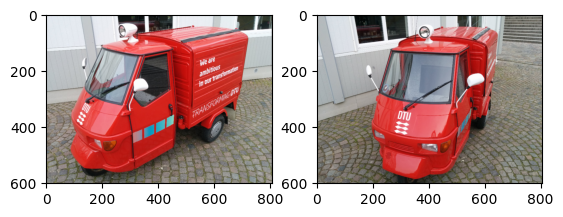

In [ ]:
# Ex 3.8
# Compute fundamental matrix between 2 images

data = np.load("media/TwoImageDataCar.npy", allow_pickle=True).item()
print(data.keys())
im1 = data["im1"]
im2 = data["im2"]
K = data["K"]
R1 = data["R1"]
t1 = data["t1"]
R2 = data["R2"]
t2 = data["t2"]

print(t1.shape, t2.shape)
F = fundamental_matrix(K, R1, t1, K, R2, t2)
print(f"F: {F}")

plt.subplot(1, 2, 1)
plt.imshow(im1)
plt.subplot(1, 2, 2)
plt.imshow(im2)
plt.show()

In [ ]:
# Ex 3.9
# Click on a point, and draw the epipolar line on the other image


def DrawLine(l, shape):
    """
    Draws a line on an the 2nd plot.

    Args:
        l (np.ndarray): epipolar line in homogenous coordinates, shape (3,1)
        shape (tuple[int,int]) : shape of the image
    """
    # Checks where the line intersects the four sides of the image
    # and finds the two intersections that are within the frame

    def in_frame(l_im):
        """Returns the intersection point of the line with the image frame."""
        q = np.cross(l.flatten(), l_im)  # intersection point
        q = q[:2] / q[2]  # convert to inhomogeneous
        if all(q >= 0) and all(q + 1 <= shape[1::-1]):
            return q

    # 4 edge lines of the image
    lines = [
        [1, 0, 0],  # x = 0
        [0, 1, 0],  # y = 0
        [1, 0, 1 - shape[1]],  # x = shape[1]
        [0, 1, 1 - shape[0]],
    ]  # y = shape[0]

    P = [in_frame(l_im) for l_im in lines if in_frame(l_im) is not None]

    if len(P) == 0:
        print("Line is completely outside image")
    plt.plot(*np.array(P).T)

In [ ]:
figure = plt.figure()
ax1 = plt.subplot(1, 2, 1)
ax1.imshow(im1)
ax1.set_title("Click on a point")
ax2 = plt.subplot(1, 2, 2)
ax2.imshow(im2)
ax2.set_title("Epipolar line will be drawn here")

# Click on a point in the first image
q = plt.ginput(1)
q = q[0]
ax1.plot(q[0], q[1], "bx")

l = F @ PiInv(np.array([q]).T)
DrawLine(l, im2.shape)

In [ ]:
# Ex 3.10
# Flip images
figure = plt.figure()
ax1 = plt.subplot(1, 2, 1)
ax1.imshow(im2)
ax1.set_title("Click on a point")
ax2 = plt.subplot(1, 2, 2)
ax2.imshow(im1)
ax2.set_title("Epipolar line will be drawn here")

# Click on a point in the first image
q = plt.ginput(1)
q = q[0]
ax1.plot(q[0], q[1], "bx")

l = F @ PiInv(np.array([q]).T)
DrawLine(l, im1.shape)

In [ ]:
# Ex 3.11
# Triangulation
def triangulate(q_list, P_list):
    """
    Triangulate a single 3D point seen by n cameras.

    Args:
        q_list : nx2x1 list of 2x1 pixel points
        P_list : nx3x4, list of 3x4 camera projection matrices

    Returns:
        Q : 3x1 vector, 3D point
    """
    B = []  # 2n x 4 matrix
    for i in range(len(P_list)):
        qi = q_list[i]
        P_i = P_list[i]
        B.append(P_i[2] * qi[0] - P_i[0])
        B.append(P_i[2] * qi[1] - P_i[1])
    B = np.array(B)
    U, S, Vt = np.linalg.svd(B)
    # TODO: why is the 3D point the last column of the matrix V
    # returned by the SVD, normalized to have a last coordinate of 1.
    Q = Vt[-1, :-1] / Vt[-1, -1]
    return Q


# Camera parameters
K = camera_intrinsic(1000, (300, 200))
R1 = np.eye(3)
t1 = np.array([[2, 3, 4]]).T
R2 = R(0.7, -0.5, 0.8)
t2 = np.array([[0.2, 2, 1]]).T

# Arbitrary 3D point
Q = np.array([[1, 0.5, 4]]).T

# Triangulate procedure
q1 = project_points(K, R1, t1, Q)  # project Q to image plane of camera 1
q2 = project_points(K, R2, t2, Q)  # project Q to image plane of camera 2
P1 = K @ np.hstack((R1, t1))
P2 = K @ np.hstack((R2, t2))
Q = triangulate([q1, q2], [P1, P2])
Q

array([1. , 0.5, 4. ])

# Exercise 4

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from cv02504.util_functions import (
    camera_intrinsic,
    projection_matrix,
    project_points,
    normalize2d,
    PiInv,
    Pi,
    CrossOp,
    hest,
)

np.set_printoptions(precision=4)

In [ ]:
# Ex 4.1
# Find projection matrix and projections
f = 1000
resolution = (1920, 1080)
principal_point = (resolution[0] / 2, resolution[1] / 2)
K = camera_intrinsic(f, principal_point)
K

array([[1000.,    0.,  960.],
       [   0., 1000.,  540.],
       [   0.,    0.,    1.]])

In [ ]:
R = np.array(
    [
        [np.sqrt(0.5), -np.sqrt(0.5), 0],
        [np.sqrt(0.5), np.sqrt(0.5), 0],
        [0, 0, 1],
    ]
)
t = np.array([[0, 0, 10]]).T
P = projection_matrix(K, R, t)
print(P)

[[ 7.0711e+02 -7.0711e+02  9.6000e+02  9.6000e+03]
 [ 7.0711e+02  7.0711e+02  5.4000e+02  5.4000e+03]
 [ 0.0000e+00  0.0000e+00  1.0000e+00  1.0000e+01]]


In [ ]:
Q = np.array(
    [(x, y, z) for x in [0, 1] for y in [0, 1] for z in [0, 1]]
).T  # 3 x n
Q

array([[0, 0, 0, 0, 1, 1, 1, 1],
       [0, 0, 1, 1, 0, 0, 1, 1],
       [0, 1, 0, 1, 0, 1, 0, 1]])

In [ ]:
q = project_points(K, R, t, Q)
with np.printoptions(precision=3):
    print(q)

[[ 960.     960.     889.289  895.718 1030.711 1024.282  960.     960.   ]
 [ 540.     540.     610.711  604.282  610.711  604.282  681.421  668.565]]


In [ ]:
# Ex 4.2
# Estimate projection matrix
def pest(Q, q, normalize=False):
    """
    Estimate projection matrix using direct linear transformation.

    Args:
        Q : 3 x n array of 3D points
        q : 2 x n array of 2D points
        normalize : bool, whether to normalize the 2D points

    Returns:
        P : 3 x 4 projection matrix
    """
    if Q.shape[0] != 3:
        raise ValueError("Q must be a 3 x n array of 3D points")
    if q.shape[0] != 2:
        raise ValueError("q must be a 2 x n array of 2D points")

    if normalize:
        q, T = normalize2d(q)

    q = PiInv(q)  # 3 x n
    Q = PiInv(Q)  # 4 x n
    n = Q.shape[1]  # number of points
    B = []
    for i in range(n):
        Qi = Q[:, i]
        qi = q[:, i]
        # Xi, Yi, Zi = Qi
        # xi, yi, _ = qi
        # Bi = np.array([[0, -Xi, Xi*yi, 0, -Yi, Yi*yi, 0, -Zi, Zi*yi, 0, -1, yi],
        #                [Xi, 0, -Xi*xi, Yi, 0, -Yi*xi, Zi, 0, -Zi*xi, 1, 0, -xi],
        #                [-Xi*yi, Xi*xi, 0, -Yi*yi, Yi*xi, 0, -Zi*yi, Zi*xi, 0, -yi, xi, 0]])
        Bi = np.kron(Qi, CrossOp(qi))
        B.append(Bi)
    B = np.array(B).reshape(3 * n, 12)
    U, S, Vt = np.linalg.svd(B)
    P = Vt[-1].reshape(4, 3)
    P = P.T
    if normalize:
        P = np.linalg.inv(T) @ P
    return P


P_est = pest(Q, q)
print("Estimated P:\n", P_est)

Estimated P:
 [[-6.3364e-02  6.3364e-02 -8.6026e-02 -8.6026e-01]
 [-6.3364e-02 -6.3364e-02 -4.8389e-02 -4.8389e-01]
 [-1.2041e-16 -1.5297e-16 -8.9610e-05 -8.9610e-04]]


In [ ]:
def compute_rmse(q_true, q_est):
    """
    Returns the root mean square error between the true and estimated 2D points.

    Args:
        q_true: 2 x n array of true 2D points
        q_est: 2 x n array of estimated 2D points
    """
    if q_true.shape[0] != 2 or q_est.shape[0] != 2:
        raise ValueError("q_true and q_est must be 2 in the first dimension")
    if q_true.shape[1] != q_est.shape[1]:
        raise ValueError("q_true and q_est must have the same number of points")
    se = (q_est - q_true) ** 2
    return np.sqrt(np.mean((se)))


# Compute reprojection error
q_est = P_est @ PiInv(Q)
rmse = compute_rmse(q, Pi(q_est))
print("RMSE: ", rmse)  # should be close to 0

RMSE:  9.951005074215462e-11


In [ ]:
# Normalize points before estimating P
P_est = pest(Q, q, normalize=True)
q_est = P_est @ PiInv(Q)

rmse = compute_rmse(q, Pi(q_est))
print("RMSE: ", rmse)
# Normalizing the points should improve reprojection error slightly.

RMSE:  1.1718571004216928e-13


In [ ]:
# Ex 4.3
# Simulate 3D points on a checkerboard
def checkerboard_points(n, m):
    """
    Generate 3D points of a checkerboard with n x m squares.

    Returns:
        points : 3 x (n*m) array of 3D points
    """
    points = np.array(
        [
            (i - (n - 1) / 2, j - (m - 1) / 2, 0)
            for i in range(n)
            for j in range(m)
        ]
    ).T
    return points


Qcb = checkerboard_points(5, 4)
print(Qcb.shape)
print(Qcb)

(3, 20)
[[-2.  -2.  -2.  -2.  -1.  -1.  -1.  -1.   0.   0.   0.   0.   1.   1.
   1.   1.   2.   2.   2.   2. ]
 [-1.5 -0.5  0.5  1.5 -1.5 -0.5  0.5  1.5 -1.5 -0.5  0.5  1.5 -1.5 -0.5
   0.5  1.5 -1.5 -0.5  0.5  1.5]
 [ 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0. ]]


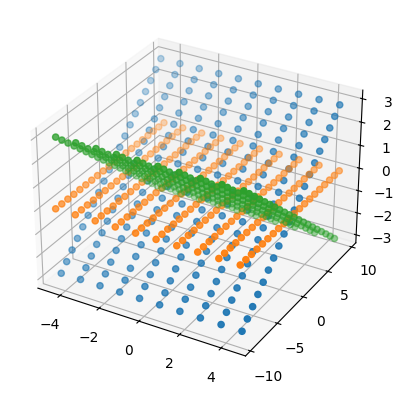

In [ ]:
# Ex 4.4
# Apply rotation and translation to the simulated 3D points
from scipy.spatial.transform import Rotation

Ra = Rotation.from_euler("xyz", [np.pi / 10, 0, 0]).as_matrix()
Rb = Rotation.from_euler("xyz", [0, 0, 0]).as_matrix()
Rc = Rotation.from_euler("xyz", [-np.pi / 10, 0, 0]).as_matrix()

# Simulated 3D points for different views
Q_omega = checkerboard_points(10, 20)
Qa = Ra @ Q_omega  # 3 x n
Qb = Rb @ Q_omega
Qc = Rc @ Q_omega

qa = project_points(K, Ra, t, Qa)
qb = project_points(K, Rb, t, Qb)
qc = project_points(K, Rc, t, Qc)

# Visualize the 3 views
fig = plt.figure()
ax = plt.axes(projection="3d")
ax.scatter(Qa[0, :], Qa[1, :], Qa[2, :])
ax.scatter(Qb[0, :], Qb[1, :], Qb[2, :])
ax.scatter(Qc[0, :], Qc[1, :], Qc[2, :])
plt.show()

In [ ]:
# Ex 4.5
def estimate_homographies(Q_omega, qs):
    """
    Estimate homographies for each view.

    Args:
        Q_omega : 3 x (nxm) array of untransformed 3D points
        qs : list of arrays corresponding to each view, e.g. [qa, qb, qc]

    Returns:
        Hs : list of 3x3 homographies for each view
    """
    Hs = []
    Q = Q_omega[:2]  # remove 3rd row of zeros
    for q in qs:
        H = hest(q, Q)  # TODO: why hest(q, Q) instead of hest(Q, q)?
        Hs.append(H)
    return Hs


qs = [qa, qb, qc]
Hs = estimate_homographies(Q_omega, qs)

In [ ]:
Q_omega_h = PiInv(Q_omega[:2])  # Q_omega without z, homogenous
qa_est = Hs[0] @ Q_omega_h
qb_est = Hs[1] @ Q_omega_h
qc_est = Hs[2] @ Q_omega_h

qa_est = qa_est[:2] / qa_est[-1]
qb_est = qb_est[:2] / qb_est[-1]
qc_est = qc_est[:2] / qc_est[-1]

# Compute reprojection error
print("RMSE: ", compute_rmse(qa, qa_est))
print("RMSE: ", compute_rmse(qb, qb_est))
print("RMSE: ", compute_rmse(qc, qc_est))

RMSE:  3.7305668909751715e-10
RMSE:  3.4180576360102834e-10
RMSE:  4.969542995045003e-10


In [ ]:
# Ex 4.6
# Estimate b vector
def form_vi(H, a, b):
    """
    Form 1x6 vector vi using H and indices alpha, beta.

    Args:
        H : 3x3 homography
        a, b : indices alpha, beta

    Returns:
        vi : 1x6 vector
    """
    # Use zero-indexing here. Notes uses 1-indexing.
    a = a - 1
    b = b - 1
    vi = np.array(
        [
            H[0, a] * H[0, b],
            H[0, a] * H[1, b] + H[1, a] * H[0, b],
            H[1, a] * H[1, b],
            H[2, a] * H[0, b] + H[0, a] * H[2, b],
            H[2, a] * H[1, b] + H[1, a] * H[2, b],
            H[2, a] * H[2, b],
        ]
    )
    vi = vi.reshape(1, 6)
    return vi


def estimate_b(Hs):
    """
    Estimate b matrix used Zhang's method for camera calibration.

    Args:
        Hs : list of 3x3 homographies for each view

    Returns:
        b : 6x1 vector
    """
    V = []  # coefficient matrix
    # Create constraints in matrix form
    for H in Hs:
        vi_11 = form_vi(H, 1, 1)
        vi_12 = form_vi(H, 1, 2)
        vi_22 = form_vi(H, 2, 2)
        v = np.vstack((vi_12, vi_11 - vi_22))  # 2 x 6
        V.append(v)
    # V = np.array(V) creates the wrong array shape
    V = np.vstack(V)  # 2n x 6
    U, S, bt = np.linalg.svd(V.T @ V)
    b = bt[-1].reshape(6, 1)
    return b


b = estimate_b(Hs)

In [ ]:
def b_from_B(B):
    """
    Returns the 6x1 vector b from the 3x3 matrix B.

    b = [B11 B12 B22 B13 B23 B33].T
    """
    if B.shape != (3, 3):
        raise ValueError("B must be a 3x3 matrix")

    b = np.array((B[0, 0], B[0, 1], B[1, 1], B[0, 2], B[1, 2], B[2, 2]))
    b = b.reshape(6, 1)
    return b


B_true = np.linalg.inv(K.T) @ np.linalg.inv(K)
b_true = b_from_B(B_true)

print("b_est:\n", b / np.linalg.norm(b))
print("b_true:\n", b_true / np.linalg.norm(b_true))

b_est:
 [[-4.5183e-07]
 [-4.1408e-19]
 [-4.5183e-07]
 [ 4.3376e-04]
 [ 2.4399e-04]
 [-1.0000e+00]]
b_true:
 [[ 4.5183e-07]
 [ 0.0000e+00]
 [ 4.5183e-07]
 [-4.3376e-04]
 [-2.4399e-04]
 [ 1.0000e+00]]


In [ ]:
# Check: v11 b_true == h1.T B_true h1, first -> zero indexing
h1 = Hs[0][:, 0]
v11 = form_vi(Hs[0], 1, 1)

print(v11 @ b_true)
print(h1.T @ B_true @ h1)
# The 2 values should be the same.

[[8.0705e-09]]
8.070547584261792e-09


In [ ]:
# Check: v12 b_true == h1.T B_true h2
h1 = Hs[0][:, 0]
h2 = Hs[0][:, 1]
v12 = form_vi(Hs[0], 1, 2)

print(v12 @ b_true)
print(h1.T @ B_true @ h2)
# The 2 values should be the same.

[[-3.087e-21]]
-3.0886924072730053e-21


In [ ]:
# Check: v22 b_true == h1.T B_true h2
h2 = Hs[0][:, 1]
v22 = form_vi(Hs[0], 2, 2)

print(v22 @ b_true)
print(h2.T @ B_true @ h2)
# The 2 values should be the same.

[[8.0705e-09]]
8.070547584255735e-09


In [ ]:
# Ex 4.7
# Estimate intrinsic matrix using equations from Zhang's paper
def estimate_intrinsics(Hs):
    """
    Estimate intrinsic matrix using Zhang's method for camera calibration.

    Args:
        Hs : list of 3x3 homographies for each view

    Returns:
        K : 3x3 intrinsic matrix
    """
    b = estimate_b(Hs)
    B11, B12, B22, B13, B23, B33 = b
    # Appendix B of Zhang's paper
    v0 = (B12 * B13 - B11 * B23) / (B11 * B22 - B12**2)
    lambda_ = B33 - (B13**2 + v0 * (B12 * B13 - B11 * B23)) / B11
    alpha = np.sqrt(lambda_ / B11)
    beta = np.sqrt(lambda_ * B11 / (B11 * B22 - B12**2))
    gamma = -B12 * alpha**2 * beta / lambda_
    u0 = lambda_ * v0 / beta - B13 * alpha**2 / lambda_
    # above values are sequences [value], so using [0] below is needed
    K = np.array([[alpha[0], gamma[0], u0[0]], [0, beta[0], v0[0]], [0, 0, 1]])
    return K


K_est = estimate_intrinsics(Hs)
print("K_est:\n", K_est)
print("K_true:\n", K)
# The estimated K should be close to the true K.

K_est:
 [[ 1.0000e+03 -9.1644e-10  9.5976e+02]
 [ 0.0000e+00  1.0000e+03  5.4000e+02]
 [ 0.0000e+00  0.0000e+00  1.0000e+00]]
K_true:
 [[1000.    0.  960.]
 [   0. 1000.  540.]
 [   0.    0.    1.]]


In [ ]:
# Ex 4.8
# Estimate extrinsic parameters using equations from the slides
def estimate_extrinsics(K, Hs):
    """
    Estimate extrinsic parameters using Zhang's method for camera calibration.

    Args:
        K : 3x3 intrinsic matrix
        Hs : list of 3x3 homographies for each view

    Returns:
        Rs : list of 3x3 rotation matrices
        ts : list of 3x1 translation vectors
    """
    Kinv = np.linalg.inv(K)
    Rs = []
    ts = []
    for H in Hs:  # H = [h1|h2|h3]
        h1 = H[:, 0]
        h2 = H[:, 1]
        h3 = H[:, 2]
        lambda_ = np.linalg.norm(Kinv @ h1, 2)
        r1 = 1 / lambda_ * Kinv @ h1  # (3,)
        r2 = 1 / lambda_ * Kinv @ h2
        r3 = np.cross(r1, r2)
        t = np.array(1 / lambda_ * Kinv @ h3).reshape(3, 1)  # 3 x 1
        R = np.vstack((r1, r2, r3)).T  # 3 x 3 [r1|r2|r3]
        Rs.append(R)
        ts.append(t)
    Rs = np.array(Rs)
    ts = np.array(ts)
    return Rs, ts


Rs, ts = estimate_extrinsics(K_est, Hs)
print("Rs_true:\n", np.array((Ra, Rb, Rc)))
print("Rs:\n", Rs)

Rs_true:
 [[[ 1.      0.      0.    ]
  [ 0.      0.9511 -0.309 ]
  [ 0.      0.309   0.9511]]

 [[ 1.      0.      0.    ]
  [ 0.      1.      0.    ]
  [ 0.      0.      1.    ]]

 [[ 1.     -0.      0.    ]
  [ 0.      0.9511  0.309 ]
  [-0.     -0.309   0.9511]]]
Rs:
 [[[ 1.0000e+00  1.4341e-04  4.9896e-13]
  [ 2.3931e-13  8.0902e-01 -5.8779e-01]
  [-4.4288e-13  5.8779e-01  8.0902e-01]]

 [[-1.0000e+00 -5.1376e-13 -9.7900e-13]
  [ 5.2608e-13 -1.0000e+00 -4.1599e-13]
  [-9.7900e-13 -4.1599e-13  1.0000e+00]]

 [[ 1.0000e+00 -1.4341e-04 -5.3612e-13]
  [-5.8700e-13  8.0902e-01  5.8779e-01]
  [ 1.0892e-12 -5.8779e-01  8.0902e-01]]]


In [ ]:
print("ts:\n", ts)  # TODO: why [0,0,1] instead of [0,0,0]?

ts:
 [[[ 2.4399e-03]
  [ 1.5405e-11]
  [ 1.0000e+01]]

 [[-2.4399e-03]
  [-1.5385e-11]
  [-1.0000e+01]]

 [[ 2.4399e-03]
  [ 1.5274e-11]
  [ 1.0000e+01]]]


In [ ]:
# Compiling functions
def calibrate_camera(qs, Q):
    """
    Calibrate camera using Zhang's method for camera calibration.

    Args:
        qs : list of arrays corresponding to each view
        Q : 3 x (nxm) array of untransformed 3D points

    Returns:
        K : 3x3 intrinsic matrix
        Rs : list of 3x3 rotation matrices
        ts : list of 3x1 translation vectors
    """
    Hs = estimate_homographies(Q, qs)
    K = estimate_intrinsics(Hs)
    Rs, ts = estimate_extrinsics(K, Hs)
    return K, Rs, ts

In [ ]:
# Ex 4.9
# Use the compiled function
K_est, Rs, ts = calibrate_camera(qs, Q_omega)
print("K:\n", K_est)

qa_est = project_points(K_est, Rs[0], ts[0], Qa)
qb_est = project_points(K_est, Rs[1], ts[1], Qb)
qc_est = project_points(K_est, Rs[2], ts[2], Qc)

# Compute reprojection error
print("RMSE: ", compute_rmse(qa, qa_est))
print("RMSE: ", compute_rmse(qb, qb_est))
print("RMSE: ", compute_rmse(qc, qc_est))

K:
 [[ 1.0000e+03 -9.1644e-10  9.5976e+02]
 [ 0.0000e+00  1.0000e+03  5.4000e+02]
 [ 0.0000e+00  0.0000e+00  1.0000e+00]]
RMSE:  173.70913775116514
RMSE:  3.4182531960301026e-10
RMSE:  173.70913774990356


In [ ]:
# Ex 4.10
# Add noise to the 2D points
mu = 0
sd = 1
qa_noise = qa + np.random.normal(mu, sd, qa.shape)
qb_noise = qb + np.random.normal(mu, sd, qb.shape)
qc_noise = qc + np.random.normal(mu, sd, qc.shape)

qs_noise = [qa_noise, qb_noise, qc_noise]
K_est, Rs, ts = calibrate_camera(qs_noise, Q_omega)
print("K_est:\n", K_est)  # should be almost correct
print("K_true:\n", K)

K_est:
 [[ 1.0004e+03 -1.4243e-01  9.6003e+02]
 [ 0.0000e+00  1.0003e+03  5.3961e+02]
 [ 0.0000e+00  0.0000e+00  1.0000e+00]]
K_true:
 [[1000.    0.  960.]
 [   0. 1000.  540.]
 [   0.    0.    1.]]


# Exercise 5

In [ ]:
import cv2
import os
import numpy as np
from cv02504.util_functions import (
    Pi,
    PiInv,
    camera_intrinsic,
    projection_matrix,
    project_points,
    triangulate,
    checkerboard_points,
    calibrate_camera,
    compute_rmse,
    box3d,
)
from matplotlib import pyplot as plt

Triangulation of a single point.

In [ ]:
# Ex 5.1
K = camera_intrinsic(700, (600, 400))
t1 = np.array([[0, 0, 1]]).T
t2 = np.array([[0, 0, 20]]).T
P1 = projection_matrix(K, np.eye(3), t1)
P2 = projection_matrix(K, np.eye(3), t2)
print(f"P1:\n{P1}")
print(f"P2:\n{P2}")

P1:
[[700.   0. 600. 600.]
 [  0. 700. 400. 400.]
 [  0.   0.   1.   1.]]
P2:
[[7.0e+02 0.0e+00 6.0e+02 1.2e+04]
 [0.0e+00 7.0e+02 4.0e+02 8.0e+03]
 [0.0e+00 0.0e+00 1.0e+00 2.0e+01]]


In [ ]:
# Projection of Q in cam_1 and cam_2
Q = np.array([[1, 1, 0]]).T
q1 = Pi(P1 @ PiInv(Q))
q2 = Pi(P2 @ PiInv(Q))
print(f"q1:\n{q1}")
print(f"q2:\n{q2}")

q1:
[[1300.]
 [1100.]]
q2:
[[635.]
 [435.]]


In [ ]:
# Same results using project_points().
q1 = project_points(K, np.eye(3), t1, Q)
q2 = project_points(K, np.eye(3), t2, Q)
print(f"q1:\n{q1}")
print(f"q2:\n{q2}")

q1:
[[1300.]
 [1100.]]
q2:
[[635.]
 [435.]]


In [ ]:
# Ex 5.2
# Add errors to projections to simulate noise
q1_til = q1 + np.array([[1, -1]]).T
q2_til = q2 + np.array([[1, -1]]).T

Q_til = triangulate([q1_til, q2_til], [P1, P2])
print(f"Q_til:\n{Q_til}")  # close to Q

# Find error between Q and Q_til
error = np.sqrt(np.sum((Q - Q_til) ** 2))
print(f"Error: {error}")

Q_til:
[[1.01527507e+00]
 [9.85270570e-01]
 [2.85786810e-04]]
Error: 0.021221817353380967


In [ ]:
# Ex 5.3
# Triangulation using non-linear optimization


def triangulate_nonlin(q_list, P_list):
    """
    Nonlinear triangulation of a single 3D point seen by n cameras.

    Args:
        q_list : nx2x1 list of 2x1 pixel points
        P_list : nx3x4, list of 3x4 camera projection matrices

    Returns:
        Q : 3x1 vector, 3D point
    """

    def compute_residuals(Q):
        """
        Helper function.

        Args:
            Q : 3-vector, 3D point (parameters to optimize)

        Returns:
            residuals : 2n-vector, residuals
                        (numbers to minimize sum of squares)
        """
        Q = Q.reshape(-1, 1)
        Qh = PiInv(Q)
        # least_squares() expects 1D array
        residuals = np.zeros(2 * len(q_list))  # 2n-vector
        # Compute difference in projection
        for i, q in enumerate(q_list):
            projected_2D = Pi(P_list[i] @ Qh)
            res = q - projected_2D  # difference in projection
            residuals[2 * i : 2 * (i + 1)] = res.reshape(-1)
        return residuals

    # Initial guess with linear approach
    x0 = triangulate(q_list, P_list)  # 3x1
    x0 = x0.reshape(-1)  # least_squares() expects 1D array

    # Least squares optimization
    from scipy.optimize import least_squares

    result = least_squares(compute_residuals, x0)

    return result.x

In [ ]:
# Ex 5.4
# using triangulate_nonlin()
Q_til_nonlin = triangulate_nonlin([q1_til, q2_til], [P1, P2])
Q_til_nonlin = Q_til_nonlin.reshape(-1, 1)
print(f"Q_til_nonlin:\n{Q_til_nonlin}")  # close to Q

# Compute error
error_nonlin = np.sqrt(np.sum((Q - Q_til_nonlin) ** 2))
print(f"Error non-linear: {error_nonlin}")

# Yes, improvement from linear triangulation (0.021)

Q_til_nonlin:
[[1.00153897e+00]
 [9.98546320e-01]
 [4.27473316e-05]]
Error non-linear: 0.0021174151996546527


In [ ]:
# Ex 5.6
# Load images (ensure all images have the same orientation)
folder_path = "media/checker"
images = []
img_names = []
IMG_SHAPE = (720, 1280, 3)

# Iterate over all files in the folder
for filename in os.listdir(folder_path):
    # Check if the file is an image
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Read the image and append it to the list
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path)
        # Check correct landscape orientation for my phone
        if image.shape != IMG_SHAPE:
            print(f"Image {filename} has wrong shape: {image.shape}")
        images.append(image)
        img_names.append(filename)

# Print the list of images
print(f"{len(images)} images have been loaded.")

24 images have been loaded.


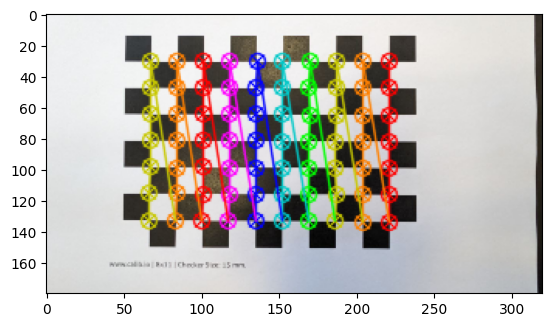

In [ ]:
# Ex 5.7
# Check quality of images
# - Checkerboard corners should be detected in all images
# - Images have the same rotation
# - Images have the same dimensions
# - Get every part of the frame covered

# Test findChessboardCorners() on an 'easy' image
top_view_path = "media/checker/top.jpg"
top_view = cv2.imread(top_view_path)
im_small = cv2.resize(top_view, None, fx=0.25, fy=0.25)

out = cv2.findChessboardCorners(im_small, (7, 10))  # size: no. internal corners

# Draw the corners
im_corners = im_small.copy()
cv2.drawChessboardCorners(im_corners, (7, 10), out[1], out[0])

# cv2.imshow() crashes in Jupyter
%matplotlib inline
plt.imshow(cv2.cvtColor(im_corners, cv2.COLOR_BGR2RGB))

Failed to find corners in photo_13_2024-03-01_15-37-16.jpg
Failed to find corners in photo_17_2024-03-01_15-37-16.jpg
Failed to find corners in photo_6_2024-03-01_15-37-16.jpg
Failed to find corners in photo_9_2024-03-01_15-37-16.jpg


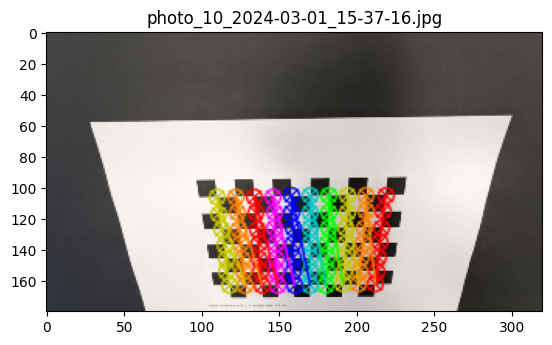

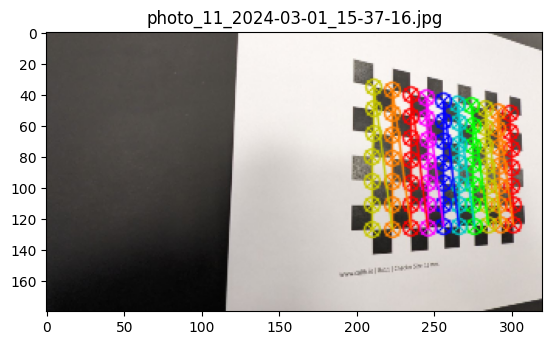

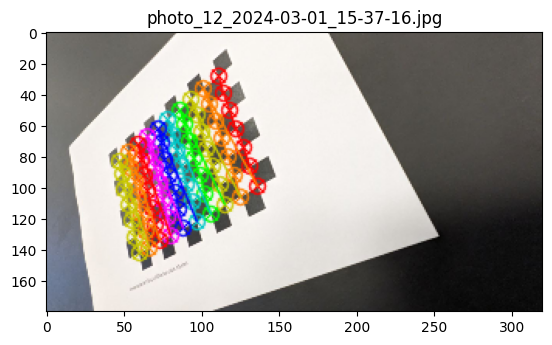

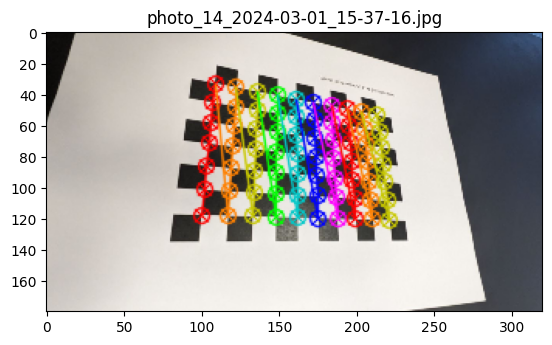

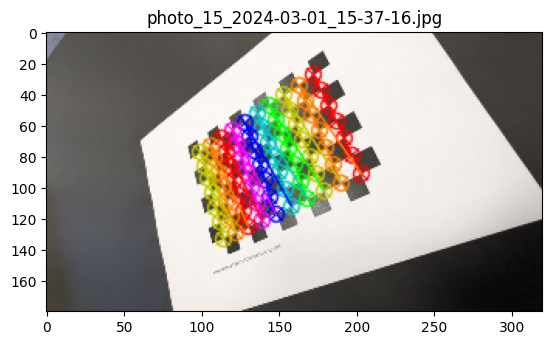

...

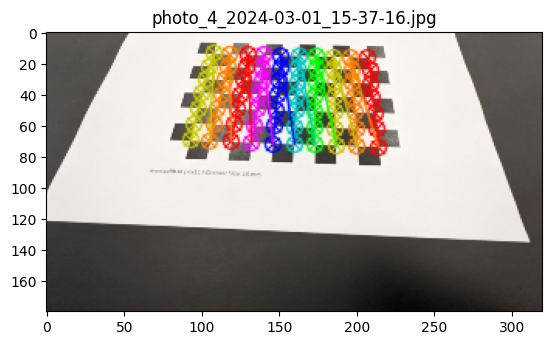

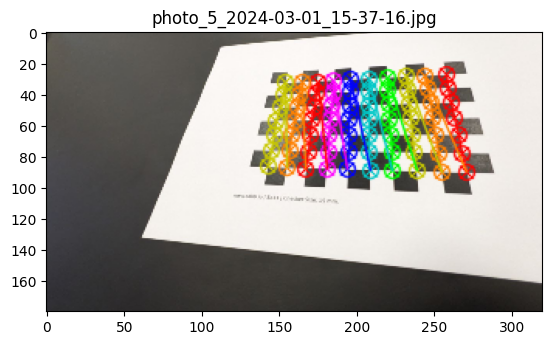

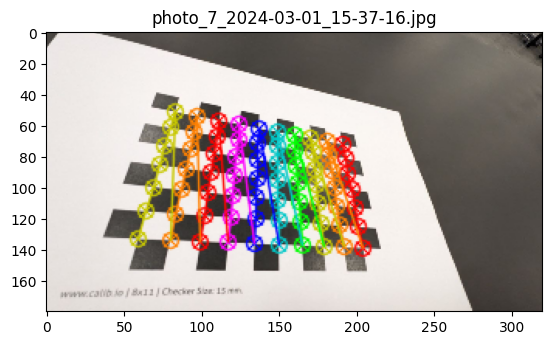

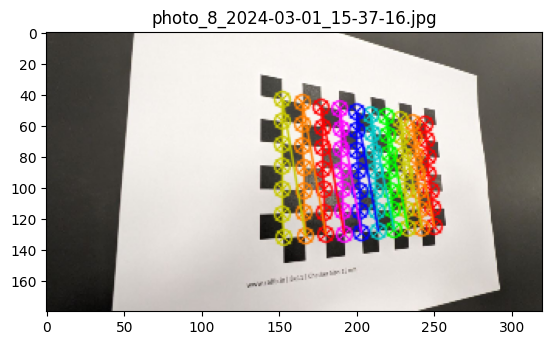

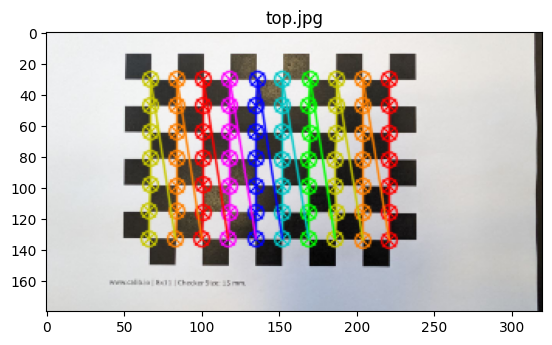

In [ ]:
# Run findChessboardCorners() on all images
passed_idx = []
for i, im in enumerate(images):
    im_small = cv2.resize(im, None, fx=0.25, fy=0.25)
    out = cv2.findChessboardCorners(im_small, (7, 10))

    if out != (False, None):
        passed_idx.append(i)
    else:
        print(f"Failed to find corners in {img_names[i]}")
        continue
    # Draw the corners
    im_corners = im_small.copy()
    cv2.drawChessboardCorners(im_corners, (7, 10), out[1], out[0])

    # cv2.imshow() crashes in Jupyter
    %matplotlib inline
    plt.figure()
    plt.title(img_names[i])
    plt.imshow(cv2.cvtColor(im_corners, cv2.COLOR_BGR2RGB))

In [ ]:
# Ex 5.8
# Calibrate camera using the images with found corners
checker_size = 15  # mm
Q_omega = checkerboard_points(7, 10)  # corner points in 3D
Q_omega = Q_omega * checker_size / 1000  # 15mm between corners
print(f"Q_omega:\n{Q_omega}")  # 3x70

Q_omega:
[[-0.045  -0.045  -0.045  -0.045  -0.045  -0.045  -0.045  -0.045  -0.045
  -0.045  -0.03   -0.03   -0.03   -0.03   -0.03   -0.03   -0.03   -0.03
  -0.03   -0.03   -0.015  -0.015  -0.015  -0.015  -0.015  -0.015  -0.015
  -0.015  -0.015  -0.015   0.      0.      0.      0.      0.      0.
   0.      0.      0.      0.      0.015   0.015   0.015   0.015   0.015
   0.015   0.015   0.015   0.015   0.015   0.03    0.03    0.03    0.03
   0.03    0.03    0.03    0.03    0.03    0.03    0.045   0.045   0.045
   0.045   0.045   0.045   0.045   0.045   0.045   0.045 ]
 [-0.0675 -0.0525 -0.0375 -0.0225 -0.0075  0.0075  0.0225  0.0375  0.0525
   0.0675 -0.0675 -0.0525 -0.0375 -0.0225 -0.0075  0.0075  0.0225  0.0375
   0.0525  0.0675 -0.0675 -0.0525 -0.0375 -0.0225 -0.0075  0.0075  0.0225
   0.0375  0.0525  0.0675 -0.0675 -0.0525 -0.0375 -0.0225 -0.0075  0.0075
   0.0225  0.0375  0.0525  0.0675 -0.0675 -0.0525 -0.0375 -0.0225 -0.0075
   0.0075  0.0225  0.0375  0.0525  0.0675 -0.0675 -0.052

In [ ]:
# Test findChessboardCorners() on an 'easy' image
top_view_path = "media/checker/top.jpg"
top_view = cv2.imread(top_view_path)
im_small = cv2.resize(top_view, None, fx=0.25, fy=0.25)
out = cv2.findChessboardCorners(im_small, (7, 10))
q = out[1].squeeze().T  # (2,70)

# Check order of points from checkerboard_points(n, m) matches with the
# order that they are returned by cv2.findChessboardCorners
# out: corners are listed column-wise, starting from the top-left corner
# q: corners are listed row-wise, starting from the bottom-left corner

# Rearrange Q_omega to match q
# This iterates through the order of Q_omega, from index 0.
new_Q_omega = np.zeros_like(Q_omega)
for i in range(7):  # 7 rows
    for j in range(10):  # 10 cols
        # Q[0] is out[6]
        # Q[1] is out[13]
        old_Q_idex = i * 10 + j
        new_Q_idx = j * 7 + (6 - i)
        print(f"Putting Q[{old_Q_idex}] in new_Q[{new_Q_idx}]")
        new_Q_omega[:, new_Q_idx] = Q_omega[:, old_Q_idex]
print(f"new_Q_omega:\n{new_Q_omega}")

Putting Q[0] in new_Q[6]
Putting Q[1] in new_Q[13]
Putting Q[2] in new_Q[20]
Putting Q[3] in new_Q[27]
Putting Q[4] in new_Q[34]
Putting Q[5] in new_Q[41]
Putting Q[6] in new_Q[48]
Putting Q[7] in new_Q[55]
Putting Q[8] in new_Q[62]
Putting Q[9] in new_Q[69]
Putting Q[10] in new_Q[5]
Putting Q[11] in new_Q[12]
Putting Q[12] in new_Q[19]
Putting Q[13] in new_Q[26]
Putting Q[14] in new_Q[33]
Putting Q[15] in new_Q[40]
Putting Q[16] in new_Q[47]
Putting Q[17] in new_Q[54]
Putting Q[18] in new_Q[61]
Putting Q[19] in new_Q[68]
Putting Q[20] in new_Q[4]
Putting Q[21] in new_Q[11]
Putting Q[22] in new_Q[18]
Putting Q[23] in new_Q[25]
Putting Q[24] in new_Q[32]
Putting Q[25] in new_Q[39]
Putting Q[26] in new_Q[46]
Putting Q[27] in new_Q[53]
Putting Q[28] in new_Q[60]
Putting Q[29] in new_Q[67]
Putting Q[30] in new_Q[3]
Putting Q[31] in new_Q[10]
Putting Q[32] in new_Q[17]
Putting Q[33] in new_Q[24]
Putting Q[34] in new_Q[31]
Putting Q[35] in new_Q[38]
Putting Q[36] in new_Q[45]
Putting Q[37] i

In [ ]:
print(passed_idx)

[0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 23]


In [ ]:
# Calibrate camera
qs = []  # stores corner points from each image
for i in passed_idx:
    passed_im = images[i]
    im_small = cv2.resize(passed_im, None, fx=0.25, fy=0.25)
    out = cv2.findChessboardCorners(im_small, (7, 10))
    # out[1]: 70x1x2 array of pixel points
    q = out[1].squeeze().T  # (2,70)
    qs.append(q)
qs = np.array(qs)  # (n_passed, 2, 70)

K_est, Rs, ts = calibrate_camera(qs, new_Q_omega)
print(f"K_est:\n{K_est}")
print(f"Estimated image center: {K_est[0,2]:.2f}, {K_est[1,2]:.2f}")

# Image was scaled down by 0.25 in the calibration process
im_center = 0.25 * np.array([1280, 720]) / 2
print(f"True image center: {im_center}")
# TODO: question, how does the focal length change when the image is resized?

K_est:
[[154.58872903   0.25959486 160.60796489]
 [  0.         154.51904723  89.80692863]
 [  0.           0.           1.        ]]
Estimated image center: 160.61, 89.81
True image center: [160.  90.]


In [ ]:
# Ex 5.9
# Reproject checkboard corners to the images, compute RMSE

errors = []  # list of rmse for each image
for Ri, ti, qi in zip(Rs, ts, qs):
    q_est = project_points(K_est, Ri, ti, new_Q_omega)
    rmse = compute_rmse(qi, q_est)
    errors.append(rmse)
print(f"max RMSE: {max(errors)}")

max RMSE: 0.2129114094781506


i: 0, passed_i: 0
Using image photo_10_2024-03-01_15-37-16.jpg


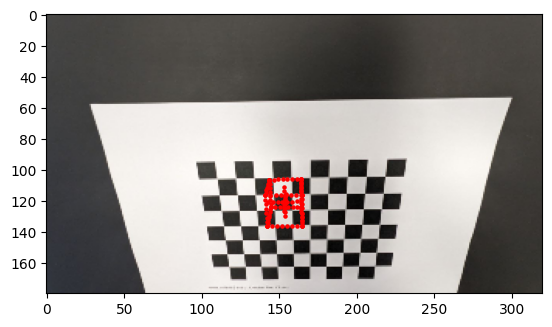

i: 1, passed_i: 1
Using image photo_11_2024-03-01_15-37-16.jpg


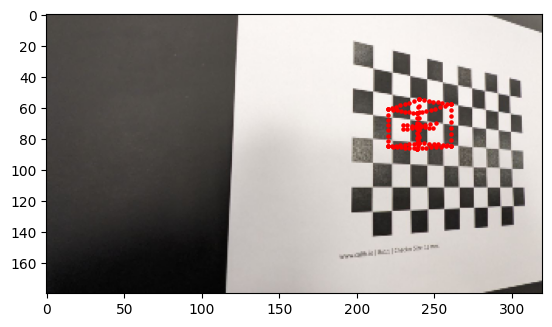

i: 2, passed_i: 2
Using image photo_12_2024-03-01_15-37-16.jpg


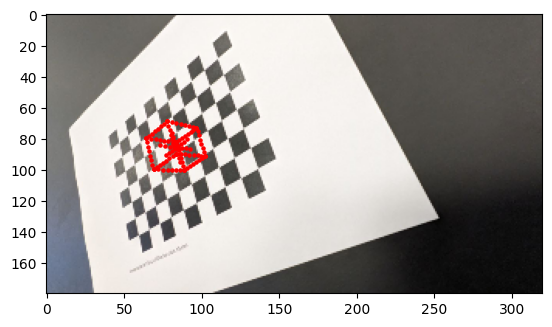

i: 4, passed_i: 3
Using image photo_14_2024-03-01_15-37-16.jpg


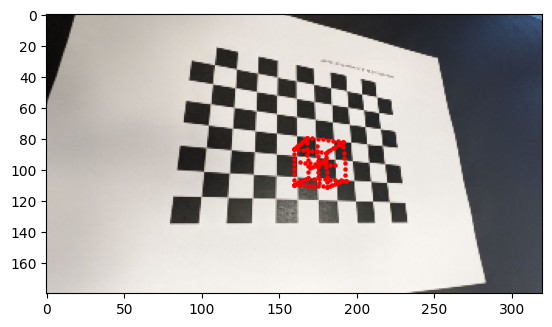

i: 5, passed_i: 4
Using image photo_15_2024-03-01_15-37-16.jpg


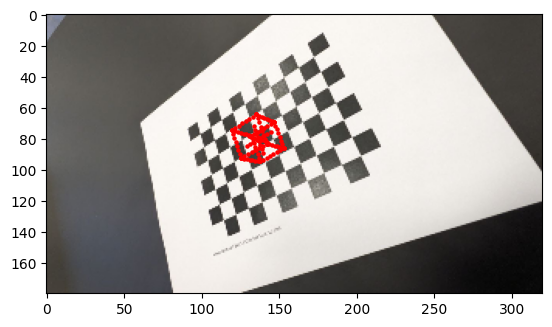

i: 6, passed_i: 5
Using image photo_16_2024-03-01_15-37-16.jpg


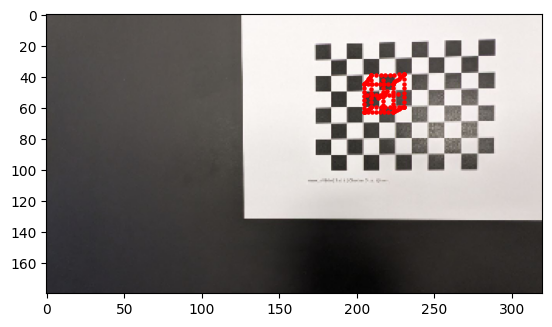

i: 8, passed_i: 6
Using image photo_18_2024-03-01_15-37-16.jpg


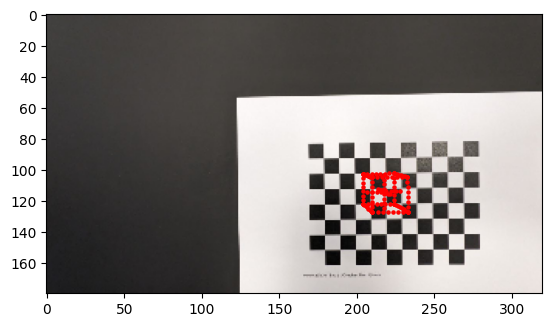

i: 9, passed_i: 7
Using image photo_19_2024-03-01_15-37-16.jpg


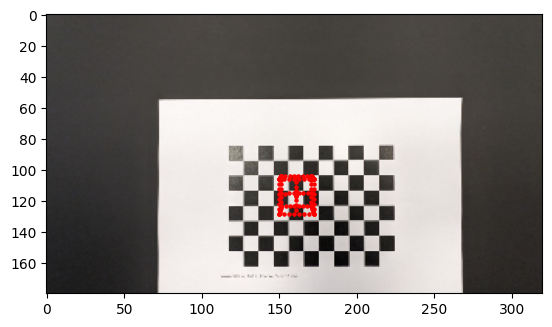

i: 10, passed_i: 8
Using image photo_1_2024-03-01_15-37-16.jpg


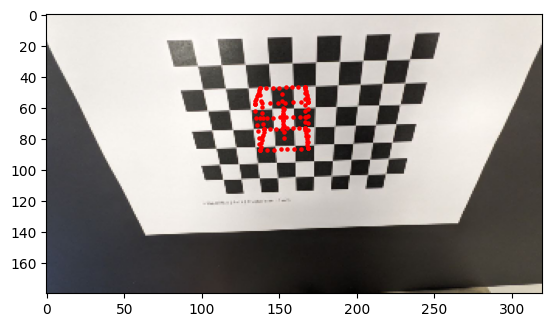

i: 11, passed_i: 9
Using image photo_20_2024-03-01_15-37-16.jpg


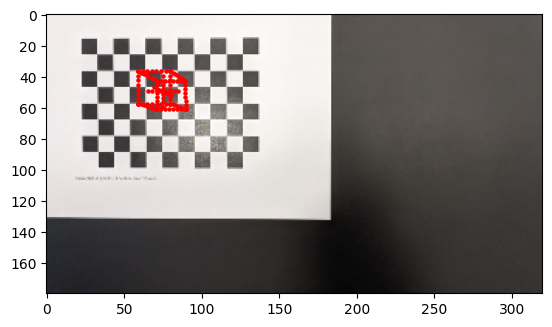

i: 12, passed_i: 10
Using image photo_21_2024-03-01_15-37-16.jpg


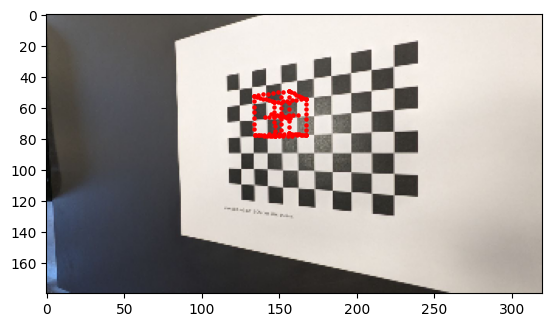

i: 13, passed_i: 11
Using image photo_22_2024-03-01_15-37-16.jpg


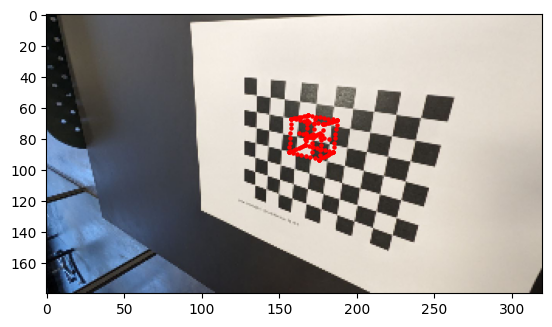

i: 14, passed_i: 12
Using image photo_23_2024-03-01_15-37-16.jpg


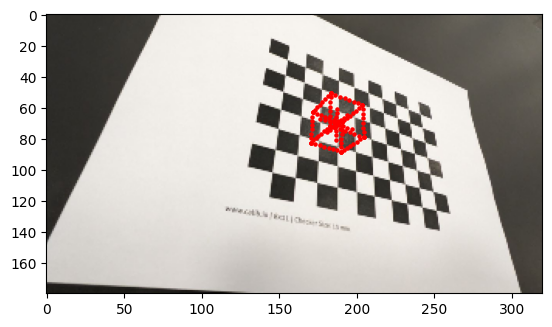

i: 15, passed_i: 13
Using image photo_2_2024-03-01_15-37-16.jpg


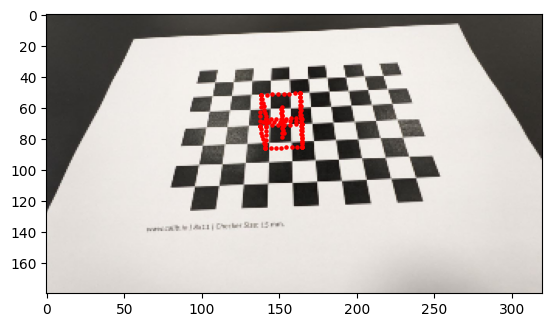

i: 16, passed_i: 14
Using image photo_3_2024-03-01_15-37-16.jpg


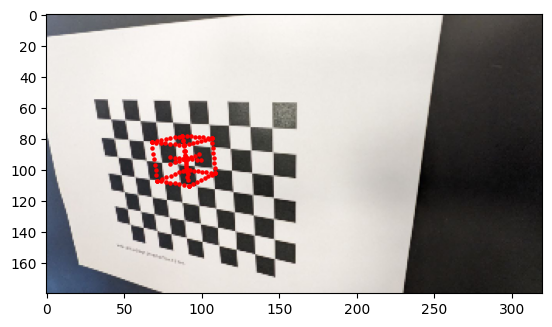

i: 17, passed_i: 15
Using image photo_4_2024-03-01_15-37-16.jpg


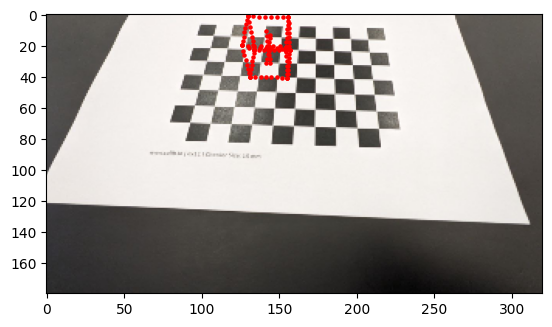

i: 18, passed_i: 16
Using image photo_5_2024-03-01_15-37-16.jpg


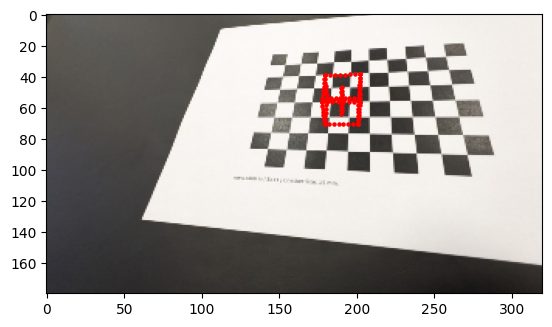

i: 20, passed_i: 17
Using image photo_7_2024-03-01_15-37-16.jpg


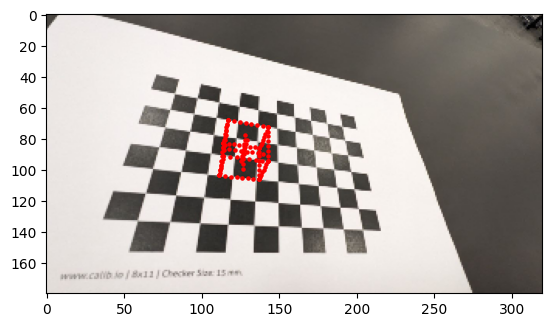

i: 21, passed_i: 18
Using image photo_8_2024-03-01_15-37-16.jpg


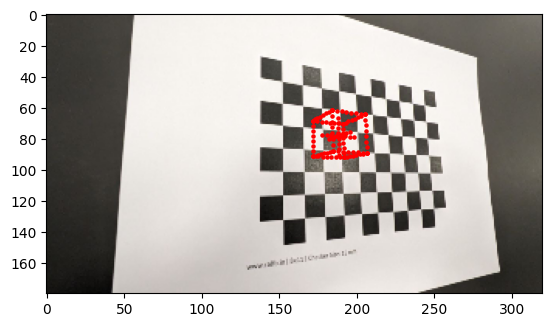

i: 23, passed_i: 19
Using image top.jpg


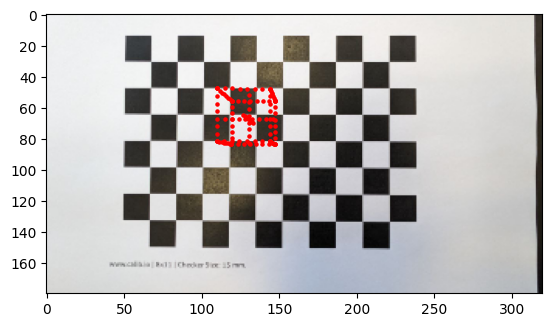

In [ ]:
# Ex 5.10
# Project box3d onto an image

Q = 2 * box3d(8) + 1  # Define 3D points of the box
Q = Q * checker_size / 1000  # 15mm between corners

for i in passed_idx:
    im_idx = i
    im = images[im_idx]
    passed_i = passed_idx.index(im_idx)
    print(f"i: {i}, passed_i: {passed_i}")
    print(f"Using image {img_names[im_idx]}")

    # Rs, ts are for the images that were passed to calibrate_camera()
    R_idx = Rs[passed_i]
    t_idx = ts[passed_i]
    q_idx = project_points(K_est, R_idx, t_idx, Q)  # (2,240)

    # Draw the box
    im = cv2.resize(im, None, fx=0.25, fy=0.25)
    im_box = im.copy()

    # Scatter plot of projected points
    plt.scatter(q_idx[0], q_idx[1], c="r", s=5)
    plt.imshow(cv2.cvtColor(im_box, cv2.COLOR_BGR2RGB))
    plt.show()

# Exercise 6

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Ex 6.1
# Create a 1D Gaussian kernel
def gaussian_1D_kernel(sigma, rule=5):
    """
    Returns the 1D Gaussian kernel.

    Args:
        sigma: width of Gaussian kernel
        rule (int): number of standard deviations to each side of the mean

    Returns:
        g: 1D Gaussian kernel
        gd: 1D Gaussian kernel derivative
    """
    if sigma == 0:
        return [1], [0]
    x = np.arange(-rule * sigma, rule * sigma + 1)
    g = np.exp(-(x**2) / (2 * sigma**2))
    g = g / np.sum(g)  # normalize
    gd = -x / (sigma**2) * g
    return g, gd


sigma = 5
g, gd = gaussian_1D_kernel(sigma)
print(f"Gaussian kernel: {g.shape}\n{g}")
print(f"Gaussian kernel derivative: {gd.shape}\n{gd}")

Gaussian kernel: (51,)
[2.97344000e-07 7.92260076e-07 2.02817107e-06 4.98849588e-06
 1.17886174e-05 2.67660538e-05 5.83894041e-05 1.22380426e-04
 2.46443914e-04 4.76817795e-04 8.86369970e-04 1.58309083e-03
 2.71659473e-03 4.47890751e-03 7.09492087e-03 1.07981968e-02
 1.57900368e-02 2.21841741e-02 2.99455029e-02 3.88372236e-02
 4.83941606e-02 5.79383294e-02 6.66449422e-02 7.36540520e-02
 7.82085642e-02 7.97884820e-02 7.82085642e-02 7.36540520e-02
 6.66449422e-02 5.79383294e-02 4.83941606e-02 3.88372236e-02
 2.99455029e-02 2.21841741e-02 1.57900368e-02 1.07981968e-02
 7.09492087e-03 4.47890751e-03 2.71659473e-03 1.58309083e-03
 8.86369970e-04 4.76817795e-04 2.46443914e-04 1.22380426e-04
 5.83894041e-05 2.67660538e-05 1.17886174e-05 4.98849588e-06
 2.02817107e-06 7.92260076e-07 2.97344000e-07]
Gaussian kernel derivative: (51,)
[ 2.97344000e-07  7.60569673e-07  1.86591739e-06  4.38987637e-06
  9.90243860e-06  2.14128431e-05  4.43759471e-05  8.81139066e-05
  1.67581861e-04  3.05163389e-04  

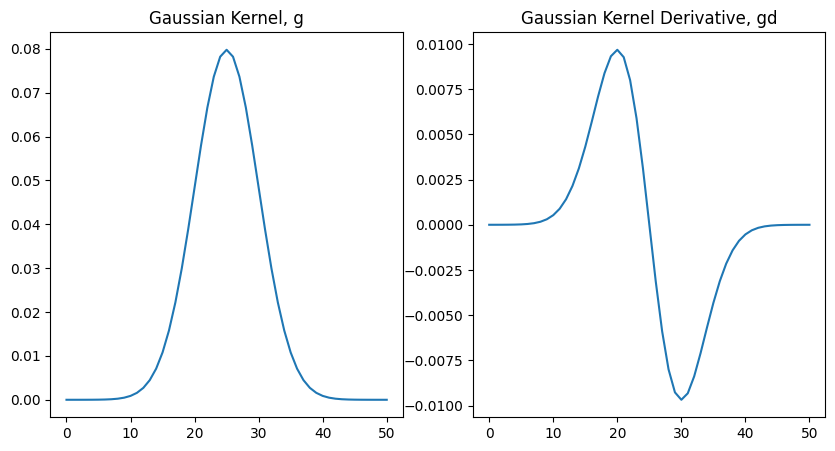

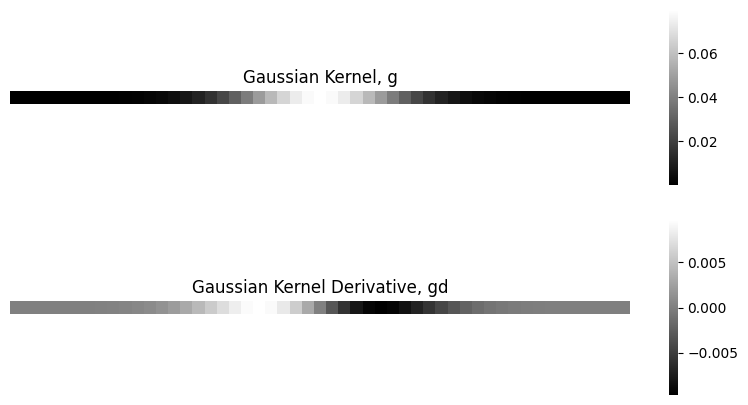

In [ ]:
# Plotting as line plots
figure, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].plot(g)
ax[0].set_title("Gaussian Kernel, g")
ax[1].plot(gd)
ax[1].set_title("Gaussian Kernel Derivative, gd")
plt.show()

# Plotting as pixel heatmap
figure, ax = plt.subplots(2, 1, figsize=(10, 5))
ax[0].set_title("Gaussian Kernel, g")
ax[0].set_axis_off()
ax[1].set_title("Gaussian Kernel Derivative, gd")
ax[1].set_axis_off()
sns.heatmap([g], ax=ax[0], square=True, cmap="gray")
sns.heatmap([gd], ax=ax[1], square=True, cmap="gray")
plt.show()

<>:18: SyntaxWarning: invalid escape sequence '\s'
<>:19: SyntaxWarning: invalid escape sequence '\s'
<>:20: SyntaxWarning: invalid escape sequence '\s'
<>:18: SyntaxWarning: invalid escape sequence '\s'
<>:19: SyntaxWarning: invalid escape sequence '\s'
<>:20: SyntaxWarning: invalid escape sequence '\s'
C:\Users\yufan\AppData\Local\Temp\ipykernel_11768\710124197.py:18: SyntaxWarning: invalid escape sequence '\s'
  ax[0].set_title(f'g $\sigma$=2 has {g2.shape[0]} elements')
C:\Users\yufan\AppData\Local\Temp\ipykernel_11768\710124197.py:19: SyntaxWarning: invalid escape sequence '\s'
  ax[1].set_title(f'g $\sigma$=5 has {g5.shape[0]} elements')
C:\Users\yufan\AppData\Local\Temp\ipykernel_11768\710124197.py:20: SyntaxWarning: invalid escape sequence '\s'
  ax[2].set_title(f'g $\sigma$=10 has {g10.shape[0]} elements')


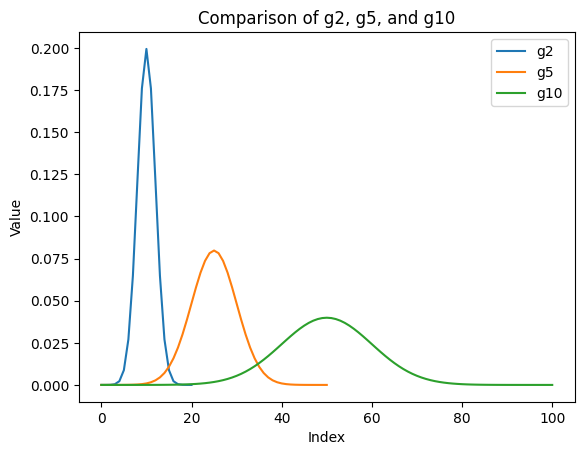

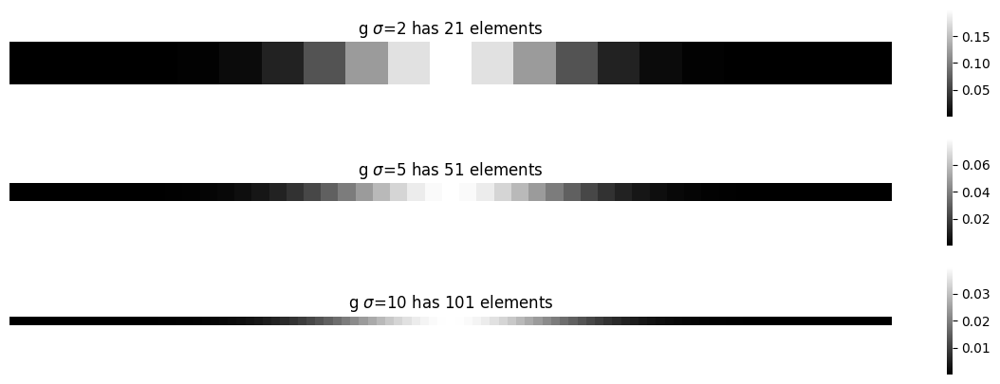

In [ ]:
# Visualizing kernels with different sigma
g2, gd2 = gaussian_1D_kernel(sigma=2)
g5, gd5 = gaussian_1D_kernel(sigma=5)
g10, gd10 = gaussian_1D_kernel(sigma=10)

# Plotting as line plots
plt.plot(g2, label="g2")
plt.plot(g5, label="g5")
plt.plot(g10, label="g10")
plt.xlabel("Index")
plt.ylabel("Value")
plt.title("Comparison of g2, g5, and g10")
plt.legend()
plt.show()

# Plotting as pixel heatmaps
figure, ax = plt.subplots(3, 1, figsize=(15, 5))
ax[0].set_title(f"g $\sigma$=2 has {g2.shape[0]} elements")
ax[1].set_title(f"g $\sigma$=5 has {g5.shape[0]} elements")
ax[2].set_title(f"g $\sigma$=10 has {g10.shape[0]} elements")
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[2].set_axis_off()
sns.heatmap([g2], ax=ax[0], square=True, cmap="gray")
sns.heatmap([g5], ax=ax[1], square=True, cmap="gray")
sns.heatmap([g10], ax=ax[2], square=True, cmap="gray")
plt.show()

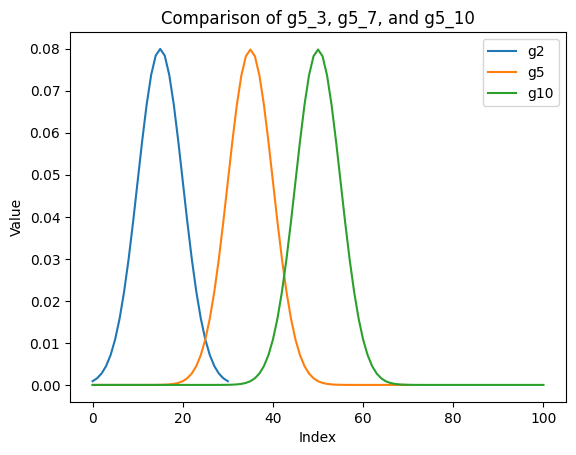

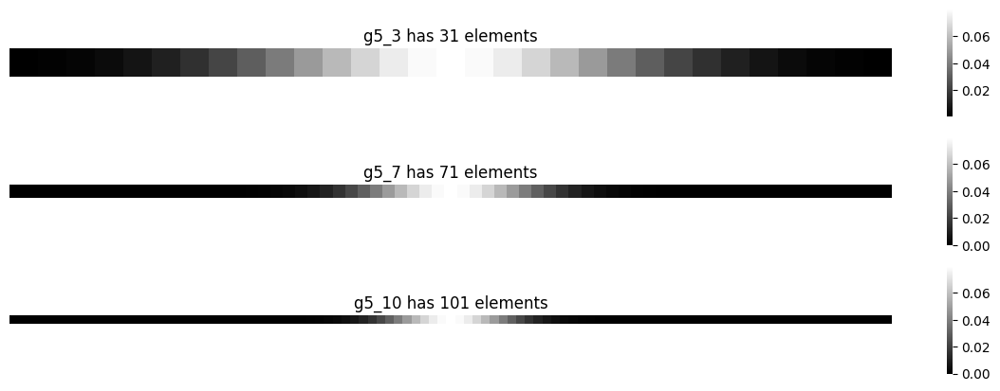

In [ ]:
# Visualizing kernels with different rules
g5_3, gd5_3 = gaussian_1D_kernel(sigma=5, rule=3)
g5_7, gd5_7 = gaussian_1D_kernel(sigma=5, rule=7)
g5_10, gd5_10 = gaussian_1D_kernel(sigma=5, rule=10)

# Plotting as line plots
plt.plot(g5_3, label="g2")
plt.plot(g5_7, label="g5")
plt.plot(g5_10, label="g10")
plt.xlabel("Index")
plt.ylabel("Value")
plt.title("Comparison of g5_3, g5_7, and g5_10")
plt.legend()
plt.show()

# Plotting as pixel heatmaps
figure, ax = plt.subplots(3, 1, figsize=(15, 5))
ax[0].set_title(f"g5_3 has {g5_3.shape[0]} elements")
ax[1].set_title(f"g5_7 has {g5_7.shape[0]} elements")
ax[2].set_title(f"g5_10 has {g5_10.shape[0]} elements")
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[2].set_axis_off()
sns.heatmap([g5_3], ax=ax[0], square=True, cmap="gray")
sns.heatmap([g5_7], ax=ax[1], square=True, cmap="gray")
sns.heatmap([g5_10], ax=ax[2], square=True, cmap="gray")
plt.show()

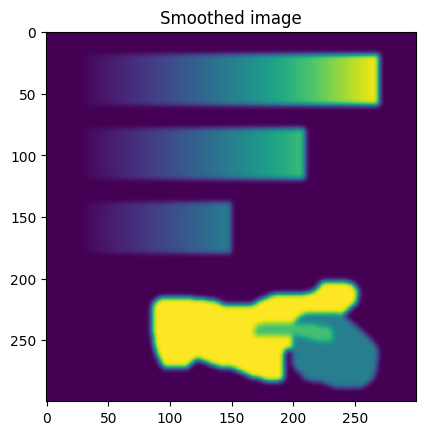

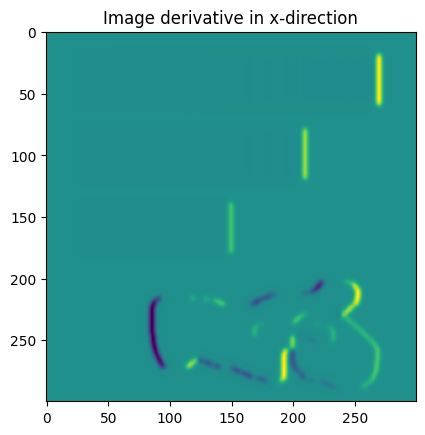

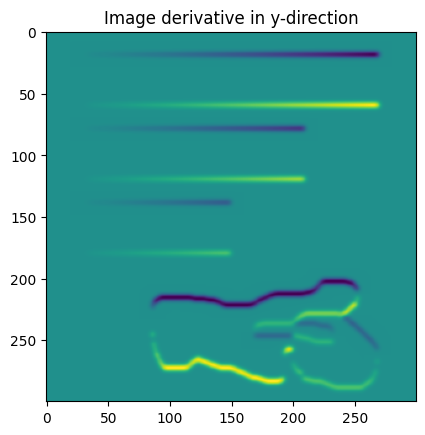

In [ ]:
# Ex 6.2
# Apply the Gaussian kernel to the input image
def gaussian_smoothing(im, sigma):
    """
    Smooths the input image with a 1D Gaussian kernel.

    Args:
        im : input image
        sigma : width of Gaussian kernel

    Returns:
        I : smoothed image
        Ix : image derivative in x-direction
        Iy : image derivative in y-direction
    """
    g, gd = gaussian_1D_kernel(sigma)
    I = cv2.sepFilter2D(im, -1, g, g)
    Ix = cv2.sepFilter2D(im, -1, gd, g)
    Iy = cv2.sepFilter2D(im, -1, g, gd)
    return I, Ix, Iy


im = "media/week06_data/TestIm2.png"
im = cv2.imread(im, cv2.IMREAD_GRAYSCALE).astype(float)
sigma = 2
I, Ix, Iy = gaussian_smoothing(im, sigma)

%matplotlib inline
# Display images
plt.imshow(I)
plt.title("Smoothed image")
plt.show()

plt.imshow(Ix)
plt.title("Image derivative in x-direction")
plt.show()

plt.imshow(Iy)
plt.title("Image derivative in y-direction")
plt.show()

Structure tensor: (2, 2, 300, 300)


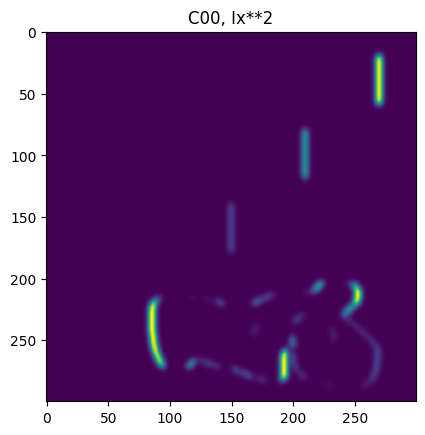

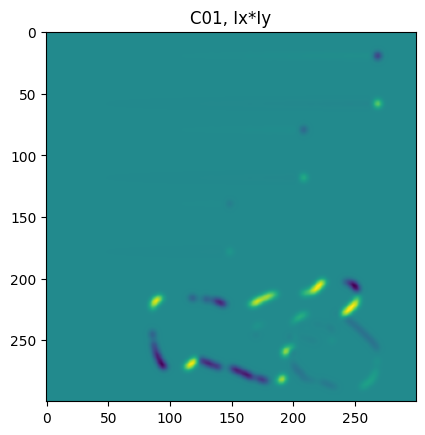

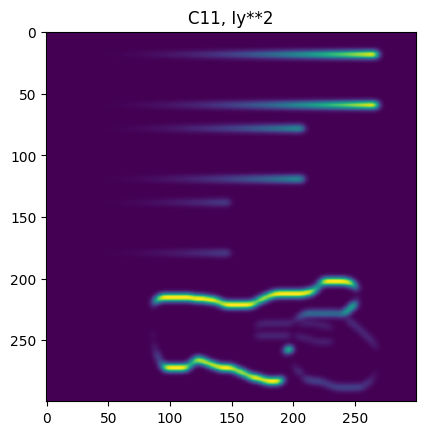

In [ ]:
# Ex 6.3
# Create structure tensor using gaussian kernels
def structure_tensor(im, sigma, epsilon):
    """
    Computes the structure tensor C(x,y) of the input image.

    Args:
        im : input image
        sigma : Gaussian width to compute derivatives
        epsilon : Gaussian width to compute the structure tensor

    Returns:
        J : structure tensor
    """
    I, Ix, Iy = gaussian_smoothing(im, sigma)

    g_eps, g_eps_d = gaussian_1D_kernel(epsilon)
    C = np.zeros((2, 2))
    C00 = cv2.sepFilter2D(Ix**2, -1, g_eps, g_eps)
    C01 = cv2.sepFilter2D(Ix * Iy, -1, g_eps, g_eps)
    C10 = C01
    C11 = cv2.sepFilter2D(Iy**2, -1, g_eps, g_eps)
    # C00 = cv2.filter2D(Ix**2, -1, g_eps)
    # C01 = cv2.filter2D(Ix*Iy, -1, g_eps)
    # C10 = C01
    # C11 = cv2.filter2D(Iy**2, -1, g_eps)
    C = np.array([[C00, C01], [C10, C11]])

    return C


sigma = 2
epsilon = 2
C = structure_tensor(im, sigma, epsilon)

print(f"Structure tensor: {C.shape}")

# Display images
plt.imshow(C[0, 0])
plt.title("C00, Ix**2")
plt.show()

plt.imshow(C[0, 1])
plt.title("C01, Ix*Iy")
plt.show()

plt.imshow(C[1, 1])
plt.title("C11, Iy**2")
plt.show()

r: (300, 300)


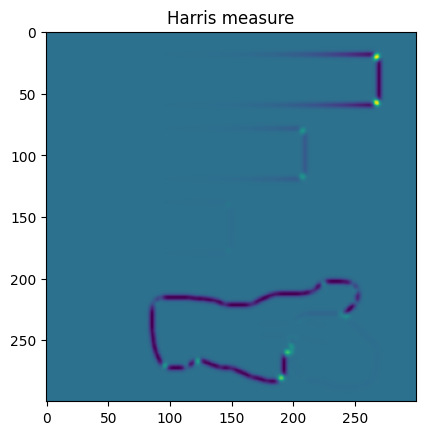

In [ ]:
# Ex 6.4
# Harris measure using the structure tensor
def harris_measure(im, sigma, epsilon, k):
    """
    Computes the Harris measure R(x,y) of the input image.

    Args:
        im : (h,w) input image
        sigma : Gaussian width to compute derivatives
        epsilon : Gaussian width to compute the structure tensor
        k : sensitivity factor

    Returns:
        r : (h,w), Harris measure
    """
    C = structure_tensor(im, sigma, epsilon)
    a = C[0, 0]
    b = C[1, 1]
    c = C[0, 1]
    r = a * b - c**2 - k * (a + b) ** 2
    return r


k = 0.06
r = harris_measure(im, sigma, epsilon, k)
print(f"r: {r.shape}")

# Display images
plt.imshow(r)
plt.title("Harris measure")
plt.show()

# When epsilon is zero, the Gaussian distribution becomes a delta function,
# and the structure tensor becomes a constant tensor. There will not be any
# blurring in place. And the equations will be undefined.

r: [223102.60, -132061.03], tau = 0.02*r.max
16 corners found.


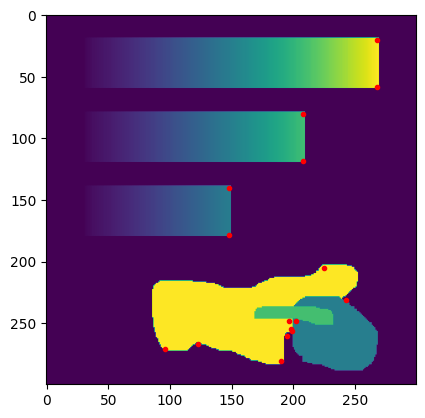

In [ ]:
# Ex 6.5
# Corner detection with non-max suppression
def corner_detector(im, sigma, epsilon, tau, k):
    """
    Detects corners in the input image using the Harris measure
    with non-max suprrssion and thresholding.

    Args:
        im : input image
        sigma : Gaussian width to compute derivatives
        epsilon : Gaussian width to compute the structure tensor
        tau : threshold for Harris measure
        k : sensitivity factor

    Returns:
        c : list of corner coordinates
    """
    r = harris_measure(im, sigma, epsilon, k)
    print(f"r: [{r.max():.2f}, {r.min():.2f}], tau = {tau/r.max():.2f}*r.max")

    # Perform 4-neigbourhood non-max suppression
    c = []
    for i in range(1, r.shape[0] - 1):
        for j in range(1, r.shape[1] - 1):
            if (
                r[i, j] > r[i + 1, j]
                and r[i, j] >= r[i - 1, j]
                and r[i, j] > r[i, j + 1]
                and r[i, j] >= r[i, j - 1]
                and r[i, j] > tau
            ):  # Threshold
                c.append([i, j])
    return c


# For TestIm2.png, the r-values are very high at the perfect corners.
# That's why the threshold is set below the recommended 0.1*r.max

tau = 5e3
c = corner_detector(im, sigma, epsilon, tau, k)
print(f"{len(c)} corners found.")

# Display corners
plt.imshow(im)
for pt in c:
    plt.plot(pt[1], pt[0], "r.")
plt.show()

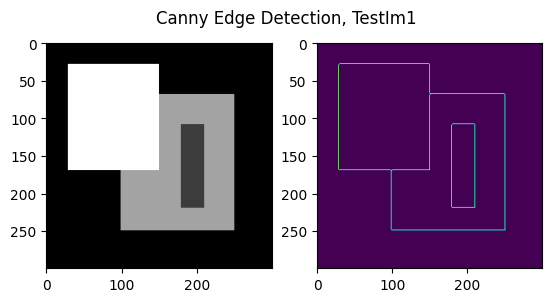

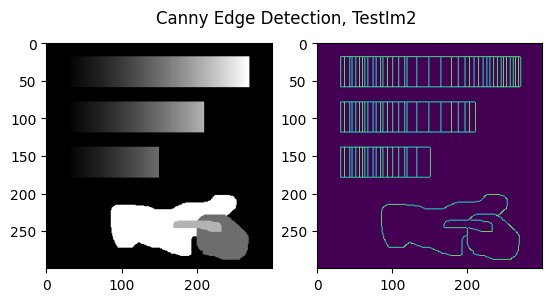

In [ ]:
# Ex 6.6
# Canny edge detector

im1 = cv2.imread("media/week06_data/TestIm1.png", cv2.IMREAD_GRAYSCALE)
# plt.imshow(im1)
# plt.show()

# Loading astype(float) does not work for canny edge
t1 = 5
t2 = 100
edges = cv2.Canny(im1, t1, t2)
plt.suptitle(
    "Canny Edge Detection, TestIm1", y=0.8
)  # y controls title position
plt.subplot(121), plt.imshow(im1, cmap="gray")
plt.subplot(122), plt.imshow(edges)
plt.show()

im2 = cv2.imread("media/week06_data/TestIm2.png", cv2.IMREAD_GRAYSCALE)
edges = cv2.Canny(im2, t1, t2)
plt.suptitle("Canny Edge Detection, TestIm2", y=0.8)
plt.subplot(121), plt.imshow(im2, cmap="gray")
plt.subplot(122), plt.imshow(edges)
plt.show()

# Exercise 7

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage
from cv02504.util_functions import PiInv

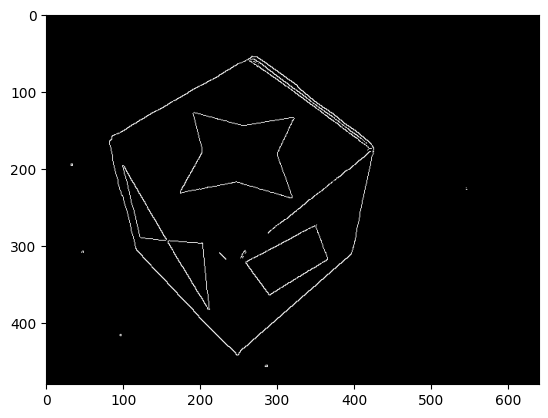

In [ ]:
# Ex 7.1
# Detect edges using Canny
im = "media/week06_data/Box3.bmp"
im = cv2.imread(im, cv2.IMREAD_GRAYSCALE)

edges = cv2.Canny(im, 100, 200)
plt.imshow(edges, cmap="gray")
plt.show()

## Hough Transform

In [ ]:
# Ex 7.2
# Compute Hough space
hspace, angles, dists = skimage.transform.hough_line(edges)
# hspace: Hough transform accumulator
# angles: Angles at which the transform is computed, in radians (theta)
# dists: Distance values at which the transform is computed (r)
print(f"angles: {len(angles)}")
print(f"dists: {len(dists)}")

angles: 180
dists: 1601


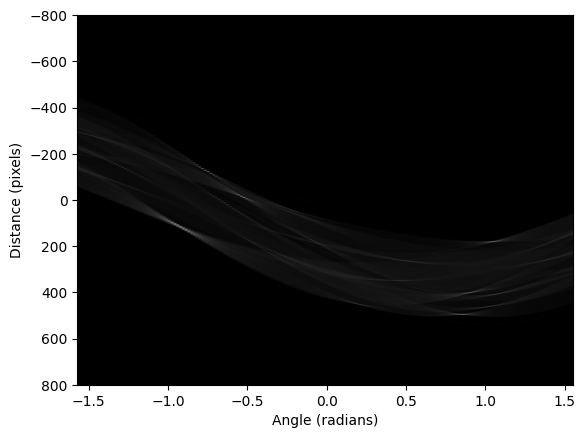

In [ ]:
# Ex 7.3
# Visualize Hough space
extent = [angles[0], angles[-1], dists[-1], dists[0]]
plt.xlabel("Angle (radians)")
plt.ylabel("Distance (pixels)")
plt.imshow(hspace, extent=extent, aspect="auto", cmap="gray")
plt.show()

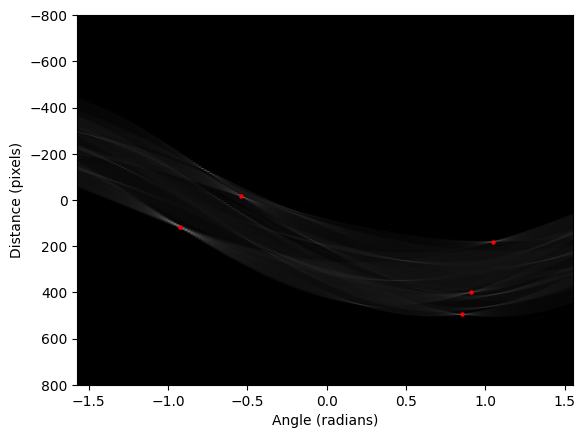

In [ ]:
# Ex 7.4
# Find peaks in Hough space
from skimage.transform import hough_line_peaks

n = 5
extH, extAngles, extDists = hough_line_peaks(hspace, angles, dists, num_peaks=n)
# extH: Hough transform accumulator values at the peaks
# extAngles: Angles at which the peaks are found, in radians
# extDists: Distance values at which the peaks are found

plt.scatter(extAngles, extDists, c="r", s=5)

extent = [angles[0], angles[-1], dists[-1], dists[0]]
plt.xlabel("Angle (radians)")
plt.ylabel("Distance (pixels)")
plt.imshow(hspace, extent=extent, aspect="auto", cmap="gray")
plt.show()

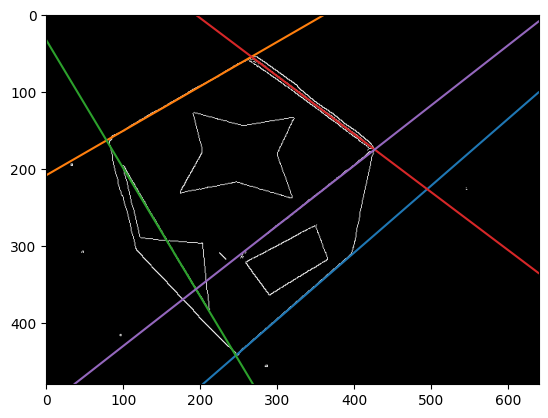

In [ ]:
# Ex 7.5
# Draw lines on the original image


def DrawLine(l, shape):
    # Checks where the line intersects the four sides of the image
    # and finds the two intersections that are within the frame

    def in_frame(l_im):
        """Returns the intersection point of the line with the image frame."""
        q = np.cross(l.flatten(), l_im)  # intersection point
        q = q[:2] / q[2]  # convert to inhomogeneous
        if all(q >= 0) and all(q + 1 <= shape[1::-1]):
            return q

    # 4 edge lines of the image
    lines = [
        [1, 0, 0],  # x = 0
        [0, 1, 0],  # y = 0
        [1, 0, 1 - shape[1]],  # x = shape[1]
        [0, 1, 1 - shape[0]],  # y = shape[0]
    ]

    P = [in_frame(l_im) for l_im in lines if in_frame(l_im) is not None]

    if len(P) == 0:
        print("Line is completely outside image")
    plt.plot(*np.array(P).T)


plt.imshow(edges, cmap="gray")
for i in range(n):
    angle = extAngles[i]
    dist = extDists[i]
    l = np.array([np.cos(angle), np.sin(angle), -dist])
    DrawLine(l, im.shape)

## RANSAC

In [ ]:
def test_points(n_in, n_out):
    """
    Generate data set consisting of inliers with noise and outliers.

    Args:
        n_in: number of inliers
        n_out: number of outliers

    Returns:
        points: 2x(n_in+n_out) array of points
    """
    # inliers: points along y=0.5*x+b
    a = (np.random.rand(n_in) - 0.5) * 10  # [-5, 5]
    b = np.vstack((a, a * 0.5 + np.random.randn(n_in) * 0.25))  # add 0.25 noise
    # outliers: random points
    points = np.hstack((b, 2 * np.random.randn(2, n_out)))
    return np.random.permutation(points.T).T  # randomly permute points

In [ ]:
# Ex 7.6
# Function to fit a line, in homo coords, given 2 points


def fit_line(p1, p2):
    """
    Fits a line given 2 points.

    Args:
        p1, p2 (np.array) : 2x1 inhomogenous coordinates

    Returns:
        l : 3x1, line in homogenous coordinates
    """
    if p1.shape == (2,):
        p1 = p1.reshape(2, 1)
        p2 = p2.reshape(2, 1)
    if p1.shape != (2, 1) or p2.shape != (2, 1):
        raise ValueError("Points must be 2x1 np.array")

    p1h = PiInv(p1)
    p2h = PiInv(p2)
    # cross() requires input as vectors
    l = np.cross(p1h.squeeze(), p2h.squeeze())
    return l


p1 = np.array([[2, 1]]).T  # 2x1
p2 = np.array([[3, 4]]).T
l = fit_line(p1, p2)
print(f"eqn of line: {l}")

eqn of line: [-3.  1.  5.]


In [ ]:
# Ex 7.7
# Function to determine inliners and outliers


def find_inliners_outliers(l, points, tau):
    """
    Args:
        l : equation of line in homogenous coordinates
        tau : threshold for inliners

    Returns:
        inliners (np.array) : 2xa, set of inliner points
        outliers (np.array) : 2xb, set of outlier points
    """
    inliners = []
    outliers = []
    for p in points.T:
        p = p.reshape(2, 1)
        ph = PiInv(p)
        d = abs(l.T @ ph) / (abs(ph[2]) * np.sqrt(l[0] ** 2 + l[1] ** 2))
        if d <= tau:  # inliner
            inliners.append(p)
        else:  # outlier
            outliers.append(p)
    inliners = np.array(inliners).squeeze().T
    outliers = np.array(outliers).squeeze().T
    return inliners, outliers


points = test_points(10, 10)
l = fit_line(points[:, 0], points[:, 1])
tau = 0.2
inliners, outliers = find_inliners_outliers(l, points, tau)

print(f"inliners.shape: {inliners.shape}, outliers.shape: {outliers.shape}")

inliners.shape: (2, 2), outliers.shape: (2, 18)


In [ ]:
# Ex 7.8
# Function to calculate consensus


def consensus(l, points, tau) -> int:
    """
    Returns the number of inliners.

    Args:
        l : equation of line in homogenous coordinates
        points : 2xn, set of points
        tau : threshold for inliners

    Returns:
        consensus : number of inliners
    """
    consensus = 0
    inliners, _ = find_inliners_outliers(l, points, tau)
    consensus = inliners.shape[1]
    return consensus


n_inliners = consensus(l, points, tau)
print(f"no. of inliners: {n_inliners}")

no. of inliners: 3


In [ ]:
# Ex 7.9
# Function to randomly sample two of n 2D points without replacement


def sample_points(points):
    """
    Args:
        points : nx2, set of points
        n : number of points to sample

    Returns:
        sample : 2xn, set of sampled points
    """
    n_points = 2
    sample = np.random.permutation(points.T).T[:, :n_points]
    return sample


sample = sample_points(points)
print(f"sampled points: \n{sample}")

sampled points: 
[[ 4.25591168 -4.62481341]
 [ 2.16409575 -2.45934556]]


sample: 
[[-0.85053928  4.73582989]
 [ 0.15080883  2.00376737]]
l: [-1.85295854  5.58636918 -2.41848781]


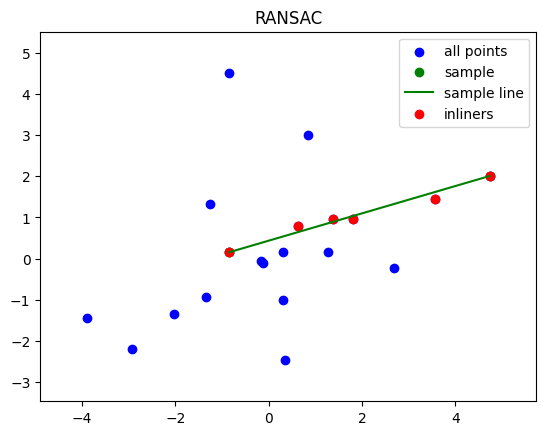

In [ ]:
"""
Sample iteration of RANSAC.
"""
points = test_points(10, 10)
sample = sample_points(points)
print(f"sample: \n{sample}")
l = fit_line(sample[:, 0], sample[:, 1])
print(f"l: {l}")

tau = 0.2
inliners = []
outliers = []
for p in points.T:
    p = p.reshape(2, 1)
    ph = PiInv(p)
    d = abs(l.T @ ph) / (
        abs(ph[2]) * np.sqrt(l[0] ** 2 + l[1] ** 2)
    )  # distance from point to line
    # print(d)
    if d <= tau:  # inliner
        inliners.append(p)
    else:  # outlier
        outliers.append(p)

inliners = np.array(inliners).squeeze().T

plt.scatter(points[0], points[1], c="b", label="all points")
plt.scatter(sample[0], sample[1], c="g", label="sample")
plt.plot(sample[0], sample[1], c="g", label="sample line")
plt.scatter(inliners[0], inliners[1], c="r", label="inliners")

plt.xlim(min(points[0]) - 1, max(points[0]) + 1)
plt.ylim(min(points[1]) - 1, max(points[1]) + 1)
plt.legend()
plt.title("RANSAC")
plt.show()

In [ ]:
def visualize_ransac(points, best_inliners, best_l) -> None:
    """
    Visualizes the RANSAC algorithm for 2D lines.

    Args:
        points : nx2, set of points
        best_inliners : ax2, set of inliner points
        best_l : equation of line in homogenous coordinates
    """

    plt.scatter(points[0], points[1], c="b", label="all points")
    plt.scatter(best_inliners[0], best_inliners[1], c="r", label="inliners")

    # Draw line created by samples
    slope = -best_l[0] / best_l[1]
    intercept = -best_l[2] / best_l[1]
    x = np.linspace(min(points[0]), max(points[0]), 100)
    y = slope * x + intercept
    plt.plot(x, y, c="g", label="best line")

    plt.xlim(min(points[0]) - 1, max(points[0]) + 1)
    plt.ylim(min(points[1]) - 1, max(points[1]) + 1)

    plt.legend()
    plt.title("RANSAC")
    plt.show()

best_l: [ 1.08800995 -1.6305574  -0.07850492]
no. of best_inliners: 8


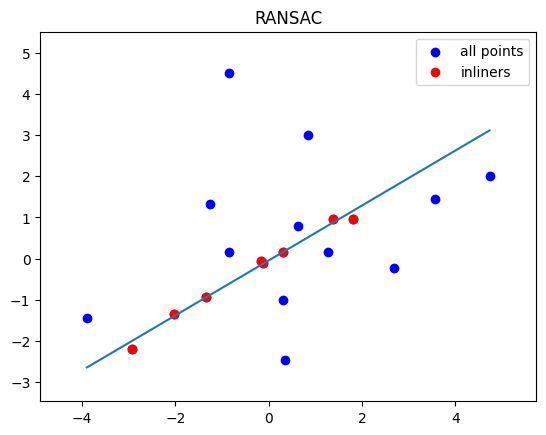

In [ ]:
# Ex 7.10
# Assemble the functions to implement RANSAC


def ransac(points, iters, tau, t=5):
    """
    Args:
        points : nx2, set of points
        iters : number of iterations
        tau : threshold for inliners
        t : number of inliners to accept the model

    Returns:
        best_l : equation of line in homogenous coordinates
        best_inliners : ax2, set of inliner points
    """
    best_l = None
    best_inliners = None
    best_consensus = 0
    for _ in range(iters):
        sample = sample_points(points)
        l = fit_line(sample[:, 0], sample[:, 1])
        consensus_ = consensus(l, points, tau)
        if consensus_ > t and consensus_ > best_consensus:
            best_l = l
            best_inliners, _ = find_inliners_outliers(l, points, tau)
            best_consensus = consensus_
    return best_l, best_inliners


# points = test_points(10, 10)
max_iter = 100
tau = 0.2
best_l, best_inliners = ransac(points, max_iter, tau)

print(f"best_l: {best_l}")
print(f"no. of best_inliners: {best_inliners.shape[1]}")
visualize_ransac(points, best_inliners, best_l)

tau: 0.1, no. of best_inliners: 6


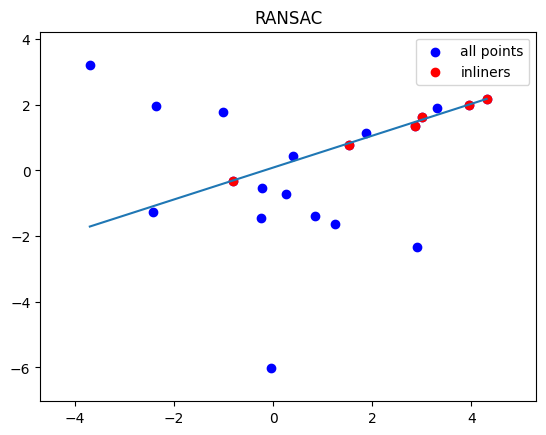

tau: 0.3, no. of best_inliners: 10


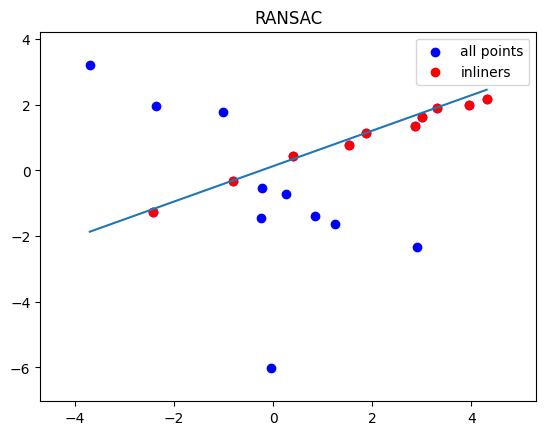

tau: 0.5, no. of best_inliners: 11


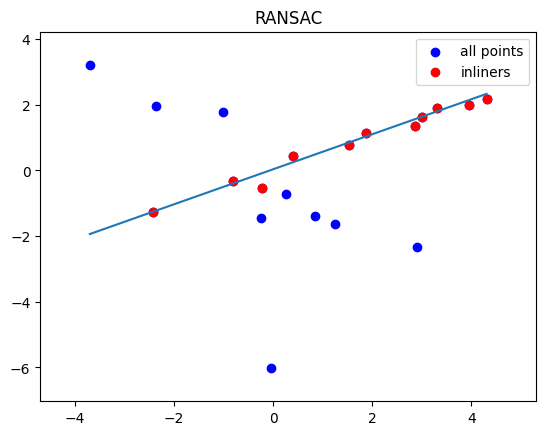

tau: 0.7, no. of best_inliners: 12


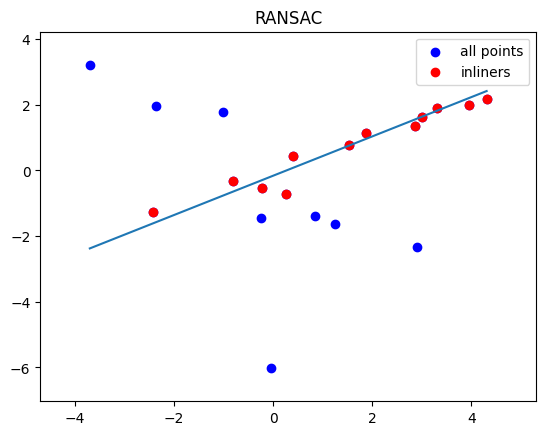

tau: 0.9, no. of best_inliners: 13


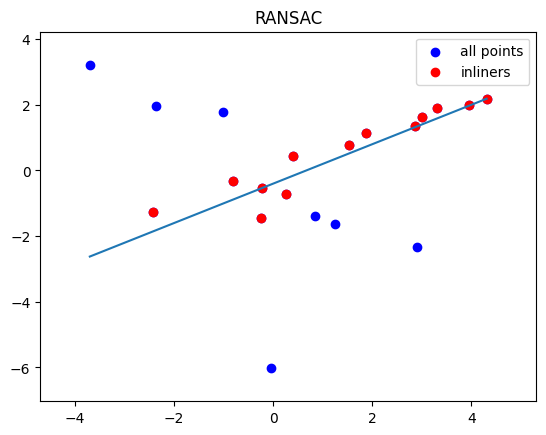

In [ ]:
# Ex 7.11
# Experiment with different thresholds

points = test_points(10, 10)
tau_list = [0.1, 0.3, 0.5, 0.7, 0.9]
for tau in tau_list:
    best_l, best_inliners = ransac(points, max_iter, tau)
    print(f"tau: {tau}, no. of best_inliners: {best_inliners.shape[1]}")
    visualize_ransac(points, best_inliners, best_l)

# tau = 0.3 detected all the inliers.
# this is expected because the dataset noise was set to 0.25
# beyond 0.3, the outliers will start to be included

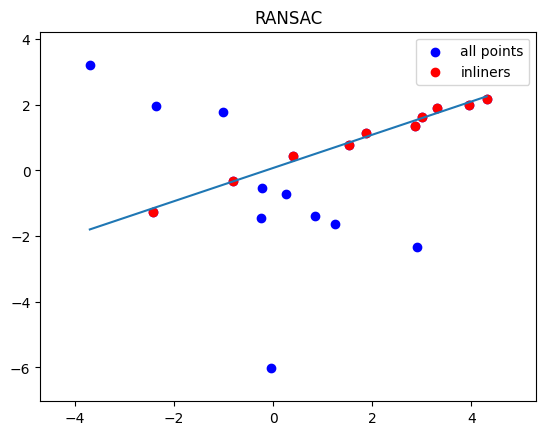

In [ ]:
# Ex 7.12
# Fit new line to all inliners of the best line


def pca_line(x):  # assumes x is a (2 x n) array of points
    d = np.cov(x)[:, 0]
    d /= np.linalg.norm(d)
    l = [d[1], -d[0]]
    l.append(-(l @ x.mean(1)))
    return l


def ransac(points, iters, tau, t=5):
    """
    Args:
        points : nx2, set of points
        iters : number of iterations
        tau : threshold for inliners
        t : number of inliners to accept the model

    Returns:
        best_line : equation of line in homogenous coordinates
        best_inliners : ax2, set of inliner points
    """
    best_inliners = None
    best_consensus = 0
    for _ in range(iters):
        sample = sample_points(points)
        l = fit_line(sample[:, 0], sample[:, 1])
        consensus_ = consensus(l, points, tau)
        if consensus_ > t and consensus_ > best_consensus:
            best_inliners, _ = find_inliners_outliers(l, points, tau)
            best_consensus = consensus_
    # Fit new line
    best_line = pca_line(best_inliners)
    return best_line, best_inliners


# points = test_points(10, 10)
max_iter = 100
tau = 0.2
best_l, best_inliners = ransac(points, max_iter, tau)
visualize_ransac(points, best_inliners, best_l)

Stopping early at iteration 49
no. of best_inliners: 6


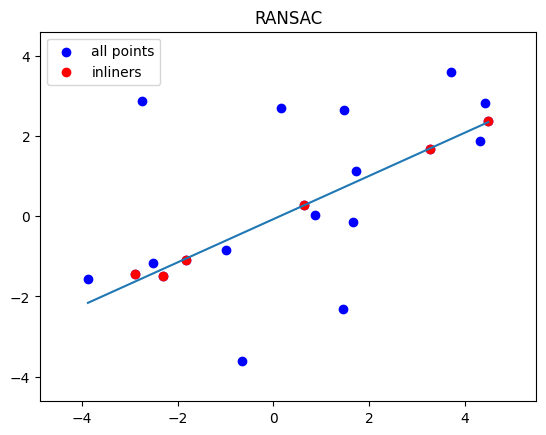

In [ ]:
# Ex 7.13
# Stopping criteria


def ransac(points, iters, tau):
    """
    Args:
        points : nx2, set of points
        iters : number of iterations
        tau : threshold for inliners

    Returns:
        best_line : equation of line in homogenous coordinates
        best_inliners : ax2, set of inliner points
    """
    p = 0.99  # probability of at least one sample is free from outliers
    best_inliners = None
    best_consensus = 0
    for i in range(iters):
        sample = sample_points(points)
        l = fit_line(sample[:, 0], sample[:, 1])
        consensus_ = consensus(l, points, tau)
        if consensus_ > best_consensus:
            best_inliners, _ = find_inliners_outliers(l, points, tau)
            best_consensus = consensus_
        # Stopping criteria
        e_est = 1 - best_consensus / points.shape[1]
        N_est = np.log(1 - p) / np.log(1 - (1 - e_est) ** 2)
        if i > N_est:
            print(f"Stopping early at iteration {i}")
            break
    # Fit new line
    best_line = pca_line(best_inliners)
    return best_line, best_inliners


points = test_points(10, 10)
max_iter = 100
tau = 0.2
best_l, best_inliners = ransac(points, max_iter, tau)
print(f"no. of best_inliners: {best_inliners.shape[1]}")
visualize_ransac(points, best_inliners, best_l)

# Ex 8

In [ ]:
import numpy as np
import cv2
import matplotlib as mpl
import matplotlib.pyplot as plt
# from cv02504.util_functions import (
#     gaussian_1D_kernel,
# )

from math import sqrt
from skimage import data
from skimage.feature import blob_dog
from skimage.color import rgb2gray

In [ ]:
cv2.__version__

'4.6.0'

## Building a BLOB detector that uses Difference-of-Gaussians

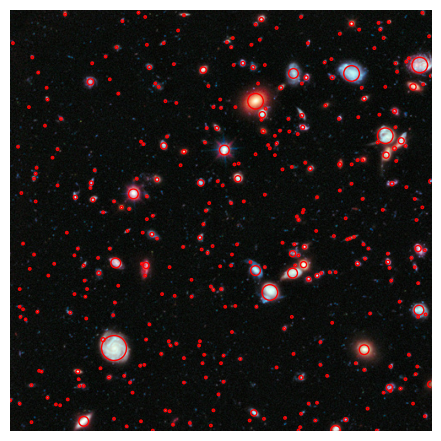

In [ ]:
# Example taken from
# https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_blob.html

image = data.hubble_deep_field()[0:500, 0:500]
image_gray = rgb2gray(image)

blobs_dog = blob_dog(image_gray, max_sigma=30, threshold=0.1)
blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)  # Compute radii in the 3rd column

plt.figure()
plt.imshow(image, cmap="gray")
for blob in blobs_dog:
    y, x, r = blob
    c = plt.Circle((x, y), r, color="red", linewidth=1, fill=False)
    plt.gca().add_patch(c)
plt.tight_layout()
plt.axis("off")
plt.show()

(660, 1066)


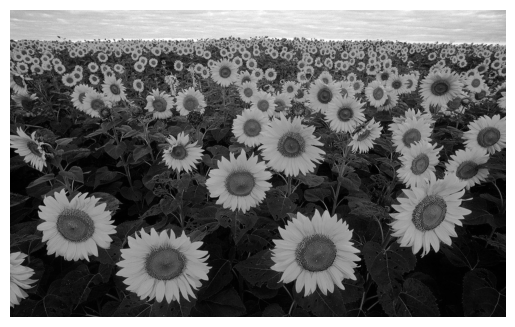

In [ ]:
im = cv2.imread("media/sunflowers.jpg").astype(float).mean(2) / 255

plt.imshow(im, cmap="gray")
plt.axis("off")
print(im.shape)

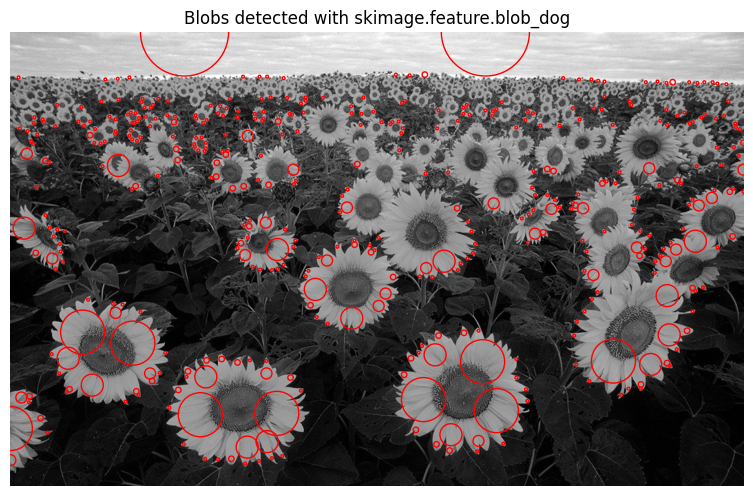

In [ ]:
# Using skimage.feature.blob_dog to detect blobs
blobs_dog = blob_dog(
    im, min_sigma=2, max_sigma=128, sigma_ratio=2, threshold=0.1
)

plt.figure()
plt.imshow(im, cmap="gray")
for blob in blobs_dog:
    y, x, r = blob
    c = plt.Circle((x, y), r, color="red", linewidth=1, fill=False)
    plt.gca().add_patch(c)
plt.tight_layout()
plt.axis("off")
plt.title("Blobs detected with skimage.feature.blob_dog")
plt.show()

In [ ]:
def gaussian_1D_kernel(sigma):
    """
    Returns the 1D Gaussian kernel.

    Args:
        sigma : width of Gaussian kernel

    Returns:
        g : 1D Gaussian kernel
        gd : 1D Gaussian kernel derivative
    """
    if sigma == 0:
        return [1], [0]
    rule = 5
    x = np.arange(-rule * sigma, rule * sigma + 1)
    g = np.exp(-(x**2) / (2 * sigma**2))
    g = g / g.sum()  # normalize
    gd = -x / (sigma**2) * g
    return g, gd

In [ ]:
# Ex 8.1
def scale_spaced(im, sigma, n):
    """
    Naive implementation of the scale space pyramid with no downsampling.

    Args:
        im : input image
        sigma : standard deviation of the Gaussian kernel
        n : number of scales

    Returns:
        im_scales : list containing the scale space pyramid of the input image
        scales : list containing the scales used in the pyramid
    """
    scales = [sigma * 2**i for i in range(n)]  # ratio = 2
    im_scales = []
    im_scale = im
    for scale in scales:
        # Apply Gaussian filter on the previously scaled image
        g, _ = gaussian_1D_kernel(scale)
        im_scale = cv2.sepFilter2D(
            src=im_scale, ddepth=-1, kernelX=g, kernelY=g
        )
        im_scales.append(im_scale)
    return im_scales, scales

im shape: (660, 1066)
scales: [2, 4, 8, 16, 32, 64, 128]
[array([[0.7087512 , 0.70855557, 0.70792362, ..., 0.72345681, 0.72209042,
        0.72155834],
       [0.71068443, 0.71051924, 0.70997868, ..., 0.72109907, 0.71987601,
        0.7194124 ],
       [0.71524327, 0.71517999, 0.71493566, ..., 0.71542251, 0.71458837,
        0.71430716],
       ...,
       [0.05211018, 0.05126105, 0.04871635, ..., 0.03580504, 0.03615633,
        0.03629273],
       [0.05158151, 0.05060896, 0.04771883, ..., 0.03619607, 0.03660521,
        0.0367729 ],
       [0.05136104, 0.05033828, 0.04731158, ..., 0.03634964, 0.03677805,
        0.03695683]]), array([[0.7146587 , 0.71451645, 0.71409154, ..., 0.7190999 , 0.71870325,
        0.71856918],
       [0.71470707, 0.71456728, 0.71414948, ..., 0.71934393, 0.71894789,
        0.71881402],
       [0.71481036, 0.71467775, 0.71428077, ..., 0.72012387, 0.7197292 ,
        0.71959577],
       ...,
       [0.050321  , 0.0503631 , 0.05050141, ..., 0.03559773, 0.0355403

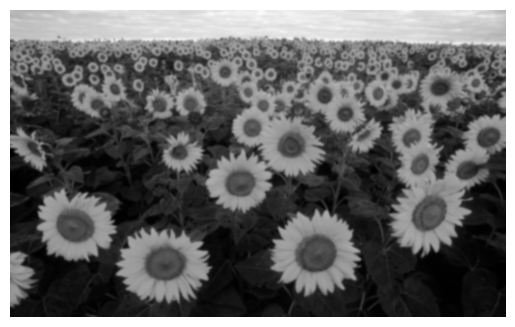

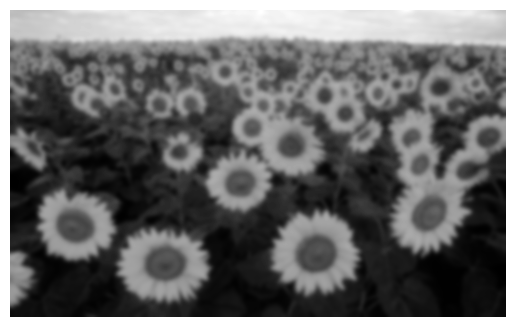

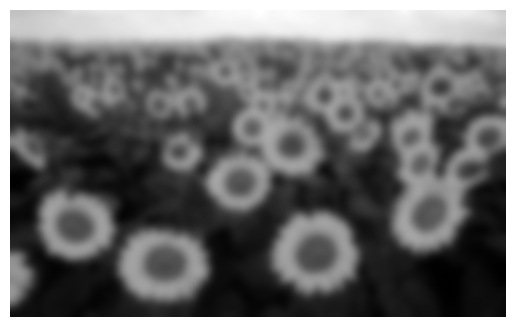

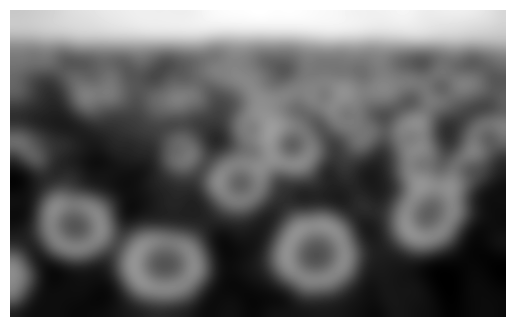

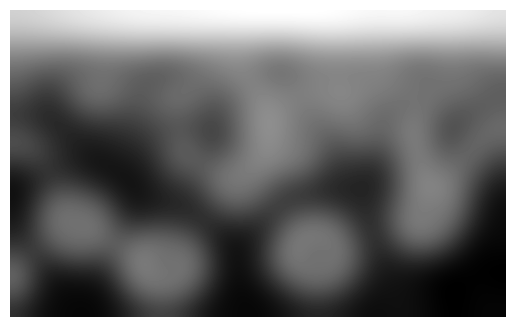

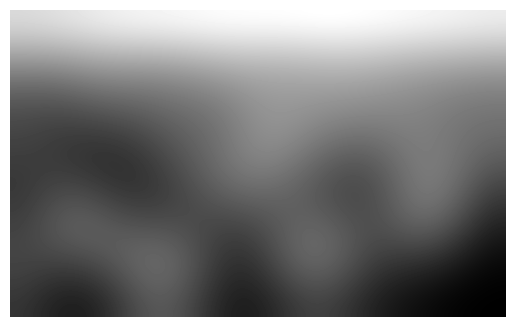

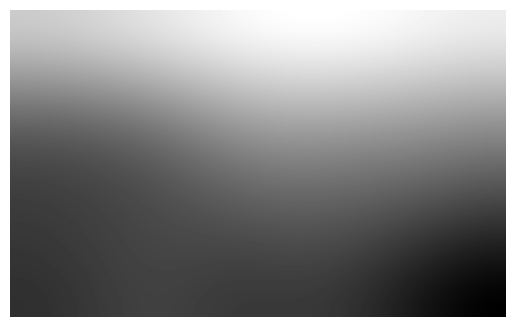

In [ ]:
sigma = 2
n_scales = 7
im_scales, scales = scale_spaced(im, sigma, n_scales)

# Check images in pyramid are exactly the same as the original image
print(f"im shape: {im_scales[0].shape}")
print(f"scales: {scales}")
print(im_scales)

# Visualize images to check for progressive blur
for i, im_scale in enumerate(im_scales):
    plt.imshow(im_scale, cmap="gray")
    plt.axis("off")
    plt.show()
plt.show()

In [ ]:
# Ex 8.2
def difference_of_gaussians(im, sigma, n):
    """
    Implementation of the difference of Gaussians.

    Args:
        im : input image
        sigma : standard deviation of the Gaussian kernel
        n : number of scales

    Returns:
        DoG : list of scale space DoGs of im
        scales : list containing the scales used in the pyramid
    """
    im_scales, scales = scale_spaced(im, sigma, n)
    DoG = []
    for i in range(1, n):
        diff = im_scales[i] - im_scales[i - 1]
        DoG.append(diff)
    return DoG, scales

In [ ]:
sigma = 2
n_scales = 7
DoG, scales = difference_of_gaussians(im, sigma, n_scales)

# Check images in pyramid are exactly the same as the original image
print(f"No. of DoG images: {len(DoG)}")
print(f"im shape: {DoG[0].shape}")
print(DoG)

No. of DoG images: 6
im shape: (660, 1066)
[array([[ 0.0059075 ,  0.00596089,  0.00616792, ..., -0.00435692,
        -0.00338718, -0.00298916],
       [ 0.00402264,  0.00404804,  0.0041708 , ..., -0.00175515,
        -0.00092812, -0.00059838],
       [-0.00043291, -0.00050224, -0.00065489, ...,  0.00470136,
         0.00514083,  0.0052886 ],
       ...,
       [-0.00178919, -0.00089795,  0.00178506, ..., -0.00020731,
        -0.00061596, -0.00076987],
       [-0.00164213, -0.00063083,  0.00238786, ..., -0.00059324,
        -0.00106822, -0.00125629],
       [-0.00155511, -0.00049482,  0.00265691, ..., -0.00074288,
        -0.00123992, -0.00144001]]), array([[-0.0054719 , -0.00535346, -0.00499924, ...,  0.02464145,
         0.02477435,  0.0248203 ],
       [-0.0054965 , -0.00538033, -0.00503267, ...,  0.02458426,
         0.02471621,  0.02476186],
       [-0.00552652, -0.00541696, -0.00508847, ...,  0.02435891,
         0.02448853,  0.02453343],
       ...,
       [ 0.01133556,  0.011297

test shape2 (1174,)
test shape2 (197,)
test shape2 (84,)
test shape2 (41,)
test shape2 (11,)
test shape2 (0,)
(6, 660, 1066)


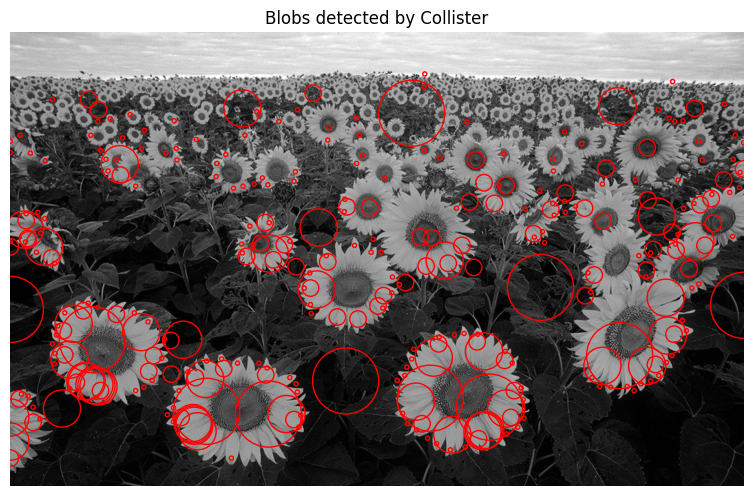

In [ ]:
# From Collister's code
def detectBlobs(im, sigma, n, tau):
    DoG, scales = difference_of_gaussians(im, sigma, n)
    DoG = np.array(DoG)
    DoG = np.where(abs(DoG) >= tau, DoG, 0)
    results_list = []
    MaxDoG = [cv2.dilate(dog, np.ones((3, 3))) for dog in DoG]

    for index in range(DoG.shape[0]):
        DoG_current = DoG[index]
        index_above = index + 1
        index_below = index - 1

        DoG_current_MAX = cv2.dilate(abs(DoG_current), np.ones((3, 3)))
        try:
            DoG_above_MAX = MaxDoG[index_above]
        except IndexError:
            DoG_above_MAX = np.zeros(DoG.shape)
        try:
            DoG_below_MAX = MaxDoG[index_below]
        except IndexError:
            DoG_below_MAX = np.zeros(DoG.shape)

        x = np.nonzero(DoG_current)[0]
        y = np.nonzero(DoG_current)[1]
        test = np.zeros(DoG_current.shape)
        for a in range(len(x)):
            xi = x[a]
            yi = y[a]
            try:
                # check all surrounding 8 squares and top and bottom layers
                if (
                    abs(DoG_current[xi, yi]) == abs(DoG_current_MAX[xi, yi])
                    and abs(DoG_current[xi, yi]) > abs(DoG_above_MAX[xi, yi])
                    and abs(DoG_current[xi, yi]) > abs(DoG_below_MAX[xi, yi])
                ):
                    test[xi, yi] = 1
            except:
                continue  # there is some bug here but i have given up
        test_num = test[np.where(test > 0)]
        print("test shape2", test_num.shape)
        results_list.append(test)
    results_list = np.array(results_list)
    print(results_list.shape)
    return results_list


blobs = detectBlobs(im, 2, 7, 0.1)


im_circle = cv2.imread("media/sunflowers.jpg")
im_circle = cv2.cvtColor(im_circle, cv2.COLOR_BGR2GRAY)

plt.figure()
plt.imshow(im, cmap="gray")
for i in range(len(blobs)):
    x = np.nonzero(blobs[i])[0]
    y = np.nonzero(blobs[i])[1]
    radius = 3 * (i**2)
    for a in range(len(x)):
        c = plt.Circle(
            (y[a], x[a]), radius, color="red", linewidth=1, fill=False
        )
        plt.gca().add_patch(c)
plt.tight_layout()
plt.axis("off")
plt.title("Blobs detected by Collister")
plt.show()

In [ ]:
def visualize_blobs(blobs, im):
    """
    Args:
        blobs : list of detected blobs in the format (x, y, scale)
        im : BGR input image
    """
    gray_img = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    # To draw colored shapes on a gray img
    bgr_img = cv2.cvtColor(gray_img, cv2.COLOR_GRAY2BGR)
    for x, y, scale in blobs:
        cv2.circle(
            bgr_img, (y, x), radius=int(scale), color=(255, 0, 0), thickness=2
        )
    plt.axis("off")
    plt.imshow(bgr_img)
    plt.show()

No. of blobs detected in DoG 0: 1174
No. of blobs detected in DoG 1: 177
No. of blobs detected in DoG 2: 75
No. of blobs detected in DoG 3: 41
No. of blobs detected in DoG 4: 11
No. of blobs detected in DoG 5: 2
Total no. of blobs detected: 1480


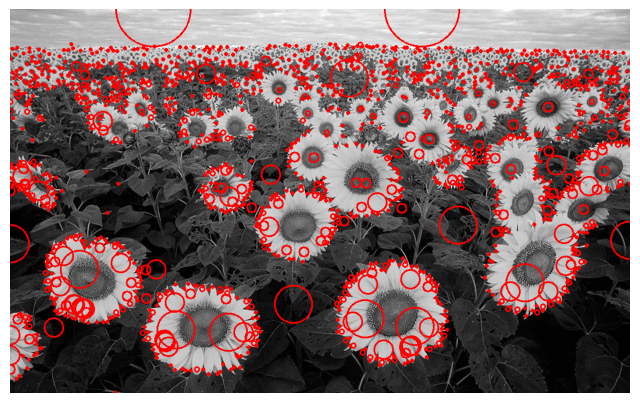

In [ ]:
# Ex 8.3
def detect_blobs(im, sigma, n, tau):
    """
    Implementation of the blob detector.

    Args:
        im : input image
        sigma : standard deviation of the Gaussian kernel
        n : number of scales
        tau : threshold for blob detection

    Returns:
        blobs : list of detected blobs in the format (x, y, scale)
    """
    DoG, scales = difference_of_gaussians(im, sigma, n)
    DoG = np.array(DoG)

    # Obtain max value in a 3x3 neighborhood of each pixel in DoG
    MaxDoG = [cv2.dilate(abs(dog), np.ones((3, 3))) for dog in DoG]

    # Thresholding & non-max suppression
    blobs = []
    prev_blobs = 0
    for i in range(len(DoG)):  # for each DoG
        if i == 0:
            prev_MaxDoG = np.zeros(DoG[0].shape)
            next_MaxDoG = MaxDoG[i + 1]
        elif i == len(DoG) - 1:
            prev_MaxDoG = MaxDoG[i - 1]
            next_MaxDoG = np.zeros(DoG[0].shape)
        else:
            prev_MaxDoG = MaxDoG[i - 1]
            next_MaxDoG = MaxDoG[i + 1]

        for j in range(im.shape[0]):  # for each row
            for k in range(im.shape[1]):  # for each column
                # take abs() to find max and min
                if (
                    abs(DoG[i][j, k]) > tau  # thresholding
                    and abs(DoG[i][j, k])
                    == MaxDoG[i][j, k]  # max in current DoG
                    and abs(DoG[i][j, k])
                    > prev_MaxDoG[j, k]  # max in previous DoG
                    and abs(DoG[i][j, k]) > next_MaxDoG[j, k]  # max in next DoG
                ):
                    blobs.append((j, k, scales[i]))
        # Calculate how many new blobs detected in this DoG
        print(f"No. of blobs detected in DoG {i}: {len(blobs)-prev_blobs}")
        prev_blobs = len(blobs)
    return blobs


sigma = 2
n_scales = 7
tau = 0.1
blobs = detect_blobs(im, sigma, n_scales, tau)
print(f"Total no. of blobs detected: {len(blobs)}")
visualize_blobs(blobs, cv2.imread("media/sunflowers.jpg"))

## Using SIFT to match features

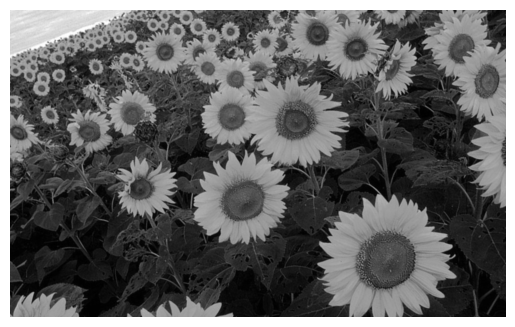

In [ ]:
# Ex 8.4
def transform_im(im: np.ndarray, theta: float, s: float):
    """
    Rotate an image by theta degrees and scale by s.

    Args:
        im : input image
        theta : angle of rotation
        s : scaling factor

    Returns:
        r_im : rotated and scaled image
    """
    rows, cols = im.shape
    M = cv2.getRotationMatrix2D((cols / 2, rows / 2), theta, s)
    r_im = cv2.warpAffine(im, M, (cols, rows))
    return r_im


r_im = transform_im(im, 20, 1.5)
plt.imshow(r_im, cmap="gray")
plt.axis("off")
plt.show()

In [ ]:
# Ex 8.5
# Use SIFT detector to detect features in both original and transformed image.

# Read images as uint8
im_int = cv2.imread("media/sunflowers.jpg").mean(2).astype(np.uint8)
r_im_int = transform_im(im_int, 20, 1.5)

# SIFT detector
sift = cv2.SIFT_create()
kp1 = sift.detect(im_int, None)
kp2 = sift.detect(r_im_int, None)

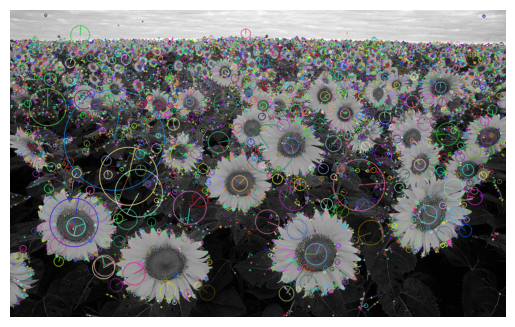

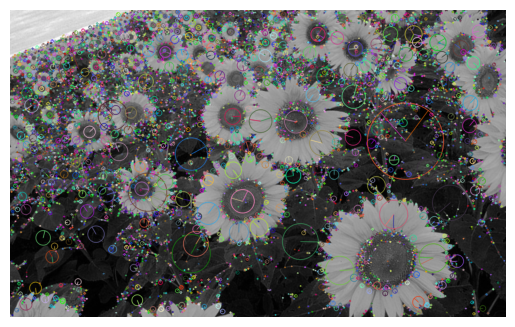

In [ ]:
# Marking the keypoint on the image using circles
img = cv2.drawKeypoints(
    im_int, kp1, im_int, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

r_img = cv2.drawKeypoints(
    r_im_int, kp2, r_im_int, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

# Plot features in both images.
plt.imshow(img)
plt.axis("off")
plt.show()
plt.imshow(r_img)
plt.axis("off")
plt.show()

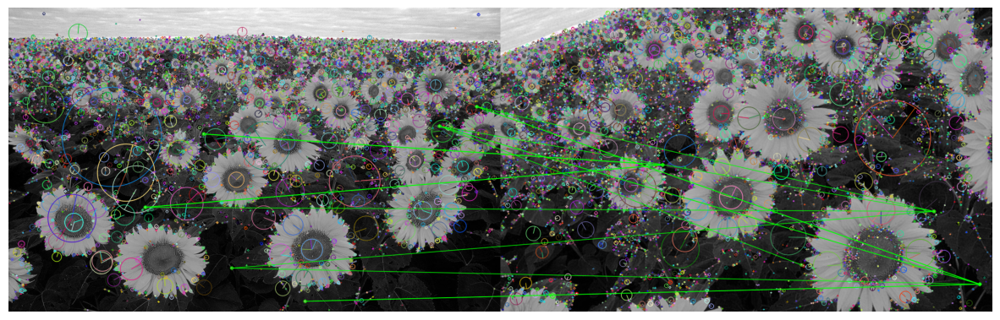

('good features',
 [[< cv2.DMatch 0000019CFDA911D0>],
  [< cv2.DMatch 0000019CFDA91290>],
  [< cv2.DMatch 0000019CFDA90FF0>],
  [< cv2.DMatch 0000019CFDA91610>],
  [< cv2.DMatch 0000019CFDA91270>],
  [< cv2.DMatch 0000019CFDA910D0>],
  [< cv2.DMatch 0000019CFDA92630>],
  [< cv2.DMatch 0000019CFDA90E10>],
  [< cv2.DMatch 0000019CFDA925B0>]])

In [ ]:
def BFMatching(img1, img2, plot=False):
    """
    Modified from https://www.geeksforgeeks.org/python-opencv-bfmatcher-function/
    """
    # Find the keypoints and descriptors
    n_feats = 10
    sift = cv2.SIFT_create(n_feats)
    # sift = cv2.ORB_create(n_feats)
    kpnt1, des1 = sift.detectAndCompute(img1, None)
    kpnt2, des2 = sift.detectAndCompute(img2, None)

    # BFMatcher with default parameters
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)

    # Apply ratio test
    good = []
    matched_image = cv2.drawMatchesKnn(
        img1,
        kpnt1,
        img2,
        kpnt2,
        matches,
        None,
        matchColor=(0, 255, 0),
        matchesMask=None,
        singlePointColor=(255, 0, 0),
        flags=0,
    )

    # Creating a criteria for the good matches
    for m, n in matches:
        if m.distance < 0.98 * n.distance:
            good.append([m])

    # Display matched image
    if plot:
        mpl.rcParams["figure.figsize"] = [15, 10]
        plt.imshow(matched_image)
        plt.axis("off")
        plt.show()
        mpl.rcParams["figure.figsize"] = [8, 6]

    return ("good features", good)  # returning ggod features


BFMatching(img, r_img, plot=True)
# This doesnt look correct

# Ex 9

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.spatial.transform import Rotation
from cv02504.util_functions import (
    PiInv,
    Pi,
    R,
    camera_intrinsic,
    fundamental_matrix,
)

np.random.seed(8)  # for reproducibility

In [ ]:
# From week 3 exercise. But I don't think this is needed.
K = camera_intrinsic(1000, (300, 200))
R1 = np.eye(3)
t1 = np.array([[0, 0, 0]]).T
R2 = R(0.7, -0.5, 0.8)
t2 = np.array([[0.2, 2, 1]]).T
R2 = Rotation.from_euler("xyz", [0.7, -0.5, 0.8]).as_matrix()

Ftrue = fundamental_matrix(K, R1, t1, K, R2, t2)
print(f"Ftrue: {Ftrue}")

F_true: [[ 3.29311881e-07  8.19396327e-07  1.79162592e-03]
 [ 5.15532551e-07 -8.76915984e-07  9.31426656e-05]
 [-1.29882755e-03  1.51951700e-03 -1.10072682e+00]]


In [ ]:
data = np.load("media/Fest_test.npy", allow_pickle=True).item()
q1 = data["q1"]
q2 = data["q2"]
Ftrue_test = data["Ftrue"]
print(f"q1: {q1}")  # (3, 8)
print(f"q2: {q2}")  # (3, 8)
print(f"Ftrue_test: {Ftrue_test}")

q1: [[192.80308677 383.84844629 552.40550165 395.55690526 416.17883753
  366.71606701 649.12832188 437.85457401]
 [482.655306   522.55261707 373.4083753  550.57520093 157.95394133
  379.58268042 141.20188192 571.00584606]
 [  1.           1.           1.           1.           1.
    1.           1.           1.        ]]
q2: [[ 77.42041221 254.60721249 469.08032639 278.08133782 308.0810652
  270.86822192 508.91666875 288.72429284]
 [479.74166846 521.16039433 373.38678026 549.34478578 157.66285399
  378.83939131 138.78418921 569.99677028]
 [  1.           1.           1.           1.           1.
    1.           1.           1.        ]]
Ftrue_test: [[ 6.67972386e-12 -7.85049967e-10  1.17921973e-07]
 [-9.75936980e-10 -4.86806510e-12  3.28699196e-05]
 [ 4.23506610e-07 -3.21704080e-05 -2.12002228e-04]]


In [ ]:
# Ex 9.1
def Fest_8point(q1, q2):
    """
    Estimate the fundamental matrix using the 8-point linear algorithm.

    Args:
        q1 (np.ndarray): 2D points in image 1, shape (2, 8).
        q2 (np.ndarray): 2D points in image 2, shape (2, 8).

    Returns:
        F (np.ndarray): The estimated fundamental matrix, shape (3, 3).
    """
    # Construct B vector
    B = np.zeros((q1.shape[1], 9))
    for i in range(q1.shape[1]):
        x1, y1 = q1[:, i]
        x2, y2 = q2[:, i]
        Bi = np.array([x1 * x2, y1 * x2, x2, x1 * y2, y1 * y2, y2, x1, y1, 1])
        B[i] = Bi

    # Solve for F
    U, S, V = np.linalg.svd(B)
    F = V[-1].reshape(3, 3)

    return F


Ftrue_normalized = Ftrue / Ftrue[-1, -1]
print(f"Ftrue: {Ftrue}")
print(f"Ftrue_normalized: {Ftrue_normalized}")

q1, q2 = Pi(q1), Pi(q2)  # (3,8) -> (2,8)
F_est = Fest_8point(q1, q2)
print(f"\nF_est: {F_est}")
print(f"F_est norm: {F_est / F_est[-1, -1]}")

Ftrue: [[ 6.67972386e-12 -7.85049967e-10  1.17921973e-07]
 [-9.75936980e-10 -4.86806510e-12  3.28699196e-05]
 [ 4.23506610e-07 -3.21704080e-05 -2.12002228e-04]]
Ftrue_normalized: [[-3.15078002e-08  3.70302696e-06 -5.56229877e-04]
 [ 4.60342794e-06  2.29623299e-08 -1.55045161e-01]
 [-1.99765169e-03  1.51745612e-01  1.00000000e+00]]

F_est: [[-3.07914555e-08  3.61883689e-06 -5.43583727e-04]
 [ 4.49876682e-06  2.24402705e-08 -1.51520136e-01]
 [-1.95223414e-03  1.48295604e-01  9.77264527e-01]]
F_est norm: [[-3.15078003e-08  3.70302696e-06 -5.56229876e-04]
 [ 4.60342794e-06  2.29623299e-08 -1.55045161e-01]
 [-1.99765169e-03  1.51745612e-01  1.00000000e+00]]


In [ ]:
# Ex 9.2
data = np.load("media/TwoImageData.npy", allow_pickle=True).item()
print(data.keys())
im1 = data["im1"]
im2 = data["im2"]
R1 = data["R1"]
t1 = data["t1"]
R2 = data["R2"]
t2 = data["t2"]
K = data["K"]

dict_keys(['im1', 'im2', 'R1', 'R2', 't1', 't2', 'K'])


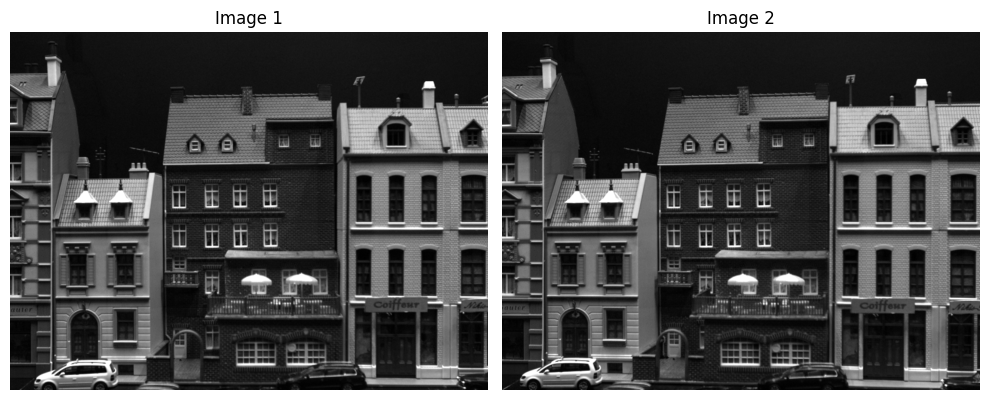

In [ ]:
# Plot raw images for reference
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(im1, cmap="gray")
axs[0].axis("off")
axs[0].set_title("im1")
axs[1].imshow(im2, cmap="gray")
axs[1].axis("off")
axs[1].set_title("im2")
plt.tight_layout()
plt.show()

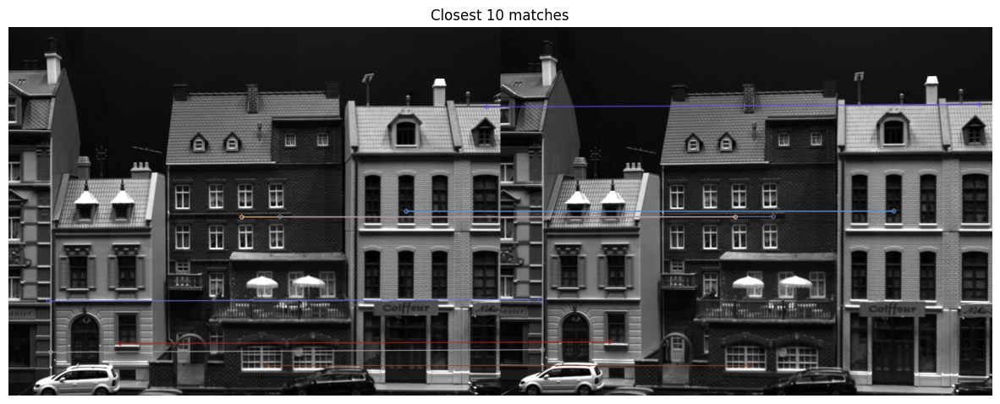

Number of matches: 2086


In [ ]:
def find_features(im1, im2, plot=False):
    """
    Find matching features between two images.

    Args:
        im1 (np.ndarray): The first image.
        im2 (np.ndarray): The second image.

    Returns:
        matches (list): Matching features (cv2.DMatch objects).
        kp1 (list): Keypoints in the first image.
        kp2 (list): Keypoints in the second image.
    """
    # Initiate SIFT detector
    sift = cv2.SIFT_create()

    # Find the keypoints and descriptors with SIFT
    kp1, des1 = sift.detectAndCompute(im1, None)
    kp2, des2 = sift.detectAndCompute(im2, None)

    # Create BFMatcher object
    bf = cv2.BFMatcher(crossCheck=True)

    # Match descriptors
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)  # ascending

    # Draw first 10 matches.
    if plot:
        img3 = cv2.drawMatches(
            im1,
            kp1,
            im2,
            kp2,
            matches[:10],
            None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
        )
        mpl.rcParams["figure.figsize"] = [15, 10]
        plt.imshow(img3)
        plt.axis("off")
        plt.title("Closest 10 matches")
        plt.show()
        mpl.rcParams["figure.figsize"] = [8, 6]

    return matches, kp1, kp2


# Feature matching is correct when the connecting lines are mostly parallel.
matches, kp1, kp2 = find_features(im1, im2, plot=True)
print(f"Number of matches: {len(matches)}")

In [ ]:
def sampsons_distance(F, p1, p2):
    """
    Compute the Sampson distance for the given fundamental matrix and point correspondences.

    Args:
        F (np.array): The fundamental matrix, shape (3, 3).
        p1 (np.array): 2D points in image 1, shape (2, N).
        p2 (np.array): 2D points in image 2, shape (2, N).

    Returns:
        dist (np.array): The Sampson distance for each point, shape (N,).
    """
    # if p1.shape[0] == 3 and p2.shape[0] == 3:
    #     # Normalize points
    #     p1 = p1[:2] / p1[2]
    #     p2 = p2[:2] / p2[2]
    # if p1.shape[0] != 2 or p2.shape[0] != 2:
    #     raise ValueError("p1 and p2 must have shape (2, N).")

    # Make homogeneous to multiply with F
    p1 = PiInv(p1)
    p2 = PiInv(p2)
    distances = np.zeros((p1.shape[1], 1))

    # For each pair of points
    for i in range(p1.shape[1]):
        p1i, p2i = p1[:, i], p2[:, i]
        num = (p2i.T @ F @ p1i) ** 2
        denom = (
            (p2i.T @ F[0]) ** 2
            + (p2i.T @ F[1]) ** 2
            + (F @ p1i)[0] ** 2
            + (F @ p1i)[1] ** 2
        )
        dist = num / denom
        distances[i, :] = dist
    return distances

In [ ]:
# One iteration of RANSAC

# Find matches and prepare samples
matches, kp1, kp2 = find_features(im1, im2, plot=False)
match_samples = np.random.choice(matches, 8, replace=False)
im1_matches = np.array(
    [(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1]) for m in matches]
)  # (N, 2)
im2_matches = np.array(
    [(kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches]
)  # (N, 2)

# Extract coordinates
matched_points = np.array(
    [
        (
            kp1[m.queryIdx].pt[0],
            kp1[m.queryIdx].pt[1],
            kp2[m.trainIdx].pt[0],
            kp2[m.trainIdx].pt[1],
        )
        for m in match_samples
    ]
)
print(f"matched_points: {matched_points}")
im1_samples = np.array(
    [(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1]) for m in match_samples]
)
im2_samples = np.array(
    [(kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in match_samples]
)
print(f"im1_samples: {im1_samples}")
print(f"im2_samples: {im2_samples}")

# RANSAC segment
F = Fest_8point(im1_samples.T, im2_samples.T)
print(f"F_est from 8-point: {F}")
dist_samp = sampsons_distance(F, im1_matches.T, im2_matches.T)

# Inliers
threshold = 3.84 * 3**2
inliers = [idx for idx, dist in enumerate(dist_samp) if dist < threshold]
inliers = np.array([im1_matches[inliers], im2_matches[inliers]])
print(f"inliers.shape: {inliers.shape}")

matched_points: [[381.89505005 264.23019409 384.85852051 264.07196045]
 [463.12182617 563.93243408 378.74328613 425.57046509]
 [404.82525635 533.00036621 475.30181885 533.76080322]
 [ 61.03951645 301.08050537  61.03593445 301.09988403]
 [128.21258545 219.87739563 134.46789551 221.01002502]
 [230.66297913 237.17408752 230.15209961 236.72549438]
 [501.72912598 526.84124756 489.00836182 527.91149902]
 [  2.82893395 264.29119873   5.31679392 265.1960144 ]]
im1_samples: [[381.89505005 264.23019409]
 [463.12182617 563.93243408]
 [404.82525635 533.00036621]
 [ 61.03951645 301.08050537]
 [128.21258545 219.87739563]
 [230.66297913 237.17408752]
 [501.72912598 526.84124756]
 [  2.82893395 264.29119873]]
im2_samples: [[384.85852051 264.07196045]
 [378.74328613 425.57046509]
 [475.30181885 533.76080322]
 [ 61.03593445 301.09988403]
 [134.46789551 221.01002502]
 [230.15209961 236.72549438]
 [489.00836182 527.91149902]
 [  5.31679392 265.1960144 ]]
F_est from 8-point: [[ 1.94212349e-06 -1.15701580e-

In [ ]:
def ransac_fundamental_matrix(im1, im2, threshold, iters=1000):
    """
    Estimate the fundamental matrix using RANSAC.

    Args:
        q1 (np.ndarray): 2D points in image 1, shape (2, N).
        q2 (np.ndarray): 2D points in image 2, shape (2, N).
        threshold (float): The threshold used for the RANSAC algorithm.
        iters (int): The number of iterations to run the RANSAC algorithm.

    Returns:
        F (np.ndarray): The estimated fundamental matrix, shape (3, 3).
        inliers (np.ndarray): The inliers used to estimate F, shape (N,).
    """
    matches, kp1, kp2 = find_features(im1, im2)
    im1_matches = np.array(
        [(kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1]) for m in matches]
    )  # (N, 2)
    im2_matches = np.array(
        [(kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1]) for m in matches]
    )  # (N, 2)

    best_consensus = 0
    best_inliers = None
    best_F = None

    for i in range(iters):
        # 1. sample 8 random matches
        # 2. use Fest_8point to estimate F matrix from the 8 matches
        # 3. compute sampson's distance
        # 4. find inliers if sampson's distance < threshold
        # 5. update best F and inliers
        # 6. iterate

        # Sample 8 random matches
        match_samples = np.random.choice(matches, 8, replace=False)

        # Extract x-y coordinates of samples
        im1_samples = np.array(
            [
                (kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1])
                for m in match_samples
            ]
        )  # (8, 2)
        im2_samples = np.array(
            [
                (kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1])
                for m in match_samples
            ]
        )  # (8, 2)

        F = Fest_8point(im1_samples.T, im2_samples.T)  # requires (2, 8) input

        # Calculate the dist for all matches
        dist_samp = sampsons_distance(F, im1_matches.T, im2_matches.T)
        inliers = [
            idx for idx, dist in enumerate(dist_samp) if dist < threshold
        ]
        inliers = np.array([im1_matches[inliers], im2_matches[inliers]])
        # inliers shape : (2, M, 2)

        consensus = inliers.shape[1]
        # Update best F and inliers
        if consensus > best_consensus:
            best_inliers = inliers
            best_consensus = consensus
            best_F = F

    if best_F is None:
        raise ValueError("RANSAC did not find any inliers.")

    # Refit the model using all inliers
    print(f"Best consesus of {best_consensus} out of {len(matches)} matches.")
    best_F = Fest_8point(best_inliers[0].T, best_inliers[1].T)

    return best_F, best_inliers


iters = 200
threshold = 3.84 * 3**2  # 34.56
best_F, best_inliers = ransac_fundamental_matrix(im1, im2, threshold, iters)

Best consesus of 0 out of 2086 matches.


In [ ]:
print("Ftrue: ", Ftrue)
print("best_F: ", best_F)

Ftrue:  [[ 6.67972386e-12 -7.85049967e-10  1.17921973e-07]
 [-9.75936980e-10 -4.86806510e-12  3.28699196e-05]
 [ 4.23506610e-07 -3.21704080e-05 -2.12002228e-04]]
best_F:  [[ 7.44481870e-07  3.17331002e-06 -1.58320501e-03]
 [ 1.58467038e-06  4.77919646e-07 -1.57887115e-02]
 [-1.21438202e-03  1.35996091e-02  9.99780869e-01]]


In [ ]:
# Evaluate the estimated F matrix
(best_F * Ftrue).sum() / (np.linalg.norm(best_F) * np.linalg.norm(Ftrue))

# what does this measure?

-0.981462679227684

The code measures how similar are the F and Ftrue. If $F$ and $F_t$ are similar up to a scale, the metric should be close to $\pm 1$

$F * F_t$ is an element-wise dot product.

$$
\begin{align*}
(F*F_t).sum() &= F_{t,11} \cdot F_{t,11} + F_{12}\cdot F_{t,12} + F_{t,13} \cdot F_{t,13} \\
&  F_{t,21} \cdot F_{t,21} + ... \\
np.linalg.norm(F) &= \sqrt{F_{11}^2 + F_{12}^2 + F_{13}^2 + F_{21}^2 ...}
\end{align*}
$$

# Ex 10

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from cv02504.util_functions import (
    PiInv,
    Pi,
    hest,
    find_features,
)

np.random.seed(8)  # for reproducibility

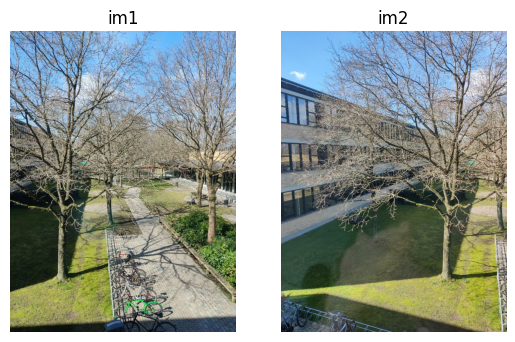

In [ ]:
# Ex 10.1
# Load images

im1 = cv2.imread("media/w10_im1.jpg")
im2 = cv2.imread("media/w10_im2.jpg")

fig, ax = plt.subplots(1, 2)
ax[0].imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB))
ax[0].set_title("im1")
ax[0].axis("off")
ax[1].imshow(cv2.cvtColor(im2, cv2.COLOR_BGR2RGB))
ax[1].set_title("im2")
ax[1].axis("off")
plt.show()

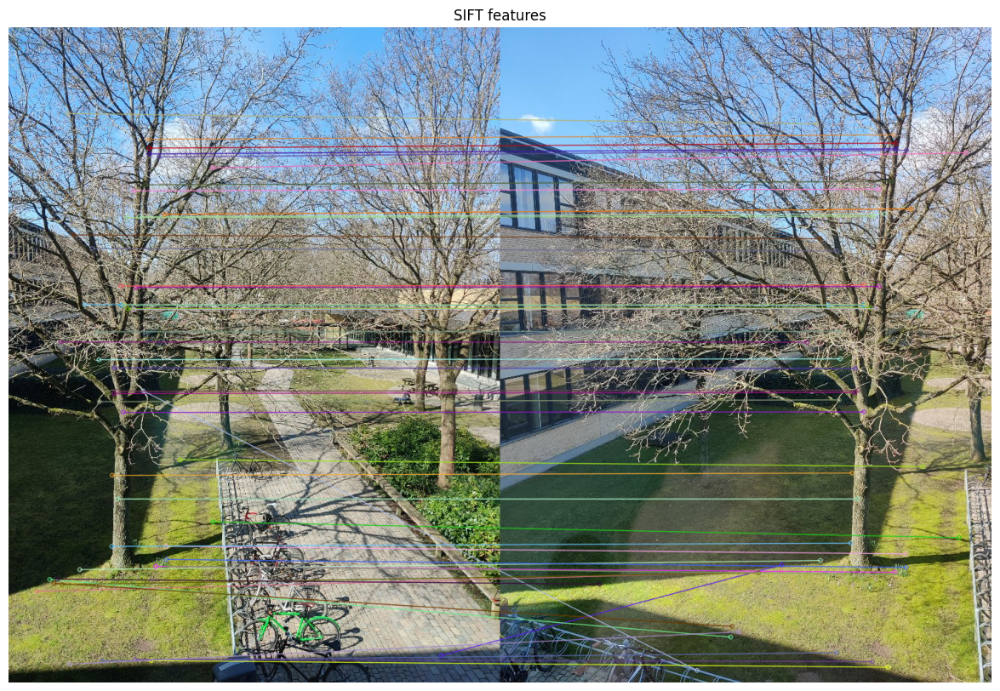

In [ ]:
matches, kp1, kp2 = find_features(im1, im2)

img3 = cv2.drawMatches(
    im1,
    kp1,
    im2,
    kp2,
    matches[:50],
    None,
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)
mpl.rcParams["figure.figsize"] = [15, 10]
plt.imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("SIFT features")
plt.show()
mpl.rcParams["figure.figsize"] = [8, 6]

In [ ]:
def Hest_dist(H, q1, q2):
    """
    Approximate distance of observed points to a homography matrix.

    Args:
        H: Homography matrix
        q1 (np.array): observed point in image 1, shape (N,2)
        q2 (np.array): observed point in image 2, shape (N,2)

    Returns:
        dist_approx (np.array): Approximate distance
    """
    p1 = PiInv(q1)
    p2 = PiInv(q2)
    distances = np.zeros((p1.shape[1], 1))

    # For each pair of points
    for i in range(p1.shape[1]):
        p1i, p2i = p1[:, i], p2[:, i]
        q1i, q2i = q1[:, i], q2[:, i]
        temp1 = (q1i - Pi(H @ p2i)) ** 2
        temp1 = np.sqrt(np.sum(temp1))
        temp2 = (q2i - Pi(np.linalg.inv(H) @ p1i)) ** 2
        temp2 = np.sqrt(np.sum(temp2))
        distances[i] = temp1 + temp2
    return distances

In [ ]:
# Initiate SIFT detector
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(im1, None)
kp2, des2 = sift.detectAndCompute(im2, None)

In [ ]:
threshold = 3.84 * 3**2  # 34.56


bf = cv2.BFMatcher(crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)  # ascending

# Extract matched keypoints
im1_pts = np.float32([kp1[m.queryIdx].pt for m in matches])  # (N,2)
im2_pts = np.float32([kp2[m.trainIdx].pt for m in matches])  # (N,2)

# RANSAC
best_consensus = 0
best_inliers = None
best_H = None

# Randomly select 4 points
idx = np.random.choice(len(im1_pts), 4, replace=False)
q1 = im1_pts[idx]
q2 = im2_pts[idx]
print(f"q1.shape: {q1.shape}\nq2:\n{q2}")

# Estimate homography
H = hest(q1.T, q2.T)

# Calculate distance
distances = Hest_dist(H, im1_pts.T, im2_pts.T)
inliers = [
    [im1_pts[idx], im2_pts[idx]]
    for idx, dist in enumerate(distances)
    if dist < threshold
]
inliers = np.array(inliers)  # (M,2,2)
print(f"inliers: {inliers.shape}")
consensus = inliers.shape[0]
print(f"cons: {consensus}")

q1.shape: (4, 2)
q2:
[[491.8977   516.2788  ]
 [583.7414    76.64322 ]
 [295.9956   492.1125  ]
 [580.87805   96.649635]]
inliers: (4, 2, 2)
cons: 4


In [ ]:
def ransac_homography(im1, im2, threshold, iters=200, plot=False):
    """
    Estimate homography matrix using RANSAC.

    Args:
        im1 (np.array): Image 1
        im2 (np.array): Image 2
        threshold (float|int): Distance threshold for inliers
        iters (int): Number of iterations
        plot (bool): Visualize inlier matches

    Returns:
        best_H (np.array): Best homography matrix, shape (3,3)
        best_inliers (np.array): Inliers of best homography (M,2,2)
    """

    # Find features
    matches, kp1, kp2 = find_features(im1, im2)

    # Extract matched keypoints
    im1_pts = np.float32([kp1[m.queryIdx].pt for m in matches])  # n x 2
    im2_pts = np.float32([kp2[m.trainIdx].pt for m in matches])

    # RANSAC
    best_consensus = 0
    best_inliers = None
    best_H = None

    for i in range(iters):
        # Randomly select 4 points
        idx = np.random.choice(len(im1_pts), 4, replace=False)
        q1 = im1_pts[idx]
        q2 = im2_pts[idx]

        # Estimate homography
        H = hest(q1.T, q2.T)

        # Calculate distance
        distances = Hest_dist(H, im1_pts.T, im2_pts.T)
        inliers_idx = [
            idx for idx, dist in enumerate(distances) if dist < threshold
        ]
        inliers = np.array(
            [[im1_pts[idx], im2_pts[idx]] for idx in inliers_idx]
        )  # (M,2,2)
        consensus = inliers.shape[0]

        if consensus > best_consensus:
            best_inliers_idx = inliers_idx
            best_inliers = inliers
            best_consensus = consensus
            best_H = H

    if best_H is None:
        raise ValueError("RANSAC did not find any inliers.")

    # Refit homography to inliers
    print(f"Best consensus of {best_consensus} out of {len(im1_pts)} points.")
    best_H = hest(best_inliers[:, 0].T, best_inliers[:, 1].T)

    if plot:
        # Parallel lines should be expected
        plt.imshow(
            cv2.drawMatches(
                im1, kp1, im2, kp2, np.array(matches)[best_inliers_idx], None
            )
        )
        plt.axis("off")
        plt.show()

    return best_H, best_inliers


sigma = 3
threshold = 5.99 * sigma**2
best_H, best_inliers = ransac_homography(im1, im2, threshold, plot=True)
print(f"best_H:\n{best_H}")

In [ ]:
def estimate_homography_ransac(kp1, des1, kp2, des2, iters=200, plot=False):
    """
    Estimate homography matrix using RANSAC.

    Args:
        kp1 (list): Keypoints of image 1
        des1 (np.array): Descriptors of image 1
        kp2 (list): Keypoints of image 2
        des2 (np.array): Descriptors of image 2

    Returns:
        best_H (np.array): Best homography matrix, shape (3,3)
        best_inliers (np.array): Inliers of best homography (M,2,2)
    """

    bf = cv2.BFMatcher(crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)  # ascending

    # Extract matched keypoints
    im1_pts = np.float32([kp1[m.queryIdx].pt for m in matches])  # n x 2
    im2_pts = np.float32([kp2[m.trainIdx].pt for m in matches])

    # RANSAC
    best_consensus = 0
    best_inliers = None
    best_H = None

    for i in range(iters):
        # Randomly select 4 points
        idx = np.random.choice(len(im1_pts), 4, replace=False)
        q1 = im1_pts[idx]
        q2 = im2_pts[idx]

        # Estimate homography
        H = hest(q1.T, q2.T)

        # Calculate distance
        distances = Hest_dist(H, im1_pts.T, im2_pts.T)
        inliers_idx = [
            idx for idx, dist in enumerate(distances) if dist < threshold
        ]
        inliers = np.array(
            [[im1_pts[idx], im2_pts[idx]] for idx in inliers_idx]
        )  # (M,2,2)
        consensus = inliers.shape[0]

        if consensus > best_consensus:
            best_inliers_idx = inliers_idx
            best_inliers = inliers
            best_consensus = consensus
            best_H = H

    if best_H is None:
        raise ValueError("RANSAC did not find any inliers.")

    # Refit homography to inliers
    print(f"Best consensus of {best_consensus} out of {len(im1_pts)} points.")
    best_H = hest(best_inliers[:, 0].T, best_inliers[:, 1].T)

    if plot:
        # Parallel lines should be expected
        plt.imshow(
            cv2.drawMatches(
                im1, kp1, im2, kp2, np.array(matches)[best_inliers_idx], None
            )
        )
        plt.axis("off")
        plt.show()

    return best_H, best_inliers

In [ ]:
def warpImage(im, H, xRange, yRange):
    """
    Warp image, taken from exercise.

    Args:
        im (np.array): Image
        H (np.array): Homography matrix
        xRange (tuple): x-axis range for sampling
        yRange (tuple): y-axis range for sampling

    Returns:
        imWarp (np.array): Warped image, pixel array
        maskWarp (np.array): Warped mask, boolean array
    """
    T = np.eye(3)
    T[:2, 2] = [-xRange[0], -yRange[0]]
    H = T @ H
    outSize = (xRange[1] - xRange[0], yRange[1] - yRange[0])
    mask = np.ones(im.shape[:2], dtype=np.uint8) * 255
    imWarp = cv2.warpPerspective(im, H, outSize)
    maskWarp = cv2.warpPerspective(mask, H, outSize)
    return imWarp, maskWarp

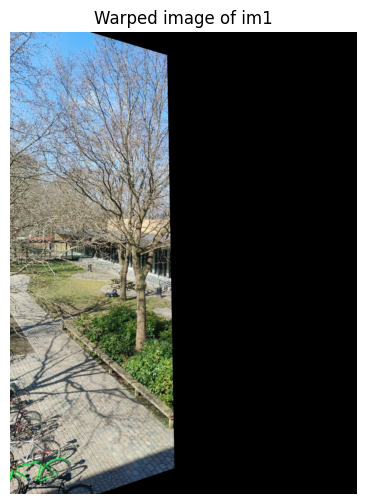

In [ ]:
# xRange and yRange are arbitrarily set for now
xRange = [0, im1.shape[1]]
yRange = [0, im1.shape[0]]

im1_warp, maskWarp = warpImage(im1, best_H, xRange, yRange)
plt.imshow(cv2.cvtColor(im1_warp, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("Warped image of im1")
plt.show()

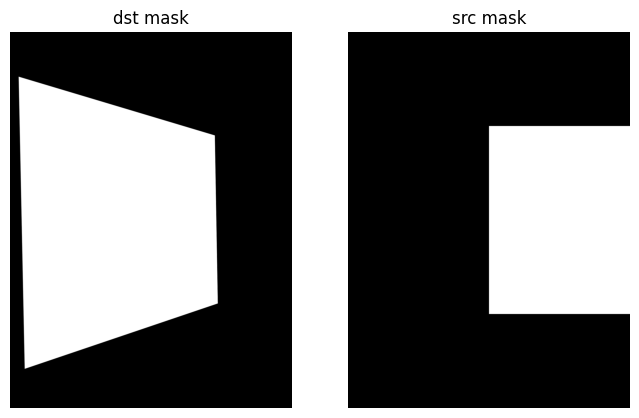

In [ ]:
# Modify ranges to not lose any pixels
xRange = [-im1.shape[1], im1.shape[1]]
yRange = [int(-0.5 * im1.shape[0]), int(1.5 * im1.shape[0])]

dst_warp_im, dst_warp = warpImage(im2, best_H, xRange, yRange)
src_warp_im, src_warp = warpImage(
    im1, np.eye(3), 2 * xRange, 2 * yRange
)  # reference

fig, ax = plt.subplots(1, 2)
ax[0].imshow(dst_warp, cmap="gray")
ax[0].set_title("dst mask")
ax[0].axis("off")
ax[1].imshow(src_warp, cmap="gray")
ax[1].set_title("src mask")
ax[1].axis("off")
plt.show()

xor = np.logical_xor(dst_warp, src_warp)
non_overlap = np.logical_and(xor, dst_warp)
fig, ax = plt.subplots(1, 2)
ax[0].imshow(xor, cmap="gray")
ax[0].set_title("xor")
ax[0].axis("off")
ax[1].imshow(non_overlap, cmap="gray")
ax[1].set_title("non_overlap")
ax[1].axis("off")
plt.show()

new_dst_img = dst_warp_im.copy()
new_dst_img[non_overlap != 1] = 0
plt.imshow(new_dst_img)
plt.show()

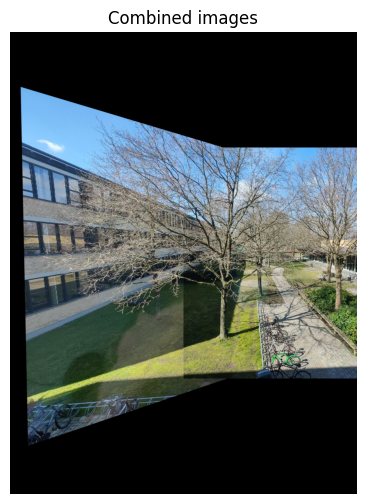

In [ ]:
# Combine the 2 images
combined = new_dst_img + src_warp_im
plt.imshow(cv2.cvtColor(combined, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("Combined images")
plt.show()

# Ex 11

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from cv02504.util_functions import Pi

In [ ]:
cv2.__version__

'4.9.0'

In [ ]:
folder = "media/Glyp/"
K = np.loadtxt(folder + "K.txt")
K

array([[3.1174740e+03, 0.0000000e+00, 1.5019408e+03],
       [0.0000000e+00, 3.1174740e+03, 9.8476840e+02],
       [0.0000000e+00, 0.0000000e+00, 1.0000000e+00]])

In [ ]:
im0 = cv2.imread(folder + "sequence/000001.png")
im1 = cv2.imread(folder + "sequence/000002.png")
im2 = cv2.imread(folder + "sequence/000003.png")

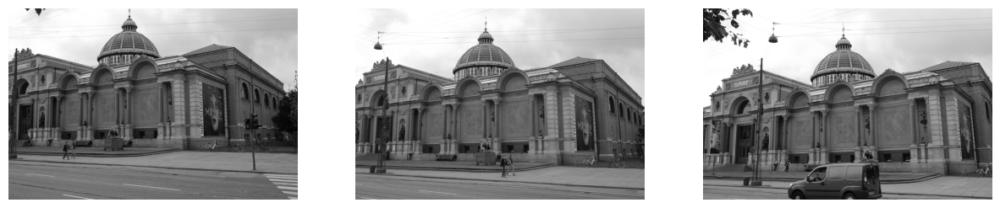

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(im0)
ax[0].axis("off")
ax[1].imshow(im1)
ax[1].axis("off")
ax[2].imshow(im2)
ax[2].axis("off")
plt.show()

1. Use SIFT to find keypoints in each image.
2. Use BFMatcher to match keypoints between image0 and image1, `matches01`
3. Use BFMatcher to match keypoints between image1 and image2, `matches12`

In [ ]:
# Ex 11.1
# Find and match SIFT keypoints

n_features = 2000  # limit for speed reasons
sift = cv2.SIFT_create(nfeatures=2000)
kp0, des0 = sift.detectAndCompute(im0, None)
kp1, des1 = sift.detectAndCompute(im1, None)
kp2, des2 = sift.detectAndCompute(im2, None)

# Convert to np arrays of 2D points
kp0 = np.array([k.pt for k in kp0])
kp1 = np.array([k.pt for k in kp1])
kp2 = np.array([k.pt for k in kp2])

bf = cv2.BFMatcher_create(crossCheck=True)
matches01 = bf.match(des0, des1)
matches12 = bf.match(des1, des2)

# Convert to np arrays of the indices
matches01 = np.array([(m.queryIdx, m.trainIdx) for m in matches01])
matches12 = np.array([(m.queryIdx, m.trainIdx) for m in matches12])

In [ ]:
print(matches01.shape)  # correct shape, checked with TA
print(matches12.shape)
matches01
# contains the indices of the matched keypoints in im0 and im1

(958, 2)
(860, 2)


array([[   0, 1593],
       [   4,  209],
       [   5,  365],
       ...,
       [1986, 1808],
       [1989, 1431],
       [1995,  103]])

The matches found using BFMatcher are corresponding points. 

1. `cv2.findEssentialMat()`: Use the corresponding points to estimate the essential matrix between camera0 and camera1, `E01`

2. `cv2.recoverPose()`: Use the estimated Essential matrices to get the camera extrinsic of cam1 wrt cam0

In the above processes, 2 masks are returned
- `cv2.findEssentialMat()` returns a mask to indicate matches are inliers
- `cv2.recoverPose()` returns a mask that contains matches that lie in front of both cameras

3. Combine the masks to get matches that are inliers and lie in front of both cameras. Matches of interest are now stored in `new_matches01`

In [ ]:
# Ex 11.2
# Estimate essential matrix, decompose, find pose, keep inliers only


E01_find, mask01_find = cv2.findEssentialMat(
    kp0[matches01[:, 0]],
    kp1[matches01[:, 1]],
    K,
)
# masks: indicates which matches are inliers

# Decompose E to get R, t
E01_rec, R1, t1, mask01_rec = cv2.recoverPose(
    E01_find, kp0[matches01[:, 0]], kp1[matches01[:, 1]], K
)
# masks: indicates which matches lie in front of cameras

# FIX: somehow, mask_rec returns array of [0] and [255]
mask01_rec = (mask01_rec / 255).astype(int)

# Combine masks: matches that are inliers and lie in front of cameras
combined_mask01 = np.logical_and(mask01_find, mask01_rec)

# Only keep matches that are inliers
new_matches01 = matches01[combined_mask01.ravel()]

In [ ]:
# Check shapes
print(f"mask01_find: {mask01_find.shape}")
print(f"mask01_rec: {mask01_rec.shape}")
print(f"combined_mask01: {combined_mask01.shape}")
print(f"new_matches01: {new_matches01.shape}\n")

print(f"No. of inliers: {mask01_find.sum()}")  # inliers have the value of 1
print(f"No. of inliers: {combined_mask01.sum()}")
print(f"No. of inliers: {new_matches01.shape[0]}\n")

mask01_find: (958, 1)
mask01_rec: (958, 1)
combined_mask01: (958, 1)
new_matches01: (673, 2)

No. of inliers: 675
No. of inliers: 673
No. of inliers: 673



In [ ]:
# Check raw values
print(f"R1: \n{R1}")
print(f"t1: \n{t1}\n")
print(f"new_matches01:\n {new_matches01}")
print(f"E01_find:\n{E01_find/E01_find[2,2]}")  # normalize by dividing by E[2,2]

R1: 
[[ 0.99986031 -0.00870514 -0.0142681 ]
 [ 0.00937649  0.99881855  0.04768206]
 [ 0.01383616 -0.04780919  0.99876065]]
t1: 
[[ 0.92508972]
 [-0.06815487]
 [-0.37358255]]

new_matches01:
 [[  13  203]
 [  14  402]
 [  20  180]
 ...
 [1973 1871]
 [1981 1889]
 [1982 1955]]
E01_find:
[[  0.0593423    8.72552833  -1.1650404 ]
 [ -8.95573144   1.10065729 -21.29487558]
 [  1.78079423  21.4059286    1.        ]]


Find matches that exist across all 3 images using `np.intersect1d()`
- This results in `points0[i]`, `points1[i]`, and `points2[i]` are the 2D locations of the same point in the corresponding images

In [ ]:
# Ex 11.3
# Find subset of matches that are present from image0->image2
_, idx01, idx12 = np.intersect1d(
    new_matches01[:, 1], matches12[:, 0], return_indices=True
)
# idx01 (np.array): contains indices of intersection in matches01
# idx12 (np.array): contains indices of intersection in matches12

# Lists contain 2D locations of the same point across images
points0 = kp0[new_matches01[idx01, 0]]
points1 = kp1[new_matches01[idx01, 1]]
points2 = kp2[matches12[idx12, 1]]

print(points0.shape, points1.shape, points2.shape)  # should be equal shape

(355, 2) (355, 2) (355, 2)


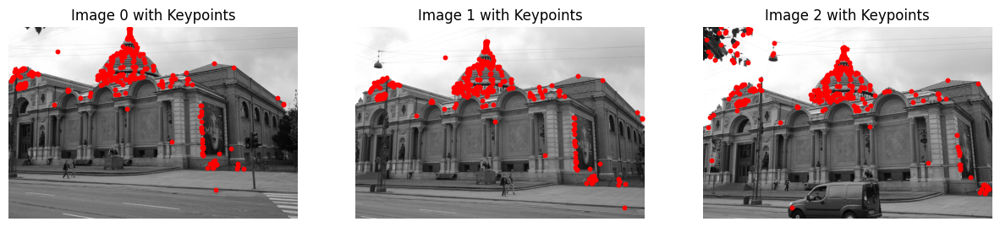

In [ ]:
# Plot the matches

# Plot the keypoints on images 0, 1, and 2
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot image 0 with keypoints
axes[0].imshow(cv2.cvtColor(im0, cv2.COLOR_BGR2RGB))
axes[0].scatter(points0[:, 0], points0[:, 1], c="r", s=10)
axes[0].set_title("Image 0 with Keypoints")
axes[0].axis("off")

# Plot image 1 with keypoints
axes[1].imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB))
axes[1].scatter(points1[:, 0], points1[:, 1], c="r", s=10)
axes[1].set_title("Image 1 with Keypoints")
axes[1].axis("off")

# Plot image 2 with keypoints
axes[2].imshow(cv2.cvtColor(im2, cv2.COLOR_BGR2RGB))
axes[2].scatter(points2[:, 0], points2[:, 1], c="r", s=10)
axes[2].set_title("Image 2 with Keypoints")
axes[2].axis("off")

plt.show()

In [ ]:
# Ex 11.4
# Use the 2D positions in image 0 and 1 to triangulate the points in 3D (Q)

# Set camera 1 as the origin
P1 = K @ np.hstack((np.eye(3), np.zeros((3, 1))))
P2 = K @ np.hstack((R1, t1))

Q4d = cv2.triangulatePoints(P1, P2, points0.T, points1.T)
Q3d = Pi(Q4d)
print(f"Q3d shape: {Q3d.shape}")

# Using the 2D positions in image 2, estimate the pose of image 2 with RANSAC.
distCoeffs = np.zeros(5)
success, rvec, tvec, inliers = cv2.solvePnPRansac(Q3d.T, points2, K, distCoeffs)

if not success:
    print("Pose estimation failed.")

print("Rotation Vector:\n", rvec)
print("Translation Vector:\n", tvec)
print("Inliers shape: \n", inliers.shape)

Q3d shape: (3, 355)
Rotation Vector:
 [[-0.08105783]
 [-0.02754738]
 [ 0.00158644]]
Translation Vector:
 [[ 1.97424512]
 [-0.25282702]
 [-1.04733511]]
Inliers shape: 
 (271, 1)


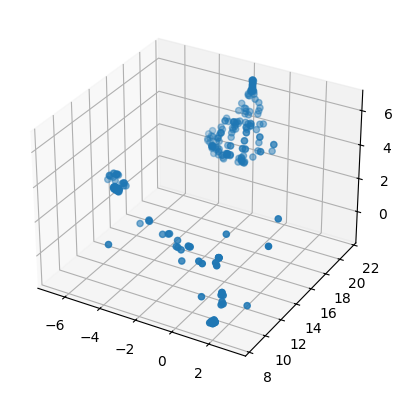

In [ ]:
# Visualize 3D points
figure = plt.figure()
ax = figure.add_subplot(projection="3d")
points_show = (Q3d.T[inliers.flatten()]).T
points_show[[1, 2], :] = points_show[[2, 1], :]
points_show[2, :] *= -1
ax.scatter(*(points_show))
plt.show()

# Ex 13

In [ ]:
import numpy as np
import open3d as o3d
import cv2
import matplotlib.pyplot as plt

In [ ]:
folder = "media/casper/"
c = np.load(folder + "calib.npy", allow_pickle=True).item()
c

{'K0': array([[1.09058826e+03, 0.00000000e+00, 4.22000000e+02],
        [0.00000000e+00, 1.09058826e+03, 3.38000000e+02],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]),
 'd0': array([-0.03720395, -0.2353958 ,  0.        ,  0.        ,  0.        ]),
 'K1': array([[1.09454675e+03, 0.00000000e+00, 4.22000000e+02],
        [0.00000000e+00, 1.09454675e+03, 3.38000000e+02],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]]),
 'd1': array([-0.04744541, -0.00026868,  0.        ,  0.        ,  0.        ]),
 'R': array([[ 0.91398722, -0.07814026,  0.39814758],
        [ 0.07619891,  0.99687725,  0.02072451],
        [-0.39852369,  0.01139647,  0.91708726]]),
 't': array([[-407.240143 ],
        [  -1.5053668],
        [  85.688652 ]])}

Purpose of images at each index explained
- 0 is an image fully illuminated by the projector (projector showing a white image)
- 1 is an image with the projector fully off
- 2-17 are the 16 images in the primary pattern shifting. This pattern has 40 periods.
- 18-25 are the 8 images of the secondary pattern shifting. This pattern has 41 periods

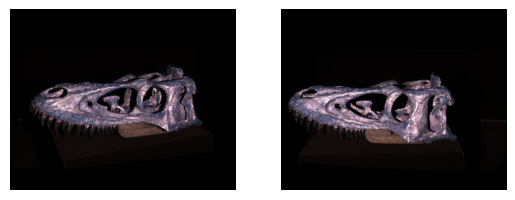

In [ ]:
im0 = cv2.imread(folder + "sequence/frames0_0.png")
im1 = cv2.imread(folder + "sequence/frames1_0.png")

# Before rectification
fig, ax = plt.subplots(1, 2)
ax[0].imshow(im0)
ax[0].axis("off")
ax[1].imshow(im1)
ax[1].axis("off")
plt.show()

In [ ]:
# Ex 13.2
## Initialize maps for rectification
im0 = cv2.imread(folder + "sequence/frames0_0.png")
size = (im0.shape[1], im0.shape[0])
stereo = cv2.stereoRectify(
    c["K0"], c["d0"], c["K1"], c["d1"], size, c["R"], c["t"], flags=0
)

R0, R1, P0, P1 = stereo[:4]
maps0 = cv2.initUndistortRectifyMap(
    c["K0"], c["d0"], R0, P0, size, cv2.CV_32FC2
)
maps1 = cv2.initUndistortRectifyMap(
    c["K1"], c["d1"], R1, P1, size, cv2.CV_32FC2
)

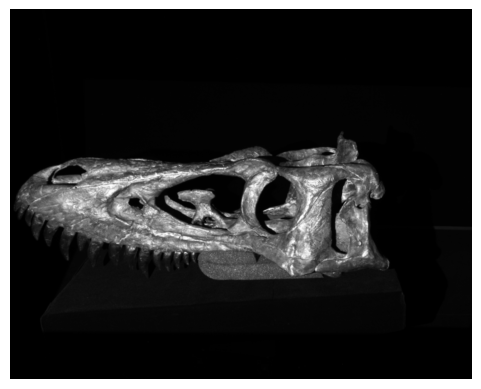

In [ ]:
## Do a sample rectification on 1 image
im1 = cv2.imread(folder + "sequence/frames1_0.png").astype(float).mean(2) / 255
b = cv2.remap(im1, *maps1, cv2.INTER_LINEAR)
plt.imshow(b, cmap="gray")
plt.axis("off")
plt.show()

In [ ]:
# Rectify all images
n_frames = 26
imgs0_rect = np.zeros((n_frames, size[1], size[0]))
imgs1_rect = np.zeros((n_frames, size[1], size[0]))
for i in range(n_frames):
    # Load and convert to grayscale
    img0 = (
        cv2.imread(folder + "sequence/frames0_%d.png" % i).astype(float).mean(2)
        / 255
    )
    img1 = (
        cv2.imread(folder + "sequence/frames1_%d.png" % i).astype(float).mean(2)
        / 255
    )
    imgs0_rect[i] = cv2.remap(img0, *maps0, cv2.INTER_LINEAR)
    imgs1_rect[i] = cv2.remap(img1, *maps1, cv2.INTER_LINEAR)

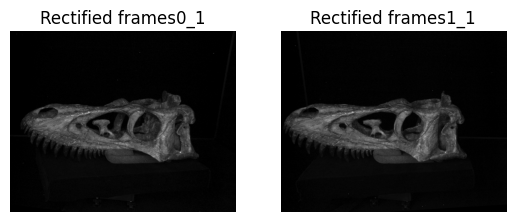

In [ ]:
plt.subplot(1, 2, 1)
plt.imshow(imgs0_rect[1], cmap="gray")
plt.title("Rectified frames0_1")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(imgs1_rect[1], cmap="gray")
plt.title("Rectified frames1_1")
plt.axis("off")
plt.show()

In [ ]:
# Ex 13.3
def unwrap(imgs, n1):
    """
    Unwrap the measured phases. Adapter from Collister.

    Args:
        imgs (List[np.ndarray]): List of images from the cameras.
        n1 (int): Period of the primary pattern.

    Returns:
        theta_est (np.ndarray) : The phase of the primary pattern.
    """
    # Primary pattern
    primary_images = imgs[2:18]  # 16 images
    fft_primary = np.fft.rfft(primary_images, axis=0)
    fourier_primary = fft_primary[1]
    theta_primary = np.angle(fourier_primary)

    # Secondary pattern
    secondary_images = imgs[18:26]
    fft_secondary = np.fft.rfft(secondary_images, axis=0)
    fourier_secondary = fft_secondary[1]
    theta_secondary = np.angle(fourier_secondary)

    # Compute phase cue using heterodyne principle
    theta_c = np.mod(theta_secondary - theta_primary, 2 * np.pi)

    # Order of primary phase
    o_primary = np.rint((n1 * theta_c - theta_primary) / (2 * np.pi))

    # Estimate the phase
    theta_est = np.mod((2 * np.pi * o_primary + theta_primary) / n1, 2 * np.pi)
    return theta_est

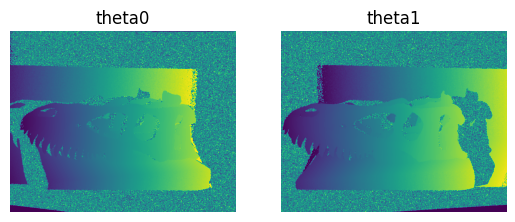

In [ ]:
theta0 = unwrap(imgs0_rect, 40)
theta1 = unwrap(imgs1_rect, 40)

plt.subplot(1, 2, 1)
plt.imshow(theta0)
plt.title("theta0")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(theta1)
plt.title("theta1")
plt.axis("off")
plt.show()

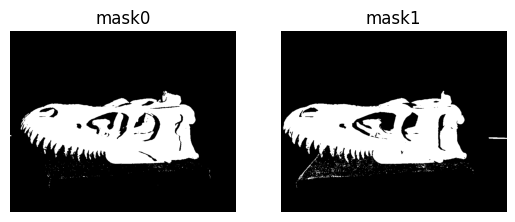

In [ ]:
# Ex 13.4
# Introduce binary mask that contains areas sufficiently illuminated
light0 = imgs0_rect[0] - imgs0_rect[1]  # fully on - full off
light1 = imgs1_rect[0] - imgs1_rect[1]

# Divide threshold by 255 as the pixels are normalised [0,1]
threshold = 15 / 255

# Apply a threshold to obtain a mask for EACH CAMERA
mask0 = (light0 > threshold).astype(np.uint8)
mask1 = (light1 > threshold).astype(np.uint8)

plt.subplot(1, 2, 1)
plt.imshow(mask0, cmap="gray")
plt.title("mask0")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(mask1, cmap="gray")
plt.title("mask1")
plt.axis("off")
plt.show()

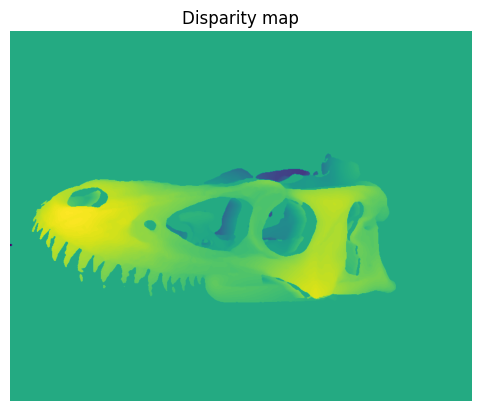

In [ ]:
# Ex 13.5
# Find matches between the 2 cameras
shape = mask0.shape
shape1 = mask1.shape
q0s = []
q1s = []
disparity = np.zeros_like(mask0, dtype=np.float32)  # Initialize with zeros

# Iterate over all pixels in camera 0
for i0 in range(shape[0]):
    point0 = (0, 0)
    point1 = (0, 0)
    for j0 in range(shape[1]):
        minDiff = 1000000
        if mask0[i0, j0]:  # valid pixel
            phase = theta0[i0][j0]
            epipolar_row = theta1[i0]  # row i0 in camera 1
            valid_epipolar_row = epipolar_row * mask1[i0]

            # closest phase match
            j1 = (np.abs(valid_epipolar_row - phase)).argmin()
            q0s.append([j0, i0])
            q1s.append([j1, i0])
            disparity[i0][j0] = j0 - j1

plt.imshow(cv2.medianBlur(disparity.astype(np.float32), 5))
plt.title("Disparity map")
plt.axis("off")
plt.show()

In [ ]:
# Ex 13.6
# Triangulate the 3D points
projPoints0 = np.array(q0s).T.astype(np.float32)
projPoints1 = np.array(q1s).T.astype(np.float32)

Q = cv2.triangulatePoints(
    projMatr1=P0, projMatr2=P1, projPoints1=projPoints0, projPoints2=projPoints1
)
Q = Q[:-1] / Q[-1]  # convert to non-homogenous

# Remove negative z-coordinates that are behind the camera
Q_mask = np.where(Q[2] > 0, True, False)
Q_fixed = (Q.T[Q_mask]).T

# Visualize 3D point cloud
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(Q_fixed.T)
o3d.visualization.draw_geometries([pcd])

Screenshots from the Open3D window

<img src="media/open3d_plot1.png" height="300">
<img src="media/open3d_plot2.png" height="300">